In [1]:
%matplotlib widget
import torch 
import os
os.environ['TORCH_CUDA_ARCH_LIST'] = f'{torch.cuda.get_device_properties(0).major}.{torch.cuda.get_device_properties(0).minor}'

from diffSPH.v2.parameters import parseDefaultParameters, parseModuleParameters
from diffSPH.v2.sampling import sampleParticles
from diffSPH.v2.util import countUniqueEntries, printState
from diffSPH.v2.plotting import updatePlot, visualizeParticles, prepVisualizationState

from diffSPH.v2.modules.integration import integrate
from diffSPH.v2.modules.neighborhood import neighborSearch
from diffSPH.v2.modules.shifting import solveShifting
from diffSPH.v2.modules.timestep import computeTimestep

from diffSPH.v2.simulationSchemes.deltaPlus import simulationStep    
from diffSPH.v2.modules.viscosity import computeViscosityParameter, setViscosityParameters
from tqdm.autonotebook import tqdm
import matplotlib.pyplot as plt
import numpy as np
import torch
import copy
import os
import datetime
from diffSPH.v2.util import computeStatistics
import tomli

In [2]:
import scipy.sparse as sp
import scipy
import numpy as np

In [3]:
configurationFile = './configurations/01_tgv.toml'

with open(configurationFile, 'r') as f:
    config = f.read()

config = tomli.loads(config)

In [4]:
nx = 128
L = 1
u_mag = 2
k = 1 * np.pi
TGV_override = False
targetRe = 2000

config['domain']['minExtent'] = -L
config['domain']['maxExtent'] =  L
config['simulation'] = {'correctArea': True}

config['particle'] = {'nx' : nx}
config['fluid'] = {'cs' : u_mag * 10}
config['compute'] = {'device': 'cuda'}
config['plot']['export'] = True
config['kernel'] = {'name': 'Wendland2'}
# config['kernel']['targetNeighbors'] = 100
# config['compute'] = {'device': 'cpu'}

config = parseDefaultParameters(config)
config = parseModuleParameters(config)
setViscosityParameters(config, targetRe, L, u_mag)
config['integration']['scheme'] = 'symplecticEuler'
config['integration']['scheme'] = 'semiImplicitEuler'

# print(config['kernel'])

print(rf'Re = {config["diffusion"]["Re"]}, $\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$, $\alpha = {config["diffusion"]["alpha"]}$')


Re = 2000.0, $\nu_{sph} = 0.002$, $\alpha = 0.010802216045267035$


In [5]:
config['kernel']

{'name': 'Wendland2',
 'targetNeighbors': tensor(45.2390, device='cuda:0'),
 'function': <diffSPH.kernels.KernelWrapper at 0x77f7dedf7590>,
 'kernelScale': tensor(1.8959, device='cuda:0')}

In [6]:

from torch.profiler import profile, record_function, ProfilerActivity
from diffSPH.v2.modules.inletOutlet import processInlet, processOutlet, processForcing
from diffSPH.v2.plotting import plotRegions
from diffSPH.v2.sdf import getSDF, sdfFunctions, operatorDict
from diffSPH.v2.sampling import find_contour

ngrid = 255
x = torch.linspace(config['domain']['minExtent'][0], config['domain']['maxExtent'][0], ngrid, dtype = torch.float32)
y = torch.linspace(config['domain']['minExtent'][1], config['domain']['maxExtent'][1], ngrid, dtype = torch.float32)
X, Y = torch.meshgrid(x, y, indexing = 'ij')
P = torch.stack([X,Y], dim=-1)
points = P.reshape(-1,2)


sphere_b = lambda points: getSDF('box')['function'](points, torch.tensor([1/8,1/2]).to(points.device))
inletSDF = operatorDict['translate'](sphere_b, torch.tensor([-2 + 1/8,0.]))
# fx = sdf(torch.clone(points)).to('cpu').reshape(ngrid,ngrid)


sphere_b = lambda points: getSDF('box')['function'](points, torch.tensor([1/8,1]).to(points.device))
outletSDF = operatorDict['translate'](sphere_b, torch.tensor([2 - 1/8,0.]))
# fx = sdf(torch.clone(points)).to('cpu').reshape(ngrid,ngrid)

sphere_b = lambda points: getSDF('box')['function'](points, torch.tensor([1/4,1.5]).to(points.device))
outletRegion = operatorDict['translate'](sphere_b, torch.tensor([2 - 1/4,0.]))
# fx = sdf(torch.clone(points)).to('cpu').reshape(ngrid,ngrid)

inner = lambda points: getSDF('box')['function'](points, torch.tensor([1,1]).to(points.device))
outer = lambda points: getSDF('box')['function'](points, torch.tensor([1 + config['particle']['dx'] * boundary_width,1 + config['particle']['dx'] * boundary_width]).to(points.device))
outer = operatorDict['invert'](outer)
sdf = operatorDict['union'](inner, outer)
boundary_sdf = operatorDict['invert'](inner)


fluid_sdf = lambda points: getSDF('box')['function'](points, torch.tensor([1,1]).to(points.device))
# fluid_sdf = operatorDict['translate'](sphere_b, torch.tensor([-2 + 1/2, - 1/2]))


regions = [
{
        'sdf': fluid_sdf,
        'type': 'fluid',
        'velocity': torch.tensor([0.,0.]),
        # 'particles': sampleParticles(config, sdfs = [fluid_sdf])[0],
        'contour': find_contour(fluid_sdf(points).reshape(ngrid, ngrid).cpu(), config['domain']['minExtent'].cpu(), config['domain']['maxExtent'].cpu(), ngrid, 0)
    }
    ]

config['regions'] = regions


In [7]:
from diffSPH.v2.sampling import sampleNoisyParticles
from diffSPH.v2.modules.divergence import computeDivergence
from diffSPH.v2.plotting import plotSDF
from diffSPH.v2.sdf import getSDF, operatorDict

# particleState, mask = sampleParticles(config, sdfs = [])
particleState, mask = sampleNoisyParticles(config['noise'], config, sdfs = regions, randomizeParticles = False)

priorState = None
# particleState['velocities'][:,0] =  u_mag * torch.cos(k * particleState['positions'][:,0]) * torch.sin(k * particleState['positions'][:,1])
# particleState['velocities'][:,1] = -u_mag * torch.sin(k * particleState['positions'][:,0]) * torch.cos(k * particleState['positions'][:,1])

# u_max = torch.linalg.norm(particleState['velocities'], dim = 1).max()
# particleState['velocities'] = particleState['velocities'] / (u_max + 1e-7) * u_mag
Ek0 = 0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(particleState['velocities'], dim = -1)**2

initialVelocities = particleState['velocities'].clone()

particleState['Eks'] =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2)
particleState['E_k'] = particleState['Eks'].sum().cpu().detach().item()



In [8]:
from diffSPH.v2.simulationSchemes.dfsph import simulationStep
from diffSPH.v2.modules.momentumEquation import computeMomentumEquation
from diffSPH.v2.modules.neighborhood import searchNeighbors
from diffSPH.v2.simulationSchemes.dfsph import callModule, computeDensity, computeGravity, computeViscosity, sphOperationStates, scatter_sum
from diffSPH.v2.modules.incompressible import computeDivergence, projectVelocities, computePressureAcceleration, solveIncompressible_relaxedJacobi, simulationStep
from diffSPH.v2.plotting import prepVisualizationState, visualizeParticleQuantity
from diffSPH.v2.plotting import exportPlot, postProcessPlot


from diffSPH.v2.sampling import generateInitialConditions

# initialState = generateInitialConditions(particleState, config)
initialState = {
    'fluid': particleState,
    'time': 0.0,
    'timestep': 0,
    'dt': torch.tensor(5e-4, device = config['compute']['device']),
}

# initialState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * initialState['fluid']['positions'][:,0]) * torch.sin(k * initialState['fluid']['positions'][:,1])
# initialState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * initialState['fluid']['positions'][:,0]) * torch.cos(k * initialState['fluid']['positions'][:,1])


# perennialState = copy.deepcopy(initialState)
config['dfsph']['maxIters'] = 512
config['dfsph']['errorThreshold'] = 5e-4
config['dfsph']['omega'] = 0.33

config['timestep']['dt'] = 1e-3
# perennialState['dt'] = 1e-3

# priorState = None
# perennialState, priorState, *updates = integrate(simulationStep, perennialState, config, previousStep= priorState)
# perennialState['time'] += perennialState['dt']

# searchNeighbors(perennialState, config)
# div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)

In [9]:
solverState = copy.deepcopy(initialState)

# solverState['fluid']['positions'] += 1e-2 * torch.randn_like(solverState['fluid']['positions'])

# solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
# solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])

searchNeighbors(solverState, config)

solverState['fluid']['densities'], _ =  callModule(solverState, computeDensity, config, 'fluid')

In [10]:
from diffSPH.v2.modules.shifting import deltaPlusShifting, evalKernel, computeLambdaGrad, BiCG, BiCGStab, LinearCG
from diffSPH.v2.modules.normalizationMatrices import computeNormalizationMatrices
from diffSPH.v2.modules.surfaceDetection import detectFreeSurfaceBarecasco, computeNormalsMaronne, detectFreeSurfaceMaronne, expandFreeSurfaceMask, computeColorField, computeColorFieldGradient, detectFreeSurfaceColorFieldGradient
# from diffSPH.v2.modules.shifting import computeLambdaGrad, deltaPlusShifting, computeShifting, BiCGStab_wJacobi, BiCG, LinearCG, BiCGStab


In [214]:
@torch.jit.script
def idmat(shape:int, device: torch.device = torch.device('cpu'), dtype: torch.dtype = torch.float32):
    M_precond = torch.ones(shape, device=device, dtype=dtype)
    M_i = torch.arange(shape).to(M_precond.device).to(torch.int64)
    M_j = torch.arange(shape).to(M_precond.device).to(torch.int64)

    return (M_precond, (M_i, M_j), shape)

def getShiftingMatrices(particleState, config, computeRho):
    with record_function("[Shifting] - Implicit Particle Shifting (IPS)"):
        numParticles = particleState['numParticles']

        if config['shifting']['freeSurface']:  
            if config['shifting']['useExtendedMask']:
                fs = particleState['freeSurfaceMask']
            else:
                fs = particleState['freeSurface']
            fsm = particleState['freeSurfaceMask']

        # particleState['fluidNeighborhood'] = fluidNeighborSearch(particleState, config)
        (i,j) = particleState['neighborhood']['indices']
        rij = particleState['neighborhood']['distances']
        xij = particleState['neighborhood']['vectors']
        hij = particleState['neighborhood']['supports']
        k = config['kernel']['function']
        dim = config['domain']['dim']

        K, J, H = evalKernel(rij, xij, hij, k, dim)
        if computeRho:
            particleState['densities'] = sphOperationStates(particleState, particleState, None, operation = 'density', neighborhood=particleState['neighborhood'])
            omega =  particleState['masses'] / particleState['densities']
        else:
            omega = particleState['areas']
        
        
        J = scatter_sum(J * omega[j,None], i, dim = 0, dim_size = numParticles)
        H = H * omega[j,None,None]

        h2 = particleState['supports'].repeat(2,1).T.flatten()
        h2 = config['particle']['dx']
        x0 = torch.rand(numParticles * 2).to(rij.device).type(rij.dtype) * h2 / 4 - h2 / 8
        if config['shifting']['initialization'] == 'deltaPlus':
            x0 = -deltaPlusShifting(particleState, config).flatten() * 0.5
        if config['shifting']['initialization'] == 'deltaMinus':
            x0 = deltaPlusShifting(particleState, config).flatten() * 0.5
        if config['shifting']['initialization'] == 'zero':
            x0 = torch.zeros_like(x0)
        

        B = torch.zeros(numParticles * 2, dtype = torch.float32, device=rij.device)

        # iActual = i
        # jActual = j
        activeMask = torch.ones_like(i, dtype = torch.bool)
        if config['shifting']['freeSurface']:

            J2 = torch.zeros(J.shape[0], 2, dtype = torch.float32, device=rij.device)
            J2[fs < 0.5, :] = J[fs < 0.5, :]

            B[::2] = J2[:,0]
            B[1::2] = J2[:,1]

            x0 = x0.view(-1,2)
            x0[fs > 0.5,0] = 0
            x0[fs > 0.5,1] = 0
            x0 = x0.flatten()
            H[fs[i] > 0.5,:,:] = 0
            # H[fs[j] > 0.5,:,:] = 0
            activeMask = fs[i] < 0.5
            # iActual = i[fs[i] < 0.5]
            # jActual = j[fs[i] < 0.5]

            # print(f'Iter: {iters}, Residual: {residual}, fs: xk fs: {update[fs > 0.5]}')
            # if scheme == 'BiCG':
            #     xk = BiCG(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
            # elif scheme == 'BiCGStab':
            #     xk = BiCGStab(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
            # elif scheme == 'BiCGStab_wJacobi':
            #     xk = BiCGStab_wJacobi(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
            # else:
            #     xk = LinearCG(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
        else:
            B[::2] = J[:,0]
            B[1::2] = J[:,1]

        # if torch.any(particleState['boundaryMarker'] > 0):
        #     # J[particleState['boundaryMarker'] > 0, :] = 0
        #     B.view(-1,2)[particleState['boundaryMarker'] > 0, 0] = 0
        #     H[particleState['boundaryMarker'][i] > 0, :, :] = 0
        #     x0.view(-1,2)[particleState['boundaryMarker'] > 0, 0] = 0
        #     if config['shifting']['freeSurface']:
        #         activeMask = torch.logical_and(particleState['boundaryMarker'][i] == 0, fs[i] < 0.5)
        #     else:
        #         activeMask = particleState['boundaryMarker'][i] == 0

    return H, B, x0, i, j, activeMask, J

def multiplySparseShifting(H, x, i, j):
    numParticles = x.shape[0] // 2

    apk = torch.zeros_like(x)
    apk[::2]  += scatter_sum(H[:,0,0] * x[j * 2], i, dim=0, dim_size=numParticles)
    apk[::2]  += scatter_sum(H[:,0,1] * x[j * 2 + 1], i, dim=0, dim_size=numParticles)

    apk[1::2] += scatter_sum(H[:,1,0] * x[j * 2], i, dim=0, dim_size=numParticles)
    apk[1::2] += scatter_sum(H[:,1,1] * x[j * 2 + 1], i, dim=0, dim_size=numParticles)

    return apk

from diffSPH.v2.sparse import matvec_sparse_coo, make_id, _get_tensor_eps, _get_atol_rtol
from typing import Tuple, Optional, Callable
def bicgstabfn(A_fn: Callable, shape: int, b, x0:Optional[torch.Tensor]=None, tol:float = 1e-5, rtol:float=1e-5, atol:float=0., maxiter:Optional[int]=None, M:Optional[ Tuple[torch.Tensor, Tuple[torch.Tensor, torch.Tensor], int]]=None):
    print(f'BiCGStab Solver')
    
    if M is None:
        print(f'No preconditioner')
        M = idmat(shape, device=b.device, dtype=b.dtype)
    x = x0.clone() if x0 is not None else torch.zeros_like(b)

    bnrm2 = torch.linalg.norm(b)
    print(f'Initial Residual: {bnrm2}, Threshold {tol}')
    atol, _ = _get_atol_rtol('bicgstab', bnrm2, atol, rtol)
    print(f'atol: {atol} [{rtol}]')
    convergence = []

    if bnrm2 == 0:
        print(f'Initial Residual is zero')
        return b, 0, convergence

    n = len(b)

    dotprod = torch.dot

    if maxiter is None:
        print(f'No max iterations setting to {n*10}')
        maxiter = n*10

    # matvec = A.matvec
    # psolve = M.matvec

    # These values make no sense but coming from original Fortran code
    # sqrt might have been meant instead.
    rhotol = _get_tensor_eps(x)**2
    omegatol = rhotol
    print(f'rhotol: {rhotol} | omegatol: {omegatol}')

    # Dummy values to initialize vars, silence linter warnings
    rho_prev = torch.zeros_like(b)
    omega = 0.
    alpha = 0.
    p = torch.zeros_like(b)
    v = torch.zeros_like(b)
    # rho_prev, omega, alpha, p, v = None, None, None, None, None

    r = b -  A_fn(x) if x.any() else b.clone()
    rtilde = r.clone()
    print(f'Initial Residual: {torch.linalg.norm(r)}')

    for iteration in range(maxiter):
        if torch.linalg.norm(r) < atol:  # Are we done?
            print(f'Converged after {iteration} iterations {torch.linalg.norm(r)} | {atol}')
            return x, iteration, convergence

        rho = dotprod(rtilde, r)
        if torch.abs(rho) < rhotol:  # rho breakdown
            print(f'\t[{iteration:3d}]\trho breakdown {rho} | {rhotol}')
            return x, -10, convergence

        if iteration > 0:
            if torch.abs(omega) < omegatol:  # omega breakdown
                print(f'\t[{iteration:3d}]\tomega breakdown {omega} | {omegatol}')
                return x, -11, convergence

            beta = (rho / rho_prev) * (alpha / omega)
            p -= omega*v
            p *= beta
            p += r
        else:  # First spin
            s = torch.empty_like(r)
            p = r.clone()

        phat = matvec_sparse_coo(M, p)
        v = A_fn(phat)
        # print(v)
        rv = dotprod(rtilde, v)
        if rv == 0:
            print(f'\t[{iteration:3d}]\trv breakdown {rv} | {torch.linalg.norm(rtilde)} | {torch.linalg.norm(v)} | {torch.linalg.norm(phat)}')
            return x, -11, convergence
        alpha = rho / rv
        r -= alpha*v
        s[:] = r[:]

        if torch.linalg.norm(s) < atol:
            print(f'\t[{iteration:3d}]\tConverged after {iteration} iterations {torch.linalg.norm(s)} | {atol}')
            x += alpha*phat
            return x, 0, convergence

        shat = matvec_sparse_coo(M, s)
        t = A_fn(shat)
        omega = dotprod(t, s) / dotprod(t, t)
        x += alpha*phat
        x += omega*shat
        r -= omega*t
        rho_prev = rho

        print(f'\t[{iteration:3d}]\tResidual: {torch.linalg.norm(r)} | rho: {torch.abs(rho)} | alpha: {torch.linalg.norm(alpha)} | omega: {torch.linalg.norm(omega)}')

        # print(omega, alpha)
        convergence.append(torch.linalg.norm(A_fn(x) - b))

    # else:  # for loop exhausted
        # Return incomplete progress
    print(f'Reached maximum iterations {maxiter}, returning with {torch.linalg.norm(r)}')
    return x, maxiter, convergence

def bicgstab(A,  b, x0:Optional[torch.Tensor]=None, tol:float = 1e-5, rtol:float=1e-5, atol:float=0., maxiter:Optional[int]=None, M:Optional[ Tuple[torch.Tensor, Tuple[torch.Tensor, torch.Tensor], int]]=None):
    print(f'BiCGStab Solver')
    
    if M is None:
        print(f'No preconditioner')
        M = make_id(A)#(shape, device=b.device, dtype=b.dtype)
    x = x0.clone() if x0 is not None else torch.zeros_like(b)

    bnrm2 = torch.linalg.norm(b)
    print(f'Initial Residual: {bnrm2}, Threshold {tol}')
    atol, _ = _get_atol_rtol('bicgstab', bnrm2, atol, rtol)
    print(f'atol: {atol} [{rtol}]')
    convergence = []

    if bnrm2 == 0:
        print(f'Initial Residual is zero')
        return b, 0, convergence

    n = len(b)

    dotprod = torch.dot

    if maxiter is None:
        print(f'No max iterations setting to {n*10}')
        maxiter = n*10

    # matvec = A.matvec
    # psolve = M.matvec

    # These values make no sense but coming from original Fortran code
    # sqrt might have been meant instead.
    rhotol = _get_tensor_eps(x)**2
    omegatol = rhotol
    print(f'rhotol: {rhotol} | omegatol: {omegatol}')

    # Dummy values to initialize vars, silence linter warnings
    rho_prev = torch.zeros_like(b)
    omega = 0.
    alpha = 0.
    pk = torch.zeros_like(b)
    apk = torch.zeros_like(b)
    # rho_prev, omega, alpha, p, v = None, None, None, None, None

    H, (i,j), numParticles = A

    xk = x

    rk = torch.zeros_like(b)
    rk[::2]  = rk[::2] + scatter_sum(H[:,0,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
    rk[::2]  = rk[::2] + scatter_sum(H[:,0,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)

    rk[1::2] = rk[1::2] + scatter_sum(H[:,1,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
    rk[1::2] = rk[1::2] + scatter_sum(H[:,1,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)


    rk = b -  rk if x.any() else b.clone()
    # rk = r.clone()
    r0 = rk.clone()
    pk = rk.clone()
    print(f'Initial Residual: {torch.linalg.norm(r0)}')

    for iteration in range(maxiter):
        if torch.linalg.norm(rk) < atol:  # Are we done?
            print(f'Converged after {iteration} iterations {torch.linalg.norm(rk)} | {atol}')
            return x, iteration, convergence, r0

        rho = dotprod(rk, r0)
        if torch.abs(rho) < rhotol:  # rho breakdown
            print(f'\t[{iteration:3d}]\trho breakdown {rho} | {rhotol}')
            return x, -10, convergence, r0


        phat = matvec_sparse_coo(M, pk)
        apk = torch.zeros_like(x0)
        apk[::2]  = apk[::2] + scatter_sum(H[:,0,0] * phat[j * 2], i, dim=0, dim_size=numParticles)
        apk[::2]  = apk[::2] + scatter_sum(H[:,0,1] * phat[j * 2 + 1], i, dim=0, dim_size=numParticles)

        apk[1::2] = apk[1::2] + scatter_sum(H[:,1,0] * phat[j * 2], i, dim=0, dim_size=numParticles)
        apk[1::2] = apk[1::2] + scatter_sum(H[:,1,1] * phat[j * 2 + 1], i, dim=0, dim_size=numParticles)
                
        
        # print(v)
        rv = dotprod(apk, r0)
        if rv == 0:
            print(f'\t[{iteration:3d}]\trv breakdown {rv} | {torch.linalg.norm(apk)} | {torch.linalg.norm(apk)} | {torch.linalg.norm(pk)}')
            return x, -11, convergence, r0
        alpha = rho / rv
        sk = rk - alpha*apk
        # sk[:] = r[:]

        if torch.linalg.norm(sk) < atol:
            print(f'\t[{iteration:3d}]\tConverged after {iteration} iterations {torch.linalg.norm(sk)} | {atol}')
            x += alpha*pk
            return x, 0, convergence, r0

        shat = matvec_sparse_coo(M, sk)
        ask = torch.ones_like(x0)
        ask[::2]  = ask[::2] + scatter_sum(H[:,0,0] * shat[j * 2], i, dim=0, dim_size=numParticles)
        ask[::2]  = ask[::2] + scatter_sum(H[:,0,1] * shat[j * 2 + 1], i, dim=0, dim_size=numParticles)

        ask[1::2] = ask[1::2] + scatter_sum(H[:,1,0] * shat[j * 2], i, dim=0, dim_size=numParticles)
        ask[1::2] = ask[1::2] + scatter_sum(H[:,1,1] * shat[j * 2 + 1], i, dim=0, dim_size=numParticles)

        print(f'{torch.linalg.norm(pk)} -> {torch.linalg.norm(apk)} | {torch.linalg.norm(sk)} -> {torch.linalg.norm(ask)} | {torch.linalg.norm(xk)} | {torch.linalg.norm(rk)}')

        # t = A_fn(shat)
        omega = dotprod(ask, sk) / dotprod(ask, ask)
        xk = xk + alpha * phat + omega * shat
        rk = sk - omega * ask

        beta = (torch.dot(rk, r0) / torch.dot(r0, r0)) * (alpha / omega)
        pk = rk + beta * (pk - omega * apk)


        print(f'\t=>\t{torch.linalg.norm(pk)} | {torch.linalg.norm(sk)} | {torch.linalg.norm(xk)} | {torch.linalg.norm(rk)}')

        rho_prev = rho

        if iteration > 0:
            if torch.abs(omega) < omegatol:  # omega breakdown
                print(f'\t[{iteration:3d}]\tomega breakdown {omega} | {omegatol}')
                return x, -11, convergence, r0

            # beta = (rho / rho_prev) * (alpha / omega)
            # pk -= omega*apk
            # pk *= beta
            # pk += rk

        # print(omega, alpha)
        residual = torch.zeros_like(b)
        residual[::2]  += scatter_sum(H[:,0,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
        residual[::2]  += scatter_sum(H[:,0,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        residual[1::2] += scatter_sum(H[:,1,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
        residual[1::2] += scatter_sum(H[:,1,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        convergence.append(torch.linalg.norm(residual - b))
        print(f'\t[{iteration:3d}]\tResidual: {torch.linalg.norm(residual - b)} | rho: {torch.abs(rho)} | alpha: {torch.linalg.norm(alpha)} | omega: {torch.linalg.norm(omega)}')


    # else:  # for loop exhausted
        # Return incomplete progress
    print(f'Reached maximum iterations {maxiter}, returning with {torch.linalg.norm(rk)}')
    return x, maxiter, convergence, r0, H, i, j



In [215]:
solverState = copy.deepcopy(initialState)

solverState['fluid']['positions'] += 1e-2 * torch.randn_like(solverState['fluid']['positions'])

# solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
# solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])

searchNeighbors(solverState, config)


solverState['fluid']['densities'], _ =  callModule(solverState, computeDensity, config, 'fluid')

In [357]:
H, B, x0, i, j, activeMask, J = getShiftingMatrices(solverState['fluid'], config, computeRho = True)

Bt = B.clone()
# B[0::2] = Bt[1::2]
# B[1::2] = Bt[0::2]

numParticles = B.shape[0] // 2
ii = torch.unique(i)
# Calculate the Jacobi preconditioner
diag = torch.zeros_like(B).view(-1, 2)
diag[ii,0] = H[i == j, 0, 0]
diag[ii,1] = H[i == j, 1, 1]
diag = diag.flatten()

M_inv = 1 / diag
# M_inv = diag
# M_inv[diag.abs() < 1e-8] = 0
M_inv[:] = 1

M_i = torch.arange(0, numParticles*2, device=H.device)
M_j = torch.arange(0, numParticles*2, device=H.device)
M_coo = (M_inv, (M_i, M_j), numParticles*2)

print(M_inv)
print(f'H: {H.device}, {H.dtype}')
print(f'B: {B.device}, {B.dtype}')
print(f'x0: {x0.device}, {x0.dtype}')
print(f'i: {i.device}, {i.dtype}')
print(f'j, {j.device}, {j.dtype}')
print(f'M_inv: {M_inv.device}, {M_inv.dtype}')
print(f'M_i: {M_i.device}, {M_i.dtype}')
print(f'M_j: {M_j.device}, {M_j.dtype}')

tensor([1., 1., 1.,  ..., 1., 1., 1.], device='cuda:0')
H: cuda:0, torch.float32
B: cuda:0, torch.float32
x0: cuda:0, torch.float32
i: cuda:0, torch.int64
j, cuda:0, torch.int64
M_inv: cuda:0, torch.float32
M_i: cuda:0, torch.int64
M_j: cuda:0, torch.int64


In [358]:
print(H[i==j])
print(diag)

tensor([[[-1076.2080,    -0.0000],
         [   -0.0000, -1076.2080]],

        [[ -915.1012,    -0.0000],
         [   -0.0000,  -915.1012]],

        [[ -654.4554,    -0.0000],
         [   -0.0000,  -654.4554]],

        ...,

        [[ -694.0215,    -0.0000],
         [   -0.0000,  -694.0215]],

        [[ -638.2822,    -0.0000],
         [   -0.0000,  -638.2822]],

        [[ -828.5703,    -0.0000],
         [   -0.0000,  -828.5703]]], device='cuda:0')
tensor([-1076.2080, -1076.2080,  -915.1012,  ...,  -638.2822,  -828.5703,
         -828.5703], device='cuda:0')


In [412]:
H = H.cpu().to(torch.float64)
x0 = x0.cpu().to(torch.float64)
B = B.cpu().to(torch.float64)
i = i.cpu()
j = j.cpu()
M_inv = M_inv.cpu().to(torch.float64)
M_i = M_i.cpu()
M_j = M_j.cpu()
M_coo = (M_inv, (M_i, M_j), numParticles*2)

In [414]:
xk, iter, convergence = bicgstabfn(lambda x: multiplySparseShifting(H, x, i, j), B.shape[0], B, x0, tol = 1e-3, rtol = 1e-2, maxiter = 128, M = M_coo)
# residual = Afn(xk) - B

BiCGStab Solver
Initial Residual: 1031.5871881524859, Threshold 0.001
atol: 10.315871881524858 [0.01]
rhotol: 4.930380657631324e-32 | omegatol: 4.930380657631324e-32
Initial Residual: 1031.5871881524859
	[  0]	Residual: 253.05149454183413 | rho: 1064172.1267603426 | alpha: 0.0003292638007696876 | omega: 0.00027186886075622897
	[  1]	Residual: 177.382504475219 | rho: 139997.52465306537 | alpha: 0.0005348807126201691 | omega: 0.00029439645367931795
	[  2]	Residual: 188.22932730487196 | rho: 39107.5331120452 | alpha: 0.0007688649550216922 | omega: 4.386825008356652e-05
	[  3]	Residual: 302.19439162871265 | rho: 2414.2176966411503 | alpha: 0.0011010211774788172 | omega: 3.352582243754008e-05
	[  4]	Residual: 3418.179574792099 | rho: 174.84887722666167 | alpha: 0.007651633854854934 | omega: 2.729883003236258e-05
	[  5]	Residual: 380.7653303106455 | rho: 74.33214592980949 | alpha: 7.509447054611882e-05 | omega: 8.383729307456458e-06
	[  6]	Residual: 238.38369552617397 | rho: 0.09953934873158

In [396]:
ii = torch.stack((i*2, i*2+1, i*2+0, i*2+1)).T.flatten()
jj = torch.stack((j*2, j*2+0, j*2+1, j*2+1)).T.flatten()
print(ii)
print(jj)

tensor([    0,     1,     0,  ..., 32767, 32766, 32767])
tensor([250, 250, 251,  ..., 514, 515, 515])


In [408]:
H.flatten()[(ii + 2 )== jj]#[:8]

tensor([-318.7634, -291.5338,  -84.1782,  ...,   40.5431,  -17.9816,
        -180.2360], dtype=torch.float64)

In [409]:
H[(i + 2) == j]

tensor([[[  75.9123, -101.8831],
         [-101.8831,   11.0293]],

        [[  26.6947,  -24.4821],
         [ -24.4821, -160.3858]],

        [[-386.6603,  -66.2178],
         [ -66.2178, -341.9485]],

        ...,

        [[ -33.5202,  104.2044],
         [ 104.2044,  100.5356]],

        [[ 126.4004,  -49.8923],
         [ -49.8923,  -71.5076]],

        [[ 147.1231,  -82.1302],
         [ -82.1302,  -25.3992]]], dtype=torch.float64)

In [470]:
A = (H, (i,j), numParticles*2)

# ii = i

# print(H)
# print(i,j)
# print(H.flatten()[:5])

A_np = H.flatten().cpu().detach().to(torch.float64).numpy()
# print(A_np.shape)
# print(ii.shape)

A_sp = sp.coo_matrix((A_np, (ii.cpu().numpy(), jj.cpu().numpy())), shape = [numParticles *2, numParticles*2])

sA_iLU = sp.linalg.spilu(A_sp, fill_factor=50)
M = sp.linalg.LinearOperator((numParticles*2,numParticles*2), sA_iLU.solve)

print('A_sp: ', A_sp.nnz, 'sparsity: ', A_sp.nnz / (numParticles*2)**2)
print('L: ', sA_iLU.L.nnz, 'ratio: ', sA_iLU.L.nnz / A_sp.nnz, 'sparsity: ', sA_iLU.L.nnz / (numParticles*2)**2)
print('U: ', sA_iLU.U.nnz, 'ratio: ', sA_iLU.U.nnz / A_sp.nnz, 'sparsity: ', sA_iLU.U.nnz / (numParticles*2)**2)
print('L+U: ', sA_iLU.L.nnz + sA_iLU.U.nnz, 'ratio: ', (sA_iLU.L.nnz + sA_iLU.U.nnz) / A_sp.nnz, 'sparsity: ', (sA_iLU.L.nnz + sA_iLU.U.nnz) / (numParticles*2)**2)

A_sp:  2958824 sparsity:  0.0027556195855140686
L:  6531747 ratio:  2.2075483367716364 sparsity:  0.006083163432776928
U:  4746465 ratio:  1.6041728064933907 sparsity:  0.004420490004122257
L+U:  11278212 ratio:  3.811721143265027 sparsity:  0.010503653436899185


: 

In [448]:
%memit

UsageError: Line magic function `%memit` not found.


A_sp:  2958824 sparsity:  0.0027556195855140686
L:  6531747 ratio:  2.2075483367716364 sparsity:  0.006083163432776928
U:  4746465 ratio:  1.6041728064933907 sparsity:  0.004420490004122257
L+U:  11278212 ratio:  3.811721143265027 sparsity:  0.010503653436899185


In [459]:
sA_iLU.L

<Compressed Sparse Column sparse matrix of dtype 'float64'
	with 6531747 stored elements and shape (32768, 32768)>

In [416]:
A_sp

<COOrdinate sparse matrix of dtype 'float64'
	with 2958824 stored elements and shape (32768, 32768)>

In [456]:
convergence_scipy = []


xk, iter = sp.linalg.bicgstab(A_sp, B.cpu().numpy(), x0.cpu().numpy(), rtol=1e-10, maxiter=128, callback = lambda x: convergence_scipy.append(np.linalg.norm(A_sp @ x - B.cpu().numpy())), M = M)

print(convergence_scipy, iter)

[1.2084814026825839, 0.001262625623797699, 8.769912366915116e-06, 2.4310211071312313e-09] 0


In [442]:
print(np.linalg.norm(A_sp @ x0 - B.cpu().numpy()))   
print(np.linalg.norm(A_sp @ xk - B.cpu().numpy()))   

1031.587188152481
169.05521485471036


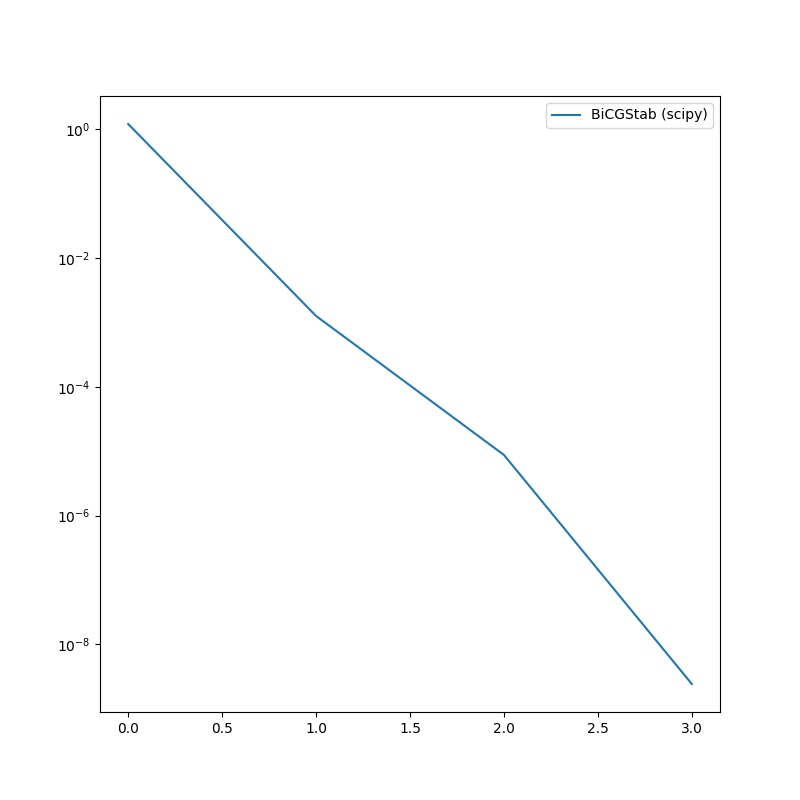

In [457]:

fig, axis = plt.subplots(1,1, figsize = (8,8))

# axis.plot(convergence, label = 'BiCGStab')
axis.plot(convergence_scipy, label = 'BiCGStab (scipy)')
axis.set_yscale('log')

axis.legend()

In [308]:

A = (H, (i,j), numParticles)
xk, iter, convergence, r0,Htest, itest,jtest = bicgstab(A, B, x0, tol = 1e-3, rtol = 1e-1, maxiter = 128, M = M_coo)

BiCGStab Solver
Initial Residual: 1031.5871820664954, Threshold 0.001
atol: 103.15871820664955 [0.1]
rhotol: 4.930380657631324e-32 | omegatol: 4.930380657631324e-32
Initial Residual: 1031.5871820664954
1031.5871820664954 -> 3385195.857628665 | 422.150571813451 -> 1242875.9612740446 | 0.0 | 1031.5871820664954
	=>	304.24458872982234 | 422.150571813451 | 0.3585302234254177 | 253.05152590639645
	[  0]	Residual: 253.05149299487655 | rho: 1064172.1142038815 | alpha: 0.00032926380124155514 | omega: 0.0002718689949754971
304.24458872982234 -> 341959.9371028449 | 191.595533458075 -> 245986.3539339478 | 0.3585302234254177 | 253.05152590639645
	=>	192.17110353189895 | 191.595533458075 | 0.5130148660388526 | 177.38266824661696
	[  1]	Residual: 177.38244682473933 | rho: 139997.55046999382 | alpha: 0.0005348809508328284 | omega: 0.00029439481605340867
192.17110353189895 -> 108648.27248010883 | 222.29957376099995 -> 520008.95537919377 | 0.5130148660388526 | 177.38266824661696
	=>	233.28548393636044 |

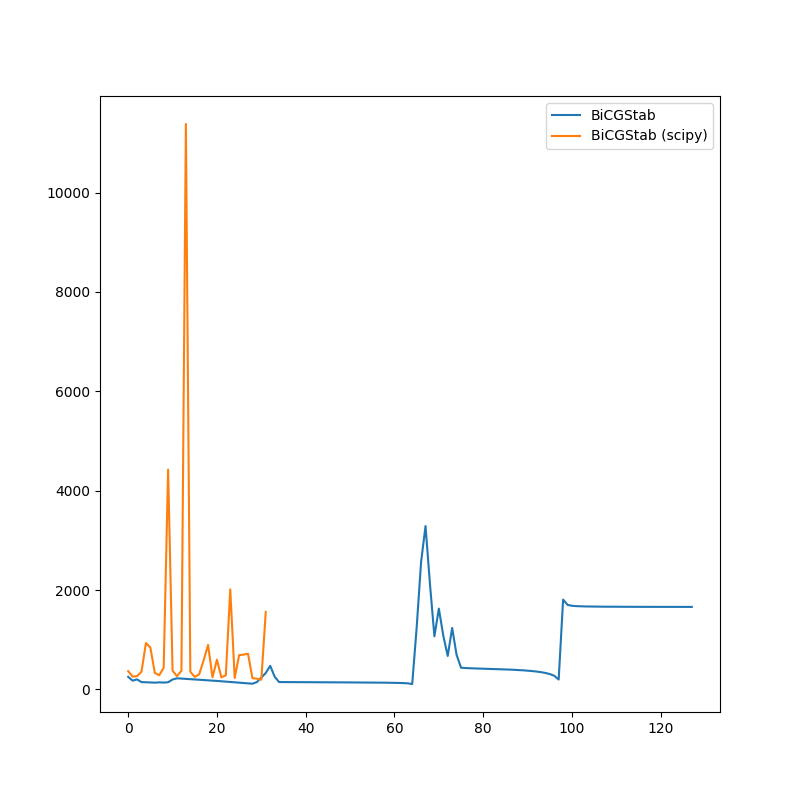

In [314]:
fig, axis = plt.subplots(1,1, figsize = (8,8))

axis.plot(convergence, label = 'BiCGStab')
axis.plot(convergence_scipy, label = 'BiCGStab (scipy)')

axis.legend()

In [245]:
torch.all(itest == i)
torch.all(jtest == j)
torch.all(Htest == H)

tensor(True)

In [247]:

# @torch.jit.script
def BiCGStab(H, B, x0, i, j, tol : float =1e-5):
    xk = x0
    rk = torch.zeros_like(x0)
    numParticles = rk.shape[0] // 2

    rk[::2]  += scatter_sum(H[:,0,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
    rk[::2]  += scatter_sum(H[:,0,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)

    rk[1::2] += scatter_sum(H[:,1,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
    rk[1::2] += scatter_sum(H[:,1,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)
    
    rk = B - rk
    r0 = rk.clone()
    pk = rk.clone()
    
    num_iter = 0
    convergence = []
    print(f'Initial Residual: {torch.linalg.norm(r0)}')
    while torch.linalg.norm(rk) > tol and num_iter < 128:
        apk = torch.zeros_like(x0)

        apk[::2]  += scatter_sum(H[:,0,0] * pk[j * 2], i, dim=0, dim_size=numParticles)
        apk[::2]  += scatter_sum(H[:,0,1] * pk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        apk[1::2] += scatter_sum(H[:,1,0] * pk[j * 2], i, dim=0, dim_size=numParticles)
        apk[1::2] += scatter_sum(H[:,1,1] * pk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        alpha = torch.dot(rk, r0) / torch.dot(apk, r0)
        sk = rk - alpha * apk
        ask = torch.zeros_like(x0)

        ask[::2]  += scatter_sum(H[:,0,0] * sk[j * 2], i, dim=0, dim_size=numParticles)
        ask[::2]  += scatter_sum(H[:,0,1] * sk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        ask[1::2] += scatter_sum(H[:,1,0] * sk[j * 2], i, dim=0, dim_size=numParticles)
        ask[1::2] += scatter_sum(H[:,1,1] * sk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        print(f'{torch.linalg.norm(pk)} -> {torch.linalg.norm(apk)} | {torch.linalg.norm(sk)} -> {torch.linalg.norm(ask)} | {torch.linalg.norm(xk)} | {torch.linalg.norm(rk)}')

        omega = torch.dot(ask, sk) / torch.dot(ask, ask)
        xk = xk + alpha * pk + omega * sk
        rk = sk - omega * ask

        beta = (torch.dot(rk, r0) / torch.dot(r0, r0)) * (alpha / omega)
        pk = rk + beta * (pk - omega * apk)
        
        print(f'\t=>\t{torch.linalg.norm(pk)} | {torch.linalg.norm(sk)} | {torch.linalg.norm(xk)} | {torch.linalg.norm(rk)}')
        
        num_iter += 1

        residual = torch.zeros_like(B)
        residual[::2]  += scatter_sum(H[:,0,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
        residual[::2]  += scatter_sum(H[:,0,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        residual[1::2] += scatter_sum(H[:,1,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
        residual[1::2] += scatter_sum(H[:,1,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        convergence.append(torch.linalg.norm(residual - B))
        print(f'\t[{num_iter:3d}]\tResidual: {torch.linalg.norm(residual - B)} | rho: {torch.abs(torch.dot(rk, r0))} | alpha: {torch.linalg.norm(alpha)} | omega: {torch.linalg.norm(omega)}')




    return xk, num_iter, convergence, r0


xk2, iters2, convergence2, r02 = BiCGStab(H, B, x0, i, j)
print(x0)

Initial Residual: 1031.5871891514448
1031.5871891514448 -> 3385195.8846714767 | 422.15057584565955 -> 1242876.6810375797 | 0.0 | 1031.5871891514448
	=>	304.24458739002586 | 422.15057584565955 | 0.3585302075578913 | 253.05149475557204
	[  1]	Residual: 253.05149475557204 | rho: 139997.52526437322 | alpha: 0.000329263800999348 | omega: 0.0002718688603562901
304.24458739002586 -> 341960.00597892335 | 191.59542121214977 -> 245985.34977667517 | 0.3585302075578913 | 253.05149475557204
	=>	192.17093505607804 | 191.59542121214977 | 0.513014915168124 | 177.38250265670138
	[  2]	Residual: 177.3825026567014 | rho: 39107.533758161466 | alpha: 0.000534880710400388 | omega: 0.0002943964594543453
192.17093505607804 -> 108648.48267125446 | 222.2966618592679 -> 519991.9682708721 | 0.513014915168124 | 177.38250265670138
	=>	233.2831634323144 | 222.2966618592679 | 0.7476284311674788 | 202.00661870574132
	[  3]	Residual: 202.00661870574132 | rho: 23526.53301027731 | alpha: 0.001511062669872953 | omega: 0.0

In [238]:
(r0-r02).abs().max()

tensor(0., dtype=torch.float64)

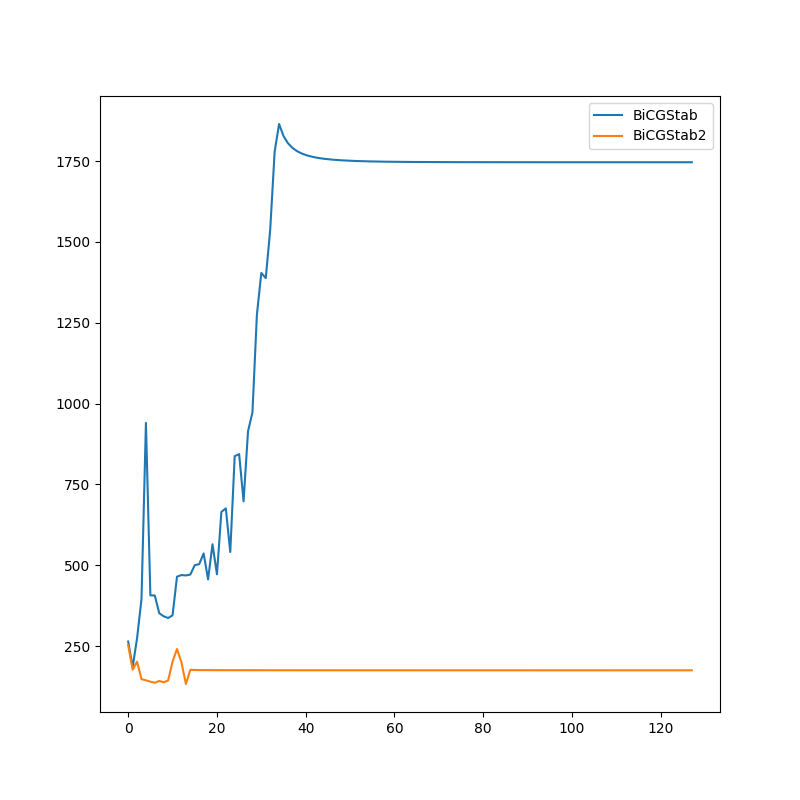

In [248]:
fig, axis = plt.subplots(1,1, figsize = (8,8))

axis.plot(convergence, label = 'BiCGStab')
axis.plot(convergence2, label = 'BiCGStab2')

axis.legend()

In [41]:
from diffSPH.v2.modules.shifting import computeShifting
def solveShifting(simulationState, config):
    with record_function("[Shifting] - Compute Shift Amount"):
        numParticles = simulationState['fluid']['numParticles']
        fluidState = simulationState['fluid']
        boundaryParticleState = simulationState['boundary'] if 'boundary' in simulationState else None

        mergedPositions = torch.cat((fluidState['positions'], boundaryParticleState['positions']), dim = 0) if boundaryParticleState is not None else fluidState['positions']
        mergedVelocities = torch.cat((fluidState['velocities'], boundaryParticleState['velocities']), dim = 0) if boundaryParticleState is not None else fluidState['velocities']
        mergedMasses = torch.cat((fluidState['masses'], boundaryParticleState['masses']), dim = 0) if boundaryParticleState is not None else fluidState['masses']
        mergedAreas = torch.cat((fluidState['areas'], boundaryParticleState['areas']), dim = 0) if boundaryParticleState is not None else fluidState['areas']
        mergedDensities = torch.cat((fluidState['densities'], boundaryParticleState['densities']), dim = 0) if boundaryParticleState is not None else fluidState['densities']
        mergedSupports = torch.cat((fluidState['supports'], boundaryParticleState['supports']), dim = 0) if boundaryParticleState is not None else fluidState['supports']
        boundaryMarker = torch.cat((torch.zeros(fluidState['positions'].shape[0], dtype = torch.int32), torch.ones(boundaryParticleState['positions'].shape[0], dtype = torch.int32))) if boundaryParticleState is not None else torch.zeros(fluidState['positions'].shape[0], dtype = torch.int32)
        
        particleState = {
            'positions': mergedPositions,
            'velocities': mergedVelocities,
            'masses': mergedMasses,
            'densities': mergedDensities,
            'supports': mergedSupports,
            'areas': mergedAreas,
            'numParticles': mergedPositions.shape[0],
            'boundaryMarker': boundaryMarker
        }
        if 'neighborhood' in simulationState['fluid']:
            particleState['neighborhood'] = simulationState['fluid']['neighborhood']


        initialPositions = torch.clone(particleState['positions'])
        initialDensities = torch.clone(particleState['densities'])
        overallStates = []
        for i in range(config['shifting']['maxIterations']):
            with record_function("[Shifting] - Shift Iteration [Iteration: %3d]" % i):
                with record_function("[Shifting] - Shift Iteration [1 - Neighbor Search]"):
                    particleState['datastructure'], particleState['neighborhood'] = neighborSearch(particleState, particleState, config, 
                        computeKernels = True, 
                        priorState = None if 'neighborhood' not in particleState else particleState['neighborhood'],
                        neighborDatastructure = None if 'datastructure' not in particleState else particleState['datastructure'],
                        verbose = False)
                    particleState['numNeighbors'] = particleState['neighborhood']['numNeighbors']
                
                    
                    # particleState['neighborhood'] = neighborSearch(particleState, particleState, config, priorNeighborhood=particleState['neighborhood'] if 'neighborhood' in particleState else None)
                if config['shifting']['summationDensity']:
                    particleState['densities'] = sphOperationStates(particleState, particleState, None, operation = 'density', neighborhood=particleState['neighborhood'])

                with record_function("[Shifting] - Shift Iteration [2 - Surface Detection]"):
                    if config['shifting']['freeSurface']:
                        if config['shifting']['surfaceDetection'] == 'Maronne':
                            particleState['L'], normalizationMatrices, particleState['L.EVs'] = computeNormalizationMatrices(particleState, particleState, particleState['neighborhood'], config)
                            particleState['normals'], particleState['Lambdas'] = computeNormalsMaronne(particleState, particleState, particleState['neighborhood'], config)
                            particleState['freeSurface'], cA, cB = detectFreeSurfaceMaronne(particleState, particleState, particleState['neighborhood'], config)
                        elif config['shifting']['surfaceDetection'] == 'colorGrad':
                            particleState['color'] = computeColorField(particleState, particleState, particleState['neighborhood'], config)
                            particleState['colorGradient'] = computeColorFieldGradient(particleState, particleState, particleState['neighborhood'], config)
                            particleState['freeSurface'] = detectFreeSurfaceColorFieldGradient(particleState, particleState, particleState['neighborhood'], config)
                        elif config['shifting']['surfaceDetection'] == 'Barcasco':
                            particleState['freeSurface'] = detectFreeSurfaceBarecasco(particleState, particleState, particleState['neighborhood'], config)
                                        
                        particleState['freeSurfaceMask'] = expandFreeSurfaceMask(particleState, particleState, particleState['neighborhood'], config)

                
                with record_function("[Shifting] - Shift Iteration [3 - Shift Computation]"):
                    if config['shifting']['scheme'] == 'IPS':
                        update, K, J, H, B, convergence, iters, residual = computeShifting(particleState, config, computeRho = config['shifting']['summationDensity'], scheme = config['shifting']['solver'])
                        overallStates.append((convergence, iters, residual))
                    else:
                        update = -deltaPlusShifting(particleState, config)
                        # print(f'Update: {update.max()}, {update.min()}')
                with record_function("[Shifting] - Shift Iteration [4 - Surface Projection]"):
                    if config['shifting']['freeSurface']:
                        if config['shifting']['normalScheme'] == 'color':
                            ones = torch.ones_like(particleState['supports'])
                            colorField = sphOperationStates(particleState, particleState, neighborhood = particleState['neighborhood'], quantities = (ones, ones), operation = 'interpolate')
                            gradColorField = sphOperationStates(particleState, particleState, neighborhood = particleState['neighborhood'], quantities = (colorField, colorField), operation = 'gradient', gradientMode = 'difference')
                            n = torch.nn.functional.normalize(gradColorField, dim = -1)
                            particleState['normals'] = n
                        elif config['shifting']['normalScheme'] == 'lambda':
                            # if 'fluidL' not in particleState:                        
                            particleState['L'], normalizationMatrices, particleState['L.EVs'] = computeNormalizationMatrices(particleState,particleState,particleState['neighborhood'], config)
                            particleState['normals'], particleState['Lambdas'] = computeNormalsMaronne(particleState, particleState,particleState['neighborhood'], config)
                            n = torch.nn.functional.normalize(computeLambdaGrad(particleState, config), dim = -1)
                            particleState['normals'] = n
                        else:
                            n = particleState['normals']
                            
                        fs = particleState['freeSurface']
                        fsm = particleState['freeSurfaceMask']
                        # print(update[fs > 0.5].abs().max())
                        if config['shifting']['projectionScheme'] == 'dot':
                            result = update + torch.einsum('ij,ij->i', update, n)[:, None] * n
                            update[fsm > 0.5] = result[fsm > 0.5] * config['shifting']['surfaceScaling']
                            # update[fs > 0.5] = 0
                            update[particleState['Lambdas'] < 0.4] = 0
                        elif config['shifting']['projectionScheme'] == 'mat':
                            nMat = torch.einsum('ij, ik -> ikj', particleState['normals'], particleState['normals'])
                            M = torch.diag_embed(particleState['positions'].new_ones(particleState['positions'].shape)) - nMat
                            result = torch.bmm(M, update.unsqueeze(-1)).squeeze(-1)
                            update[fsm > 0.5] = result[fsm > 0.5] 
                            update[particleState['Lambdas'] < 0.4] = 0
                            update[fs > 0.5] = update[fs > 0.5] * config['shifting']['surfaceScaling']
                        else:
                            update[particleState['Lambdas'] < 0.4] = 0
                            # update[fs > 0.5] = 0
                        
                with record_function("[Shifting] - Shift Iteration [5 - Update]"):
                    spacing = config['particle']['dx']
                    # print(
                    #     f'Iter: {i}, Threshold {config["shifting"]["threshold"] * spacing}, max Update = {update.max()} Ratio {update.max() / (config["shifting"]["threshold"] * spacing)}')

                    update = torch.clamp(update, -config['shifting']['threshold'] * spacing, config['shifting']['threshold'] * spacing)
                    update[boundaryMarker != 0,:] = 0
                    # print(f'Update: {update.max()} Ratio: {update.max() / (config["shifting"]["threshold"] * spacing)}')
                    # update = torch.clamp(update, -config['shifting']['threshold'] * spacing, config['shifting']['threshold'] * spacing)
                    particleState['positions'] = particleState['positions'] - update

                # print(f'J: {J.abs().max()}')
        dx = particleState['positions'] - initialPositions
        particleState['positions'] = initialPositions
        particleState['densities'] = initialDensities

        simulationState['fluid']['positions'] = particleState['positions'][:numParticles]
        simulationState['fluid']['densities'] = particleState['densities'][:numParticles]
        dx = dx[:numParticles]

        if 'neighborhood' in simulationState['fluid']:
            if 'boundary' not in simulationState:
                simulationState['fluid']['neighborhood'] = particleState['neighborhood']

        return dx, overallStates, K, J, H, B

In [42]:
config['shifting']['scheme'] = 'IPS'
config['shifting']['maxIterations'] = 1
config['shifting']['summationDensity'] = True
config['shifting']['threshold'] = 0.05

xk, state,  K2, J2, H2, B2 = solveShifting(solverState, config)

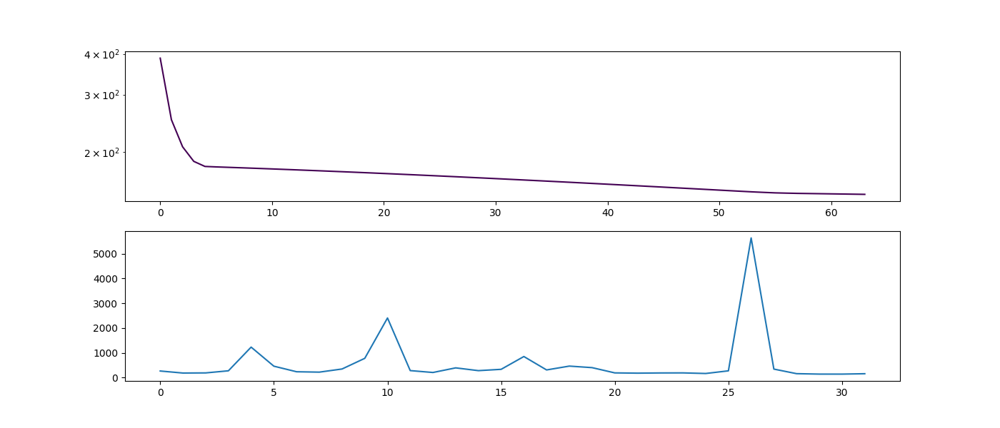

In [43]:
norm = plt.Normalize(0, len(state))
cmap = plt.get_cmap('viridis')

fig, axis = plt.subplots(2, 1, figsize=(14, 6), squeeze=False)

for i in range(len(state)):
    axis[0,0].plot([c.cpu().numpy().item() for c in state[i][0]], label = f'{i}', c = cmap(norm(i)))

axis[1,0].plot(convergence)

axis[0,0].set_yscale('log')

In [51]:
print('J:', (J2.cpu()-J.cpu()).abs().mean(), (J2.cpu()-J.cpu()).abs().max())
print('H:', (H2.cpu()-H.cpu()).abs().mean(), (H2.cpu()-H.cpu()).abs().max())
print('B:', (B2.cpu()-B.cpu()).abs().mean(), (B2.cpu()-B.cpu()).abs().max())

J: tensor(1.4636e-06) tensor(1.3351e-05)
H: tensor(2.9512e-06, dtype=torch.float64) tensor(0.0007, dtype=torch.float64)
B: tensor(1.4636e-06, dtype=torch.float64) tensor(1.3351e-05, dtype=torch.float64)


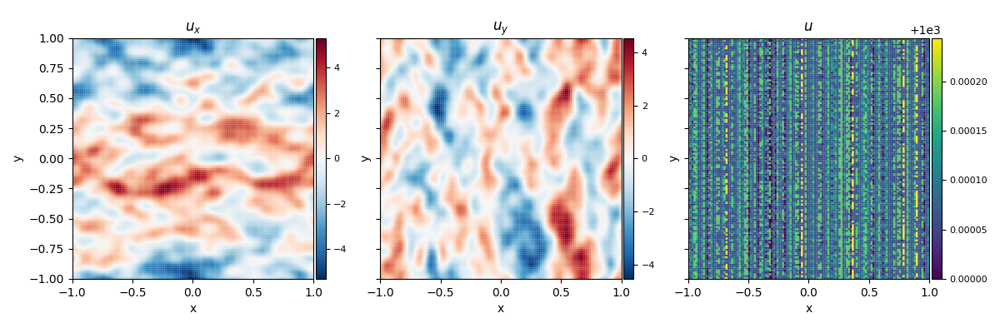

In [171]:
fig, axis = plt.subplots(1,3, figsize = (12,4), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', title = '$u_x$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'velocities',
                                      mapping = '.y', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = '$u_y$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'densities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$u$', plotBoth = False, which = 'fluid', midPoint = 0)


fig.tight_layout()

In [172]:
solverState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])


# p_starstar, iters_inc, errors, pressures, sourceTerm = solveIncompressible_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])

In [173]:
config['shifting']

{'scheme': 'IPS',
 'threshold': 0.1,
 'maxIterations': 1,
 'freeSurface': False,
 'R': 0.25,
 'n': 4,
 'CFL': 1.5,
 'computeMach': True,
 'solver': 'BiCGStab_wJacobi',
 'normalScheme': 'lambda',
 'projectionScheme': 'mat',
 'surfaceScaling': 0.1,
 'summationDensity': True,
 'useExtendedMask': False,
 'initialization': 'zero',
 'maxSolveIter': 256,
 'surfaceDetection': 'Barcasco',
 'active': True,
 'computeRho': True}

In [174]:
config['shifting']['scheme'] = 'IPS'
config['shifting']['maxIterations'] = 16
config['shifting']['summationDensity'] = True
config['shifting']['threshold'] = 0.05

In [175]:
newState = copy.deepcopy(solverState)

dx, states = solveShifting(newState, config)

newState['fluid']['positions'] += dx

searchNeighbors(newState, config)

newState['fluid']['densities'], _ =  callModule(newState, computeDensity, config, 'fluid')
rho = newState['fluid']['densities']
# newState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * newState['fluid']['positions'][:,0]) * torch.sin(k * newState['fluid']['positions'][:,1])
# newState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * newState['fluid']['positions'][:,0]) * torch.cos(k * newState['fluid']['positions'][:,1])


BiCGStab Solver
Initial Residual: 0.0002647464571055025, Threshold 0.001
atol: 2.647464571055025e-06 [0.01]
rhotol: 1.4210854715202004e-14 | omegatol: 1.4210854715202004e-14
Initial Residual: 0.0002647464571055025
	[  0]	Residual: 0.00011481458932394162 | rho: 7.009069236119103e-08 | alpha: 0.0006444700993597507 | omega: 0.0003547880332916975
	[  1]	Residual: 5.3826806833967566e-05 | rho: 2.1994596366425867e-08 | alpha: 0.0009958937298506498 | omega: 0.0007443641661666334
	[  2]	Residual: 3.491530878818594e-05 | rho: 6.260337581664999e-09 | alpha: 0.0007723263697698712 | omega: 0.0004253252118360251
	[  3]	Residual: 2.016811413341202e-05 | rho: 2.079892480466583e-09 | alpha: 0.0009386467863805592 | omega: 0.0006816324312239885
	[  4]	Residual: 1.2876709661213681e-05 | rho: 8.233909110089144e-10 | alpha: 0.0008010994642972946 | omega: 0.00047622466809116304
	[  5]	Residual: 8.876138963387348e-06 | rho: 1.9544690865735959e-10 | alpha: 0.0008412753813900054 | omega: 0.0005493880016729236


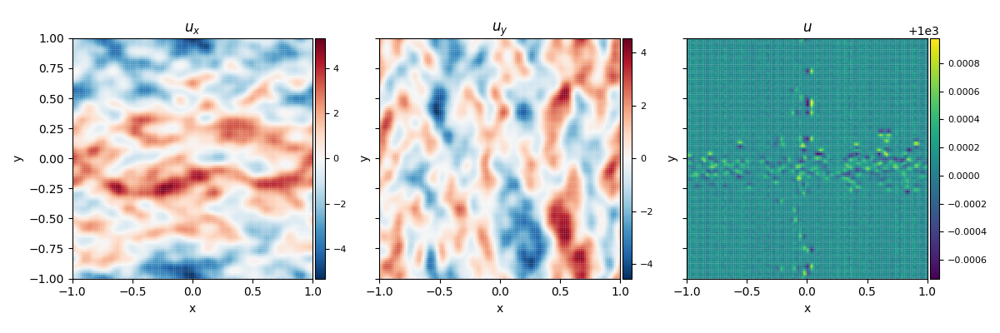

In [176]:
fig, axis = plt.subplots(1,3, figsize = (12,4), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(newState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', title = '$u_x$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'velocities',
                                      mapping = '.y', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = '$u_y$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'densities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$u$', plotBoth = False, which = 'fluid', midPoint = 0)


fig.tight_layout()

In [177]:

def computeDivergence(stateA, stateB, neighborhood, simConfig, key="velocities"):
    with record_function("[SPH] - Fluid Divergence ($nabla cdot \\bar{v}$)"):
        divergence = -sphOperationStates(
            stateA,
            stateB,
            (stateA[key], stateB[key]),
            neighborhood=neighborhood,
            operation="divergence",
            gradientMode = 'difference',
        )
        return divergence


from typing import Union
# @torch.jit.script 
def gradientOp(
        masses : tuple[torch.Tensor, torch.Tensor],                                 # Tuple of particle masses for (i,j)
        densities : tuple[torch.Tensor, torch.Tensor],                              # Tuple of particle densities for (i,j)
        quantities : Union[torch.Tensor, tuple[torch.Tensor, torch.Tensor]],                             # Tuple of particle quantities for (i,j)
        neighborhood : tuple[torch.Tensor, torch.Tensor], gradKernels : torch.Tensor,   # Neighborhood information (i,j) and precomupted kernels ij
        numParticles : int, type : str = 'naive'):    # Ancillary information
    i = neighborhood[0]                                                    
    j = neighborhood[1]

    k = masses[1][j].view(-1,1) * gradKernels
    Ai = torch.einsum('n..., n -> n...', quantities[0][i], 1.0 / densities[0][i]**2)
    Aj = torch.einsum('n..., n -> n...', quantities[1][j], 1.0 / densities[1][j]**2)
    kq = torch.einsum('n... , nd -> n...d', Ai + Aj, k)

    print('grad', Ai.shape, Aj.shape, kq.shape, k.shape)

    return torch.einsum('n, n... -> n...', densities[0], scatter_sum(kq, i, dim = 0, dim_size = numParticles))


def computeAlpha(stateA, stateB, config, neighborhood, dt, actualAreas):

    fluidNeighbors = neighborhood  # simulationState['fluid']['neighborhood']
    (i, j) = fluidNeighbors['indices']

    grad = fluidNeighbors['gradients']
    grad2 = torch.einsum('nd, nd -> n', grad, grad)

    term1 = actualAreas[1][j][:,None] * grad
    term2 = (actualAreas[1]**2 / (stateB['areas'] * config['fluid']['rho0']))[j] * grad2

    kSum1 = scatter_sum(term1, i, dim=0, dim_size=stateA['areas'].shape[0])
    kSum2 = scatter_sum(term2, i, dim=0, dim_size=stateA['areas'].shape[0])

    fac = - dt* dt * actualAreas[0]
    mass = stateA['areas'] * config['fluid']['rho0']
    alpha = fac / mass * torch.einsum('nd, nd -> n', kSum1, kSum1) + fac * kSum2
    # alpha = torch.clamp(alpha, -1, -1e-7)

    # alpha = alpha * dt
    return alpha# /3#* config['fluid']['rho0'] #/ dt


def computePressureAcceleration(stateA, stateB, config, neighborhood, pressure):
    # sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood'])
    return -sphOperationStates(
        stateA,
        stateB,
        (pressure[0], pressure[1]),
        operation="gradient",
        gradientMode="summation",
        neighborhood=neighborhood,
    # ) /  config['fluid']['rho0']# stateA["densities"].view(-1, 1)
    ) /  stateA["densities"].view(-1, 1)
    # ) / stateA["densities"].view(-1, 1) # config['fluid']['rho0'] ## stateA["densities"].view(-1, 1)


def updatePressure(
    stateA,
    stateB,
    config,
    neighborhood,
    dt,
    pressures,
    pressureAccels,
    sourceTerms,
    alphas,
):
    # print(dt)
    kernelSum = - dt * dt  * sphOperationStates(
        stateA,
        stateB,
        (pressureAccels[0], pressureAccels[1]),
        operation="divergence",
        gradientMode="difference",
        neighborhood=neighborhood,
    )

    sourceTerm = sourceTerms[0]

    kernelSum = kernelSum #* config['fluid']['rho0']
    alpha = alphas[0]#* config['fluid']['rho0']* 2

    residual = kernelSum - sourceTerm
    pressure = pressures[0] + 0.5 * (sourceTerm -  kernelSum) / ( alpha)# / dt

    pressure[torch.isinf(pressure)] = 0
    pressure[torch.isnan(pressure)] = 0
    pressure[pressure.abs() > 1e10] = 0

    pressure = pressure - pressure.mean()

    # print(f'pressure.max(): {pressure.max()} | pressure.min(): {pressure.min()} | pressure.mean(): {pressure.mean()}')
    # print(f'kernelSum.max(): {kernelSum.max()} | kernelSum.min(): {kernelSum.min()} | kernelSum.mean(): {kernelSum.mean()}')
    # print(f'sourceTerm.max(): {sourceTerm.max()} | sourceTerm.min(): {sourceTerm.min()} | sourceTerm.mean(): {sourceTerm.mean()}')
    # print(f'residual.max(): {residual.max()} | residual.min(): {residual.min()} | residual.mean(): {residual.mean()}')
    # print(f'alpha.max(): {alpha.max()} | alpha.min(): {alpha.min()} | alpha.mean(): {alpha.mean()}')

    # if config['dfsph']['clampPressure']:
    # pressure = torch.max(pressure, torch.zeros_like(pressure))

    return pressure, residual

from diffSPH.kernels import getKernel

def solveIncompressible_relaxedJacobi(stateA, stateB, config, dt, neighborhood):
    neighborDict = copy.copy(neighborhood)

    rij = neighborDict['distances']
    xij = neighborDict['vectors']
    hij = neighborDict['supports']

    dim = config['domain']['dim']
    kernel = config['kernel']['function']
    kernel = getKernel('Spiky')

    # neighborDict['kernels'] = kernel.kernel(rij, hij, dim)
    # neighborDict['gradients'] = kernel.kernelGradient(rij, xij, hij, dim) 
    

    rho = sphOperationStates(stateA, stateB, quantities=None, operation="density", neighborhood=neighborDict)
    advectionVelocities = stateA["velocities"] + stateA["advection"] * dt

    advectionDivergence = -sphOperationStates(stateA, stateB, (advectionVelocities, advectionVelocities), neighborhood=neighborhood, operation="divergence",gradientMode="difference")

    actualArea = stateA["masses"] / rho
    # direct formulation
    rho_initial = rho
    rhoStar = rho_initial - rho_initial * dt * advectionDivergence

    # sourceTerm = (config['fluid']['rho0'] - rhoStar) / timestep
    # PBSPH formulation
    sourceTerm = (1 - stateA["areas"] / actualArea + dt**2 * advectionDivergence) #* config['fluid']['rho0']

    sourceTerm = sourceTerm - sourceTerm.mean()

    pressureA = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])
    pressureB = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])

    if "pressureIncompressible" in stateA:
        pressureB = 0.5 * stateA["pressureIncompressible"].clone()
        pressureA = 0.5 * stateA["pressureIncompressible"].clone()

    # print(f"Initial Density: {(rho - config['fluid']['rho0']).max()} | {(rho- config['fluid']['rho0']).min()} | {(rho- config['fluid']['rho0']).abs().mean()}")
    # print(f"Predicted Density: {(rhoStar- config['fluid']['rho0']).max()} | {(rhoStar- config['fluid']['rho0']).min()} | {(rhoStar- config['fluid']['rho0']).abs().mean()}")
    # print(f"Source Term: {sourceTerm.max()} | {sourceTerm.min()} | {sourceTerm.abs().mean()}")
    # print(f"Advection Divergence: {advectionDivergence.abs().max()} | {advectionDivergence.abs().min()} | {advectionDivergence.mean()}")

    errors = []
    pressures = []
    i = 0
    error = 0.0
    minIters = 2  # config['dfsph']['minIters']
    maxIters = 256  # config['dfsph']['maxIters']
    errorThreshold = 5e-4  # config['dfsph']['errorThreshold']
    errorThreshold = 5e-4
    errorThreshold = 5e-4

    alpha = computeAlpha(stateA, stateB, config, neighborhood, dt=dt, actualAreas=(actualArea, actualArea))  # / fac
    # print(f"Alpha: {alpha.max()} | {alpha.min()} | {alpha.mean()}")

    alpha = alpha *3 #00 #* 10
    # alpha += torch.randn_like(alpha) * torch.abs(alpha) * 1e-4
    minResidual = 1e10

    while i < maxIters and (i < minIters or error > errorThreshold):
        pressureAccel = computePressureAcceleration(
            stateA, stateB, config, neighborDict, (pressureB, pressureB)
        )
        pressureA[:] = pressureB.clone()

        pressureB, residual = updatePressure( stateA, stateB, config, neighborDict, dt=dt, pressures=(pressureA, pressureA), pressureAccels=(pressureAccel, pressureAccel), sourceTerms=(sourceTerm, sourceTerm), alphas=(alpha, alpha))
        # if config['dfsph']['sourceTerm'] == 'density':
        # stateA['pressureB'] = torch.max(stateA['pressureB'], torch.zeros_like(stateA['pressureB']))
        # error = torch.mean(torch.clamp(stateA['residual'], min = -errorThreshold))

        error = torch.mean(torch.clamp(residual.abs(), min=-errorThreshold))  # / config['fluid']['rho0']

        errors.append(error.detach().cpu().item())
        # print(f"\tPS: {i:2d} -> {error.detach().cpu().item():+.4e}, pressure mean: {pressureB.mean().detach().cpu().item():+.4e}, pressure accel mean: {torch.linalg.norm(pressureAccel, dim=-1).mean().detach().cpu().item():+.4e}, pressure min: {pressureB.min()} max: {pressureB.max()}")
        # break
        pressures.append(pressureB.mean().detach().cpu().item())
        newResidual = residual.abs().mean()
        if newResidual < minResidual:
            minResidual = newResidual
        elif newResidual > 1.5 * minResidual:
            pressureB[:] = pressureA.clone()
            print(f"\tInstability in convergence!!")
            break

        i += 1
    pressureAccel = computePressureAcceleration(
        stateA, stateB, config, neighborDict, (pressureB, pressureB)
    )
    return pressureB, i, errors, pressures, sourceTerm, pressureAccel


def solveDivergenceFree_relaxedJacobi(stateA, stateB, config, dt, neighborhood):
    # areaScale = config['particle']['dx']


    neighborDict = copy.copy(neighborhood)

    rij = neighborDict['distances']
    xij = neighborDict['vectors']
    hij = neighborDict['supports']

    dim = config['domain']['dim']
    kernel = config['kernel']['function']
    kernel = getKernel('Spiky')

    # neighborDict['kernels'] = kernel.kernel(rij, hij, dim)
    # neighborDict['gradients'] = kernel.kernelGradient(rij, xij, hij, dim) 
    

    rho = sphOperationStates(stateA, stateB, quantities=None, operation="density", neighborhood=neighborhood)
    advectionVelocities = stateA["velocities"] + stateA["advection"] * dt

    advectionDivergence = -sphOperationStates(stateA, stateB, (advectionVelocities, advectionVelocities), neighborhood=neighborDict, operation="divergence",gradientMode="difference")

    actualArea = stateA["masses"] / rho
    # direct formulation
    rho_initial = rho
    rhoStar = rho_initial - rho_initial * dt * advectionDivergence

    # sourceTerm = (config['fluid']['rho0'] - rhoStar) / timestep
    # PBSPH formulation
    sourceTerm = 1 - stateA["areas"] / actualArea + dt * advectionDivergence
    sourceTerm = advectionDivergence #* dt #* config['fluid']['rho0']

    pressureA = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])
    pressureB = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])

    # if "pressure" in stateA:
        # pressureB = 0.5 * stateA["pressure"].clone()
        # pressureA = 0.5 * stateA["pressure"].clone()

    # print(f"Initial Density: {rho.abs().max()} | {rho.abs().min()} | {rho.mean()}")
    # print(f"Predicted Density: {rhoStar.abs().max()} | {rhoStar.abs().min()} | {rhoStar.mean()}")
    # print(f"Source Term: {sourceTerm.abs().max()} | {sourceTerm.abs().min()} | {sourceTerm.abs().mean()}")

    errors = []
    pressures = []
    i = 0
    error = 0.0
    minIters = 16  # config['dfsph']['minIters']
    maxIters = 16  # config['dfsph']['maxIters']
    # errorThreshold = 5e-4  # config['dfsph']['errorThreshold']
    # errorThreshold = 8.5e-5
    errorThreshold = 1e-4

    alpha = computeAlpha(stateA, stateB, config, neighborDict, dt=dt, actualAreas=(actualArea, actualArea))  # / fac
        # print(f"Alpha: {alpha.max()} | {alpha.min()} | {alpha.mean()}")
    alpha = alpha #* 1000#00
    previousResidual = sourceTerm
    while i < maxIters and (i < minIters or error > errorThreshold):
        pressureAccel = computePressureAcceleration(
            stateA, stateB, config, neighborDict, (pressureB, pressureB)
        )
        pressureA[:] = pressureB.clone()

        pressureB, residual = updatePressure( stateA, stateB, config, neighborDict, dt=dt, pressures=(pressureA, pressureA), pressureAccels=(pressureAccel, pressureAccel), sourceTerms=(sourceTerm, sourceTerm), alphas=(alpha, alpha))
        # if config['dfsph']['sourceTerm'] == 'density':
        # stateA['pressureB'] = torch.max(stateA['pressureB'], torch.zeros_like(stateA['pressureB']))
        # error = torch.mean(torch.clamp(stateA['residual'], min = -errorThreshold))

        error = torch.mean(torch.clamp(residual.abs(), min=-errorThreshold))  # / config['fluid']['rho0']

        errors.append(error.detach().cpu().item())
        print(f"DF: {i:2d} -> {error.detach().cpu().item()}, pressure mean: {pressureB.mean().detach().cpu().item():+.4e}, pressure accel mean: {torch.linalg.norm(pressureAccel, dim=-1).mean().detach().cpu().item():+.4e} pressure: {pressureB.min()} {pressureB.max()}")
        # break
        pressures.append(pressureB.mean().detach().cpu().item())

        # if error < previousResidual.abs().mean():
        #     previousResidual = residual
        #     alpha = alpha * 0.9
        #     # print(f'decreasing alpha [{error} | {previousResidual.abs().mean()}] {pressureB.min()} {pressureB.max()}')
        # else:
        #     alpha = alpha * 1.1
            # print(f'increasing alpha [{error} | {previousResidual.abs().mean()}] {pressureB.min()} {pressureB.max()}')
            # pressureB = pressureA.clone()

        i += 1
    # print(pressureA, pressureB)
    pressureAccel = computePressureAcceleration(
        stateA, stateB, config, neighborDict, (pressureA, pressureA)
    )
    return pressureB, i, errors, pressures, sourceTerm, pressureAccel, alpha



In [178]:
config['diffusion']['alpha'] = 0.05

In [179]:

def computeDivergence(stateA, stateB, neighborhood, simConfig, key="velocities"):
    with record_function("[SPH] - Fluid Divergence ($nabla cdot \\bar{v}$)"):
        divergence = -sphOperationStates(
            stateA,
            stateB,
            (stateA[key], stateB[key]),
            neighborhood=neighborhood,
            operation="divergence",
            gradientMode = 'difference',
        )
        return divergence
    
def simulationStep(solverState, config):
    searchNeighbors(solverState, config)
    # print(f'#############################################################################################')
    # print(f'Start of simulation step')

    # Advection Step
    solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

    # Divergence-Free Solver Preparation
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    # solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']

    divergence = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')
    # solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    # solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

    # print(f'Density: {solverState["fluid"]["densities"].max()} | {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].mean()}')
    # print(f'Gravity: {solverState["fluid"]["gravityAccel"].max()} | {solverState["fluid"]["gravityAccel"].min()} | {solverState["fluid"]["gravityAccel"].mean()}')
    # print(f'Viscosity: {solverState["fluid"]["velocityDiffusion"].max()} | {solverState["fluid"]["velocityDiffusion"].min()} | {solverState["fluid"]["velocityDiffusion"].mean()}')
    # print(f'Advection: {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).max()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).min()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).mean()}')
    
    v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    # Could also use actual density here
    # rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

    # Solve Divergence-Free PPE
    # pressure_star, iters, residuals, convergence, B, accel_p_star, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])
    # v_prime = v_star - accel_p_star * solverState['dt']  # / 10**3 
    # print(f'sourceTerm: {B.min()} | {B.max()} | {B.abs().mean()}')
    # print(f'Divergence before DF: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')

    # print(residuals[-1])
    # newState = copy.deepcopy(solverState)
    # newState['fluid']['velocities'] = v_prime
    # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)

    # print(f'Divergence after DF: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    # newState['fluid']['positions'] = newState['fluid']['positions'] + solverState['dt'] * v_prime
    # searchNeighbors(newState, config)
    # # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)
    # newState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    # # print(f'Divergence after Integration: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    # print(f'Density: {newState["fluid"]["densities"].max()} | {newState["fluid"]["densities"].min()} | {newState["fluid"]["densities"].mean()}')

    # approximationError = solverState['fluid']['densities'] - solverState['dt'] * divergence - newState['fluid']['densities']
    # print(f'Approximation Error: {approximationError.min()} | {approximationError.max()} | {approximationError.abs().mean()}')

    pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
    # iters = len(convergence)
    # print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
    # print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

    gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation='gradient', gradientMode='summation', neighborhood=solverState['fluid']['neighborhood'])
    accel_p_star = gradp_star / solverState['fluid']['densities'].view(-1, 1)
    # print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')
    solverState['fluid']['pressure'] = pressure_star
    solverState['fluid']['pressureAcceleration'] = -accel_p_star
    v_prime = v_star - accel_p_star * solverState['dt']  # / 10**3 

    # print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')
    # print(f'Pressure Acceleration {torch.linalg.norm(accel_p_star, dim = -1).max()} | {torch.linalg.norm(accel_p_star, dim = -1).min()} | {torch.linalg.norm(accel_p_star, dim = -1).mean()}')
          
    ## Check for proper convergence behavior
    # initialDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['velocities'], solverState['fluid']['velocities']), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'], gradientMode='difference')
    # advectionDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_star, v_star), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

    # print(f'Initial Divergence : {initialDivergence.min()} | {initialDivergence.max()} | {initialDivergence.mean()}')
    # print(f'Divergence after DF: {advectionDivergence.min()} | {advectionDivergence.max()} | {advectionDivergence.mean()}')

    # finalVelocities = v_prime
    # finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt']

    # solverState['fluid']['divergenceFreeVelocities'] = v_prime
    # accel_p_star = accel_p_star * 0

    ## Prepare incompressible PPE
    # v_prime = v_star + accel_p_star * solverState['dt']  # / 10**3 
    # solvedDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

    solverState['fluid']['advection'] += accel_p_star# * solverState['dt']

    ## Solve Incompressible PPE
    # for i in range(1):
        # searchNeighbors(solverState, config)
        # solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
        # if i > 0:
        #     solverState['fluid']['advection'][:,0] = 0
        #     solverState['fluid']['advection'][:,1] = 0
        #     v_prime = finalVelocities

    # solverState['fluid']['positions'] = solverState['fluid']['positions'] + solverState['dt'] * v_prime
    # solverState['fluid']['velocities'] = v_prime
    # solverState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])
    # searchNeighbors(solverState, config)

    newState = copy.deepcopy(solverState)
    newState['fluid']['velocities'] = v_prime
    newState['fluid']['positions'] = newState['fluid']['positions'] + solverState['dt'] * v_prime 
    searchNeighbors(newState, config)
    # newState['fluid']['velocities'] = torch.zeros_like(solverState['fluid']['velocities'])
    newState['fluid']['densities'], _ = callModule(newState, computeDensity, config, 'fluid')
    newState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])

    rho = newState['fluid']['densities'].clone()
    # print(f'Density (???): {(rho - config["fluid"]["rho0"]).min()} | {(rho - config["fluid"]["rho0"]).max()} | {(rho - config["fluid"]["rho0"]).abs().mean()}')
    p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel = solveIncompressible_relaxedJacobi(newState['fluid'], newState['fluid'], config, solverState['dt'], neighborhood=newState['fluid']['neighborhood'])
    # print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
    solverState['fluid']['pressureIncompressible'] = p_starstar * 0
    
    # print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
    # print(f'Pressure Acceleration {torch.linalg.norm(pressureAccel, dim = -1).max()} | {torch.linalg.norm(pressureAccel, dim = -1).min()} | {torch.linalg.norm(pressureAccel, dim = -1).mean()}')

    # gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation='gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 
    # particleShift = -solverState['dt'] ** 2  * gradp_starstar / rho.view(-1, 1)
    particleShift = solverState['dt'] **2 * pressureAccel
    gradV = -sphOperationStates(newState['fluid'], newState['fluid'], (v_prime, v_prime), operation='gradient', gradientMode='difference', neighborhood=newState['fluid']['neighborhood'])
    # print(f'particleShift: {particleShift.max()} | {particleShift.min()} | {particleShift.mean()}')

    newState = copy.deepcopy(solverState)
    newState['fluid']['velocities'] = v_prime
    # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)

    # print(f'Divergence after DF: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    newState['fluid']['positions'] = newState['fluid']['positions'] + solverState['dt'] * v_prime + particleShift
    searchNeighbors(newState, config)
    # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)
    newState['fluid']['densities'], _ = callModule(newState, computeDensity, config, 'fluid')
    # print(f'Divergence after Integration: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    # print(f'Source Term: {sourceTerm.min()} | {sourceTerm.max()} | {sourceTerm.abs().mean()}')
    # print(f'Density (t  ): {(solverState["fluid"]["densities"] - config["fluid"]["rho0"]).min()} | {(solverState["fluid"]["densities"] - config["fluid"]["rho0"]).max()} | {(solverState["fluid"]["densities"] - config["fluid"]["rho0"]).abs().mean()}')
    # print(f'Density (noshft): {(rho - config["fluid"]["rho0"]).min()} | {(rho - config["fluid"]["rho0"]).max()} | {(rho - config["fluid"]["rho0"]).abs().mean()}')
    # print(f'Density (t+1): {(newState["fluid"]["densities"] - config["fluid"]["rho0"]).min()} | {(newState["fluid"]["densities"] - config["fluid"]["rho0"]).max()} | {(newState["fluid"]["densities"] - config["fluid"]["rho0"]).abs().mean()}')
    

    print(f'{solverState["timestep"]:3d}\tDiv: {iters:3d} | {convergence[-1]:6.1f}, PS: {iters_inc:3d} | {errors[-1]:.4e}, rho: {newState["fluid"]["densities"].min() - config["fluid"]["rho0"]:.4g} | {newState["fluid"]["densities"].mean() - config["fluid"]["rho0"]:.4g} | {newState["fluid"]["densities"].max() - config["fluid"]["rho0"]:.4g} | pressure mean: {p_starstar.mean():+.4e}, pressure accel mean: {torch.linalg.norm(pressureAccel, dim=-1).mean():+.4e} pressure: {p_starstar.min()} {p_starstar.max()}')

    # print(f'Divergence Solver: {iters} | {convergence[-1]}')
    # print(f'Divergnce Solver: {iters} | {convergence[-1][1]}')
    # print(f'Incompressible Solver: {iters_inc} | {errors[-1]}')

    # Project velocities
    projectedVelocity = v_prime + torch.bmm(gradV.mT, particleShift.unsqueeze(-1)).squeeze(-1)
    finalVelocities = projectedVelocity

    # print(f'Projected Velocity: {projectedVelocity.max()} | {projectedVelocity.min()} | {projectedVelocity.mean()}')
    # finalVelocities = v_prime
    # if i == 0:
    
    finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt'] + particleShift
    # finalPositions = solverState['fluid']['positions'] + particleShift
    # else:
        # finalPositions += particleShift
    # solverState['fluid']['particleShift'] = particleShift
    # solverState['fluid']['projectedVelocities'] = projectedVelocity
    # print(solverState['dt'])
    solverState['fluid']['velocities'] = finalVelocities
    # solverState['fluid']['positions'] += finalVelocities * solverState['dt']#+ a_pi* solverState['dt']**2
    solverState['fluid']['positions'] = finalPositions

    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

    frameStats = {
        # 'initialDivergence': initialDivergence,
        # 'advectionDivergence': advectionDivergence,
        # 'solvedDivergence': solvedDivergence,
        'finalDivergence': finalDivergence,

        'divergenceFreeIters': iters,
        'divergenceFreeConvergence': convergence,
        'divergenceFreeResiduals': residuals,
        'divergenceFreePressure': pressure_star,
        'divergenceFreeSourceTerm': B,
        
        'incompressibleIters': iters_inc,
        'incompressibleConvergence': errors,
        'incompressiblePressures': pressures,
        'incompressibleSourceTerm': sourceTerm,

        'meanDensity': solverState['fluid']['densities'].mean(),
        'maxDensity': solverState['fluid']['densities'].max(),
        'minDensity': solverState['fluid']['densities'].min(),
        'q25Density': torch.quantile(solverState['fluid']['densities'], 0.25),
        'q75Density': torch.quantile(solverState['fluid']['densities'], 0.75),

        'meanPressureIncompressible': solverState['fluid']['pressureIncompressible'].mean(),
        'maxPressureIncompressible': solverState['fluid']['pressureIncompressible'].max(),
        'minPressureIncompressible': solverState['fluid']['pressureIncompressible'].min(),
        'q25PressureIncompressible': torch.quantile(solverState['fluid']['pressureIncompressible'], 0.25),
        'q75PressureIncompressible': torch.quantile(solverState['fluid']['pressureIncompressible'], 0.75),

        'meanPressure': solverState['fluid']['pressure'].mean() ,
        'maxPressure': solverState['fluid']['pressure'].max(),
        'minPressure': solverState['fluid']['pressure'].min(),
        'q25Pressure': torch.quantile(solverState['fluid']['pressure'], 0.25),
        'q75Pressure': torch.quantile(solverState['fluid']['pressure'], 0.75),

        'density': solverState['fluid']['densities']
    }

    return solverState, frameStats

In [180]:
config['shifting']
config['shifting']['maxSolveIter'] = 256
config['shifting']['maxIterations'] = 1
config['shifting']['threshold'] = 0.1
config['shifting']['summationDensity'] = True

In [182]:
solverState = copy.deepcopy(initialState)
solverState['dt'] = 0.001

stats = []
shiftAmount = []

for i in tqdm(range(32)):
    solverState, frameStats = simulationStep(solverState, config)
    # solverState['fluid']['']
    searchNeighbors(solverState, config)
    # dx, _ = solveShifting(solverState, config)
    # solverState['fluid']['positions'] += 1.0 * dx
    # solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
    # solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])

    solverState['time'] += solverState['dt']
    solverState['timestep'] += 1

    stats.append(frameStats)
    shiftAmount.append(dx)

  0%|          | 0/32 [00:00<?, ?it/s]

  0	Div:  23 |    0.5, PS:   2 | 1.5612e-04, rho: -0.7423 | 0.005676 | 0.5615 | pressure mean: -1.4305e-06, pressure accel mean: +8.3523e+00 pressure: -2026.7352294921875 1735.10546875
  1	Div:  45 |  226.9, PS:   2 | 2.7071e-04, rho: -1.311 | 0.02161 | 0.9918 | pressure mean: -1.4305e-06, pressure accel mean: +1.4375e+01 pressure: -3478.857177734375 2940.460205078125
  2	Div:  39 |  123.6, PS:   2 | 3.3722e-04, rho: -1.674 | 0.04633 | 1.259 | pressure mean: -4.2915e-06, pressure accel mean: +1.6976e+01 pressure: -4060.88330078125 3462.466796875
  3	Div:  44 |  138.3, PS:   2 | 3.8008e-04, rho: -1.912 | 0.07812 | 1.435 | pressure mean: +0.0000e+00, pressure accel mean: +1.8085e+01 pressure: -4494.04638671875 3668.548095703125
  4	Div:  40 |  391.6, PS:   2 | 4.1107e-04, rho: -2.074 | 0.1142 | 1.56 | pressure mean: -2.8610e-06, pressure accel mean: +1.8592e+01 pressure: -4765.0830078125 3737.8671875
  5	Div:  40 |  165.6, PS:   2 | 4.3538e-04, rho: -2.19 | 0.1516 | 1.65 | pressure mean:

In [183]:
from diffSPH.v2.modules.shifting import deltaPlusShifting, evalKernel, computeLambdaGrad, BiCG, BiCGStab, LinearCG
from diffSPH.v2.modules.normalizationMatrices import computeNormalizationMatrices
from diffSPH.v2.modules.surfaceDetection import detectFreeSurfaceBarecasco, computeNormalsMaronne, detectFreeSurfaceMaronne, expandFreeSurfaceMask, computeColorField, computeColorFieldGradient, detectFreeSurfaceColorFieldGradient
# from diffSPH.v2.modules.shifting import computeLambdaGrad, deltaPlusShifting, computeShifting, BiCGStab_wJacobi, BiCG, LinearCG, BiCGStab


In [184]:

def BiCGStab_wJacobi(H, B, x0, i, j, tol : float =1e-5, maxIter : int = 32):
    with record_function("[Shifting] - BiCGStab Solver w/ Jacobi Preconditioner"):
        xk = x0
        rk = torch.zeros_like(x0)
        numParticles = rk.shape[0] // 2
        ii = torch.unique(i)
        # Calculate the Jacobi preconditioner
        diag = torch.zeros_like(B).view(-1, 2)
        diag[ii,0] = H[i == j, 0, 0]
        diag[ii,1] = H[i == j, 1, 1]
        diag = diag.flatten()

        # diag = torch.vstack((H[i == j, 0, 0], H[i == j, 1, 1])).flatten()
        # diag[diag < 1e-8] = 1
        M_inv = 1 / diag
        M_inv[diag < 1e-8] = 0
        # M_inv[torch.isnan(M_inv)] = 1

        rk[::2]  += scatter_sum(H[:,0,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
        rk[::2]  += scatter_sum(H[:,0,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)

        rk[1::2] += scatter_sum(H[:,1,0] * xk[j * 2], i, dim=0, dim_size=numParticles)
        rk[1::2] += scatter_sum(H[:,1,1] * xk[j * 2 + 1], i, dim=0, dim_size=numParticles)
        
        rk = B - rk
        r0 = rk.clone()

        # Apply the preconditioner
        # zk = torch.bmm(M_inv, rk.unsqueeze(-1)).squeeze(-1)
        # print(f'i: {i.shape} x j: {j.shape} -> {i[i==j]}, {i}, {j}')
        # print(f'rk: {rk}, M_inv: {M_inv}, @ {M_inv.shape} * {rk.shape}')
        zk = M_inv * rk
        pk = zk.clone()
        
        num_iter = 0
        convergence = []
        rk_norm = torch.linalg.norm(rk)

        print('----------------------------------------------------------------------')
        print('Start of BiCGStab Solver\n')
        print(f'Initial Residual: {rk_norm}, Threshold {tol}')
        print(f'Ratio: {torch.abs(torch.linalg.norm(rk) / rk_norm - 1)}')



        # while (torch.abs(torch.linalg.norm(rk) / rk_norm - 1) > 1e-3 or num_iter == 0) and num_iter < maxIter and torch.linalg.norm(rk) > tol:
        while num_iter < maxIter and torch.linalg.norm(rk) > tol:
            print(f'\t[{num_iter:3d}]\tRatio: {torch.abs(torch.linalg.norm(rk) / rk_norm - 1)}')
            rk_norm = torch.linalg.norm(rk)
            apk = torch.zeros_like(x0)

            apk[::2]  += scatter_sum(H[:,0,0] * pk[j * 2], i, dim=0, dim_size=numParticles)
            apk[::2]  += scatter_sum(H[:,0,1] * pk[j * 2 + 1], i, dim=0, dim_size=numParticles)

            apk[1::2] += scatter_sum(H[:,1,0] * pk[j * 2], i, dim=0, dim_size=numParticles)
            apk[1::2] += scatter_sum(H[:,1,1] * pk[j * 2 + 1], i, dim=0, dim_size=numParticles)

            alpha = torch.dot(rk, r0) / (torch.dot(apk, r0) + 1e-8)
            sk = rk - alpha * apk
            ask = torch.zeros_like(x0)

            ask[::2]  += scatter_sum(H[:,0,0] * sk[j * 2], i, dim=0, dim_size=numParticles)
            ask[::2]  += scatter_sum(H[:,0,1] * sk[j * 2 + 1], i, dim=0, dim_size=numParticles)

            ask[1::2] += scatter_sum(H[:,1,0] * sk[j * 2], i, dim=0, dim_size=numParticles)
            ask[1::2] += scatter_sum(H[:,1,1] * sk[j * 2 + 1], i, dim=0, dim_size=numParticles)

            omega = torch.dot(ask, sk) / (torch.dot(ask, ask) + 1e-16)
            xk = xk + alpha * pk + omega * sk
            rk = sk - omega * ask

            # Apply the preconditioner
            zk = M_inv * rk
            beta = (torch.dot(rk, r0) / (torch.dot(r0, r0)) + 1e-16) * (alpha / (omega + 1e-16))
            pk = zk + beta * (pk - omega * apk)
            print(f'\t[{num_iter:3d}]\talpha {torch.abs(alpha):.4e} | omega {torch.abs(omega):.4e} | beta {torch.abs(beta):.4e} | Residual: {torch.linalg.norm(rk):.4e}')
            if torch.abs(alpha) < 1e-16 or torch.abs(omega) < 1e-16 or torch.abs(beta) < 1e-16:
                print(f'Numerical instability detected')
                print(f'alpha: {alpha} < 1e-16: {torch.abs(alpha) < 1e-16}')
                print(f'omega: {omega} < 1e-16: {torch.abs(omega) < 1e-16}')
                print(f'beta: {beta} < 1e-16: {torch.abs(beta) < 1e-16}')
                break

            # print('###############################################################################')
            # print(f'Iter: {num_iter}, Residual: {torch.linalg.norm(rk)}, Threshold {tol}')
            # print(f'alpha: {alpha}, omega: {omega}, beta: {beta}')
            # print(f'rk: {rk}, pk: {pk}, xk: {xk}')
            # print(f'apk: {apk}, ask: {ask}')
            # print(torch.dot(rk, r0))
            # print(torch.dot(r0, r0))
            # print((alpha / omega))

            num_iter += 1
            convergence.append(torch.linalg.norm(rk))
        print('End of BiCGStab Solver\n')
        print(f'')

        return xk, convergence, num_iter, torch.linalg.norm(rk)

In [185]:
@torch.jit.script
def idmat(shape:int, device: torch.device = torch.device('cpu'), dtype: torch.dtype = torch.float32):
    M_precond = torch.ones(shape, device=device, dtype=dtype)
    M_i = torch.arange(shape).to(M_precond.device).to(torch.int64)
    M_j = torch.arange(shape).to(M_precond.device).to(torch.int64)

    return (M_precond, (M_i, M_j), shape)

In [186]:
config['shifting']['initialization'] = 'zero'
config['shifting']['computeRho'] = True

In [187]:
def getShiftingMatrices(particleState, config, computeRho):
    with record_function("[Shifting] - Implicit Particle Shifting (IPS)"):
        numParticles = particleState['numParticles']

        if config['shifting']['freeSurface']:  
            if config['shifting']['useExtendedMask']:
                fs = particleState['freeSurfaceMask']
            else:
                fs = particleState['freeSurface']
            fsm = particleState['freeSurfaceMask']

        # particleState['fluidNeighborhood'] = fluidNeighborSearch(particleState, config)
        (i,j) = particleState['neighborhood']['indices']
        rij = particleState['neighborhood']['distances']
        xij = particleState['neighborhood']['vectors']
        hij = particleState['neighborhood']['supports']
        k = config['kernel']['function']
        dim = config['domain']['dim']

        K, J, H = evalKernel(rij, xij, hij, k, dim)
        if computeRho:
            particleState['densities'] = sphOperationStates(particleState, particleState, None, operation = 'density', neighborhood=particleState['neighborhood'])
            omega =  particleState['masses'] / particleState['densities']
        else:
            omega = particleState['areas']
        
        
        J = scatter_sum(J * omega[j,None], i, dim = 0, dim_size = numParticles)
        H = H * omega[j,None,None]

        h2 = particleState['supports'].repeat(2,1).T.flatten()
        h2 = config['particle']['dx']
        x0 = torch.rand(numParticles * 2).to(rij.device).type(rij.dtype) * h2 / 4 - h2 / 8
        if config['shifting']['initialization'] == 'deltaPlus':
            x0 = -deltaPlusShifting(particleState, config).flatten() * 0.5
        if config['shifting']['initialization'] == 'deltaMinus':
            x0 = deltaPlusShifting(particleState, config).flatten() * 0.5
        if config['shifting']['initialization'] == 'zero':
            x0 = torch.zeros_like(x0)
        

        B = torch.zeros(numParticles * 2, dtype = torch.float32, device=rij.device)

        # iActual = i
        # jActual = j
        activeMask = torch.ones_like(i, dtype = torch.bool)
        if config['shifting']['freeSurface']:

            J2 = torch.zeros(J.shape[0], 2, dtype = torch.float32, device=rij.device)
            J2[fs < 0.5, :] = J[fs < 0.5, :]

            B[::2] = J2[:,0]
            B[1::2] = J2[:,1]

            x0 = x0.view(-1,2)
            x0[fs > 0.5,0] = 0
            x0[fs > 0.5,1] = 0
            x0 = x0.flatten()
            H[fs[i] > 0.5,:,:] = 0
            # H[fs[j] > 0.5,:,:] = 0
            activeMask = fs[i] < 0.5
            # iActual = i[fs[i] < 0.5]
            # jActual = j[fs[i] < 0.5]

            # print(f'Iter: {iters}, Residual: {residual}, fs: xk fs: {update[fs > 0.5]}')
            # if scheme == 'BiCG':
            #     xk = BiCG(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
            # elif scheme == 'BiCGStab':
            #     xk = BiCGStab(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
            # elif scheme == 'BiCGStab_wJacobi':
            #     xk = BiCGStab_wJacobi(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
            # else:
            #     xk = LinearCG(H[fs[i] < 0.5], B[fs[i] < 0.5], x0[fs[i] < 0.5], iMasked, jMasked, maxIter = config['shifting']['maxSolveIter'])
        else:
            B[::2] = J[:,0]
            B[1::2] = J[:,1]

        # if torch.any(particleState['boundaryMarker'] > 0):
        #     # J[particleState['boundaryMarker'] > 0, :] = 0
        #     B.view(-1,2)[particleState['boundaryMarker'] > 0, 0] = 0
        #     H[particleState['boundaryMarker'][i] > 0, :, :] = 0
        #     x0.view(-1,2)[particleState['boundaryMarker'] > 0, 0] = 0
        #     if config['shifting']['freeSurface']:
        #         activeMask = torch.logical_and(particleState['boundaryMarker'][i] == 0, fs[i] < 0.5)
        #     else:
        #         activeMask = particleState['boundaryMarker'][i] == 0

    return H, B, x0, i, j, activeMask

def multiplySparseShifting(H, x, i, j):
    numParticles = x.shape[0] // 2

    apk = torch.zeros_like(x)
    apk[::2]  += scatter_sum(H[:,0,0] * x[j * 2], i, dim=0, dim_size=numParticles)
    apk[::2]  += scatter_sum(H[:,0,1] * x[j * 2 + 1], i, dim=0, dim_size=numParticles)

    apk[1::2] += scatter_sum(H[:,1,0] * x[j * 2], i, dim=0, dim_size=numParticles)
    apk[1::2] += scatter_sum(H[:,1,1] * x[j * 2 + 1], i, dim=0, dim_size=numParticles)

    return apk

from diffSPH.v2.sparse import matvec_sparse_coo, make_id, _get_tensor_eps, _get_atol_rtol
from typing import Tuple, Optional, Callable
def bicgstabfn(A_fn: Callable, shape: int, b, x0:Optional[torch.Tensor]=None, tol:float = 1e-5, rtol:float=1e-5, atol:float=0., maxiter:Optional[int]=None, M:Optional[ Tuple[torch.Tensor, Tuple[torch.Tensor, torch.Tensor], int]]=None):
    print(f'BiCGStab Solver')
    
    if M is None:
        print(f'No preconditioner')
        M = idmat(shape, device=b.device, dtype=b.dtype)
    x = x0.clone() if x0 is not None else torch.zeros_like(b)

    bnrm2 = torch.linalg.norm(b)
    print(f'Initial Residual: {bnrm2}, Threshold {tol}')
    atol, _ = _get_atol_rtol('bicgstab', bnrm2, atol, rtol)
    print(f'atol: {atol} [{rtol}]')
    convergence = []

    if bnrm2 == 0:
        print(f'Initial Residual is zero')
        return b, 0, convergence

    n = len(b)

    dotprod = torch.dot

    if maxiter is None:
        print(f'No max iterations setting to {n*10}')
        maxiter = n*10

    # matvec = A.matvec
    # psolve = M.matvec

    # These values make no sense but coming from original Fortran code
    # sqrt might have been meant instead.
    rhotol = _get_tensor_eps(x)**2
    omegatol = rhotol
    print(f'rhotol: {rhotol} | omegatol: {omegatol}')

    # Dummy values to initialize vars, silence linter warnings
    rho_prev = torch.zeros_like(b)
    omega = 0.
    alpha = 0.
    p = torch.zeros_like(b)
    v = torch.zeros_like(b)
    # rho_prev, omega, alpha, p, v = None, None, None, None, None

    r = b -  A_fn(x) if x.any() else b.clone()
    rtilde = r.clone()
    print(f'Initial Residual: {torch.linalg.norm(r)}')

    for iteration in range(maxiter):
        if torch.linalg.norm(r) < atol:  # Are we done?
            print(f'Converged after {iteration} iterations {torch.linalg.norm(r)} | {atol}')
            return x, iteration, convergence

        rho = dotprod(rtilde, r)
        if torch.abs(rho) < rhotol:  # rho breakdown
            print(f'\t[{iteration:3d}]\trho breakdown {rho} | {rhotol}')
            return x, -10, convergence

        if iteration > 0:
            if torch.abs(omega) < omegatol:  # omega breakdown
                print(f'\t[{iteration:3d}]\tomega breakdown {omega} | {omegatol}')
                return x, -11, convergence

            beta = (rho / rho_prev) * (alpha / omega)
            p -= omega*v
            p *= beta
            p += r
        else:  # First spin
            s = torch.empty_like(r)
            p = r.clone()

        phat = matvec_sparse_coo(M, p)
        v = A_fn(phat)
        # print(v)
        rv = dotprod(rtilde, v)
        if rv == 0:
            print(f'\t[{iteration:3d}]\trv breakdown {rv} | {torch.linalg.norm(rtilde)} | {torch.linalg.norm(v)} | {torch.linalg.norm(phat)}')
            return x, -11, convergence
        alpha = rho / rv
        r -= alpha*v
        s[:] = r[:]

        if torch.linalg.norm(s) < atol:
            print(f'\t[{iteration:3d}]\tConverged after {iteration} iterations {torch.linalg.norm(s)} | {atol}')
            x += alpha*phat
            return x, 0, convergence

        shat = matvec_sparse_coo(M, s)
        t = A_fn(shat)
        omega = dotprod(t, s) / dotprod(t, t)
        x += alpha*phat
        x += omega*shat
        r -= omega*t
        rho_prev = rho

        print(f'\t[{iteration:3d}]\tResidual: {torch.linalg.norm(r)} | rho: {torch.abs(rho)} | alpha: {torch.linalg.norm(alpha)} | omega: {torch.linalg.norm(omega)}')

        # print(omega, alpha)
        convergence.append(torch.linalg.norm(A_fn(x) - b))

    # else:  # for loop exhausted
        # Return incomplete progress
    print(f'Reached maximum iterations {maxiter}, returning with {torch.linalg.norm(r)}')
    return x, maxiter, convergence

In [188]:
H, B, x0, i, j, activeMask = getShiftingMatrices(solverState['fluid'], config, computeRho = True)

Bt = B.clone()
# B[0::2] = Bt[1::2]
# B[1::2] = Bt[0::2]

numParticles = B.shape[0] // 2
ii = torch.unique(i)
# Calculate the Jacobi preconditioner
diag = torch.zeros_like(B).view(-1, 2)
diag[ii,0] = H[i == j, 0, 0]
diag[ii,1] = H[i == j, 1, 1]
diag = diag.flatten()

M_inv = -1 / diag
M_inv[diag.abs() < 1e-8] = 0
# M_inv[:] = 1

M_i = torch.arange(0, numParticles*2, device=H.device)
M_j = torch.arange(0, numParticles*2, device=H.device)
M_coo = (M_inv, (M_i, M_j), numParticles*2)

print(M_inv)


tensor([0.0011, 0.0011, 0.0011,  ..., 0.0011, 0.0011, 0.0011], device='cuda:0')


In [189]:
print(H)

tensor([[[ 89.3449,   3.5293],
         [  3.5293,  -9.2782]],

        [[104.6462,  54.4035],
         [ 54.4035,   3.8408]],

        [[ 97.5229,  23.0806],
         [ 23.0806,  -7.4112]],

        ...,

        [[ 12.3422,  -9.2589],
         [ -9.2589,   5.9609]],

        [[ 68.7083,  25.3541],
         [ 25.3541,   1.3290]],

        [[  7.1237,   1.9060],
         [  1.9060,   0.3472]]], device='cuda:0')


In [190]:
print(f'H: {H.device}, {H.dtype}')
print(f'B: {B.device}, {B.dtype}')
print(f'x0: {x0.device}, {x0.dtype}')
print(f'i: {i.device}, {i.dtype}')
print(f'j, {j.device}, {j.dtype}')
print(f'M_inv: {M_inv.device}, {M_inv.dtype}')
print(f'M_i: {M_i.device}, {M_i.dtype}')
print(f'M_j: {M_j.device}, {M_j.dtype}')

H: cuda:0, torch.float32
B: cuda:0, torch.float32
x0: cuda:0, torch.float32
i: cuda:0, torch.int64
j, cuda:0, torch.int64
M_inv: cuda:0, torch.float32
M_i: cuda:0, torch.int64
M_j: cuda:0, torch.int64


In [191]:
x0.max()

tensor(0., device='cuda:0')

In [192]:
H = H.cpu().to(torch.float64)
x0 = x0.cpu().to(torch.float64)
B = B.cpu().to(torch.float64)
i = i.cpu()
j = j.cpu()
M_inv = M_inv.cpu().to(torch.float64)
M_i = M_i.cpu()
M_j = M_j.cpu()
M_coo = (M_inv, (M_i, M_j), numParticles*2)

In [193]:
xk, iter, convergence = bicgstabfn(lambda x: multiplySparseShifting(H, x, i, j), B.shape[0], B, x0, tol = 1e-3, rtol = 1e-1, maxiter = 32, M = M_coo)
residual = Afn(xk) - B

BiCGStab Solver
Initial Residual: 74.87290496269004, Threshold 0.001
atol: 7.487290496269004 [0.1]
rhotol: 4.930380657631324e-32 | omegatol: 4.930380657631324e-32
Initial Residual: 74.87290496269004
	[  0]	Residual: 32.01103542983395 | rho: 5605.951897552006 | alpha: 0.44430233312024003 | omega: 0.23655851313190826
	[  1]	Residual: 20.20441972145535 | rho: 1537.3646645064664 | alpha: 0.6378282010581847 | omega: 0.323575668299352
	[  2]	Residual: 16.94723621965509 | rho: 470.2020810173633 | alpha: 0.5358353199879486 | omega: 0.24153587427269993
	[  3]	Residual: 16.59858619588434 | rho: 154.81869759249415 | alpha: 0.6454268176375921 | omega: 0.23626319469051799
	[  4]	Residual: 19.099626420763656 | rho: 50.652140168756496 | alpha: 0.7013632545219022 | omega: 0.0005782206853469318
	[  5]	Residual: 26.035518872846115 | rho: 0.050586491387935695 | alpha: 0.806436214988373 | omega: 0.0933610777813078
	[  6]	Residual: 55.47899644638657 | rho: 0.010751321495732213 | alpha: 1.2985667749857668 |

In [101]:
xk, iter, convergence = bicgstabfn(lambda x: multiplySparseShifting(H, x, i, j), B.shape[0], B, x0, tol = 1e-3, rtol = 1e-1, maxiter = 1024, M = M_coo)
residual = Afn(xk) - B

BiCGStab Solver
Initial Residual: 69.53403232328908, Threshold 0.001
atol: 6.953403232328909 [0.1]
rhotol: 4.930380657631324e-32 | omegatol: 4.930380657631324e-32
Initial Residual: 69.53403232328908
	[  0]	Residual: 31.073980114247977 | rho: 4834.981651136202 | alpha: 0.0005053754060386082 | omega: 0.00028180946635750833
	[  1]	Residual: 26.90271805411885 | rho: 1300.582721764366 | alpha: 0.0008864496644795575 | omega: 0.00032223048240940334
	[  2]	Residual: 34.15520442134386 | rho: 433.83617908677115 | alpha: 0.0008912220209901987 | omega: 9.812978061444912e-05
	[  3]	Residual: 77.2298084477817 | rho: 72.692910801929 | alpha: 0.001753242479239587 | omega: 0.0002894872384391488
	[  4]	Residual: 159.11396896876354 | rho: 60.64110087432087 | alpha: 0.001491385001247173 | omega: 0.000137671537540804
	[  5]	Residual: 44.909048989954144 | rho: 22.76530252590834 | alpha: 0.00019935008391353638 | omega: 0.00029113599747197875
	[  6]	Residual: 31.93812509313907 | rho: 2.7643838563628407 | alph

In [51]:

def computeShifting(particleState, config, computeRho = False, scheme = 'BiCG'):
    with record_function("[Shifting] - Implicit Particle Shifting (IPS)"):
        H, B, x0, i, j, activeMask = getShiftingMatrices(particleState, config, computeRho = True)

        numParticles = B.shape[0] // 2
        ii = torch.unique(i)
        # Calculate the Jacobi preconditioner
        diag = torch.zeros_like(B).view(-1, 2)
        diag[ii,0] = H[i == j, 0, 0]
        diag[ii,1] = H[i == j, 1, 1]
        diag = diag.flatten()

        M_inv = 1 / diag
        M_inv[diag.abs() < 1e-8] = 0
        M_inv[:] = 1

        M_i = torch.arange(0, numParticles*2, device=H.device)
        M_j = torch.arange(0, numParticles*2, device=H.device)
        M_coo = (M_inv, (M_i, M_j), numParticles*2)

        # Apx = lambda x: multiplySparseShifting(H[activeMask], x, i[activeMask], j[activeMask])
        Apx = lambda x: multiplySparseShifting(H, x, i, j)

        xk, iters, convergence = bicgstabfn(lambda x: multiplySparseShifting(H, x, i, j), B.shape[0], B, x0, tol = 1e-3, rtol = 1e-2, maxiter = 512, M = M_coo)
        residual = Afn(xk) - B

        # if scheme == 'BiCG':
        #     xk, convergence, iters, residual = BiCG(H[activeMask], B, x0, i[activeMask], j[activeMask], maxIter = config['shifting']['maxSolveIter'])
        # elif scheme == 'BiCGStab':
        #     xk, convergence, iters, residual = BiCGStab(H[activeMask], B, x0, i[activeMask], j[activeMask], maxIter = config['shifting']['maxSolveIter'])
        # elif scheme == 'BiCGStab_wJacobi':
        #     xk, convergence, iters, residual = BiCGStab_wJacobi(H[activeMask], B, x0, i[activeMask], j[activeMask], maxIter = config['shifting']['maxSolveIter'])
        # else:
        #     xk, convergence, iters, residual = LinearCG(H[activeMask], B, x0, i[activeMask], j[activeMask], maxIter = config['shifting']['maxSolveIter'])

        update =  torch.vstack((-xk[::2],-xk[1::2])).T# , J, H, B
        return update, convergence, iters, residual

def solveShifting(simulationState, config):
    with record_function("[Shifting] - Compute Shift Amount"):
        numParticles = simulationState['fluid']['numParticles']
        fluidState = simulationState['fluid']
        boundaryParticleState = simulationState['boundary'] if 'boundary' in simulationState else None

        mergedPositions = torch.cat((fluidState['positions'], boundaryParticleState['positions']), dim = 0) if boundaryParticleState is not None else fluidState['positions']
        mergedVelocities = torch.cat((fluidState['velocities'], boundaryParticleState['velocities']), dim = 0) if boundaryParticleState is not None else fluidState['velocities']
        mergedMasses = torch.cat((fluidState['masses'], boundaryParticleState['masses']), dim = 0) if boundaryParticleState is not None else fluidState['masses']
        mergedAreas = torch.cat((fluidState['areas'], boundaryParticleState['areas']), dim = 0) if boundaryParticleState is not None else fluidState['areas']
        mergedDensities = torch.cat((fluidState['densities'], boundaryParticleState['densities']), dim = 0) if boundaryParticleState is not None else fluidState['densities']
        mergedSupports = torch.cat((fluidState['supports'], boundaryParticleState['supports']), dim = 0) if boundaryParticleState is not None else fluidState['supports']
        boundaryMarker = torch.cat((torch.zeros(fluidState['positions'].shape[0], dtype = torch.int32), torch.ones(boundaryParticleState['positions'].shape[0], dtype = torch.int32))) if boundaryParticleState is not None else torch.zeros(fluidState['positions'].shape[0], dtype = torch.int32)
        
        particleState = {
            'positions': mergedPositions,
            'velocities': mergedVelocities,
            'masses': mergedMasses,
            'densities': mergedDensities,
            'supports': mergedSupports,
            'areas': mergedAreas,
            'numParticles': mergedPositions.shape[0],
            'boundaryMarker': boundaryMarker
        }
        if 'neighborhood' in simulationState['fluid']:
            particleState['neighborhood'] = simulationState['fluid']['neighborhood']


        initialPositions = torch.clone(particleState['positions'])
        initialDensities = torch.clone(particleState['densities'])
        overallStates = []
        for i in range(config['shifting']['maxIterations']):
            with record_function("[Shifting] - Shift Iteration [Iteration: %3d]" % i):
                with record_function("[Shifting] - Shift Iteration [1 - Neighbor Search]"):
                    particleState['datastructure'], particleState['neighborhood'] = neighborSearch(particleState, particleState, config, 
                        computeKernels = True, 
                        priorState = None if 'neighborhood' not in particleState else particleState['neighborhood'],
                        neighborDatastructure = None if 'datastructure' not in particleState else particleState['datastructure'],
                        verbose = False)
                    particleState['numNeighbors'] = particleState['neighborhood']['numNeighbors']
                
                    
                    # particleState['neighborhood'] = neighborSearch(particleState, particleState, config, priorNeighborhood=particleState['neighborhood'] if 'neighborhood' in particleState else None)
                if config['shifting']['summationDensity']:
                    particleState['densities'] = sphOperationStates(particleState, particleState, None, operation = 'density', neighborhood=particleState['neighborhood'])

                with record_function("[Shifting] - Shift Iteration [2 - Surface Detection]"):
                    if config['shifting']['freeSurface']:
                        if config['shifting']['surfaceDetection'] == 'Maronne':
                            particleState['L'], normalizationMatrices, particleState['L.EVs'] = computeNormalizationMatrices(particleState, particleState, particleState['neighborhood'], config)
                            particleState['normals'], particleState['Lambdas'] = computeNormalsMaronne(particleState, particleState, particleState['neighborhood'], config)
                            particleState['freeSurface'], cA, cB = detectFreeSurfaceMaronne(particleState, particleState, particleState['neighborhood'], config)
                        elif config['shifting']['surfaceDetection'] == 'colorGrad':
                            particleState['color'] = computeColorField(particleState, particleState, particleState['neighborhood'], config)
                            particleState['colorGradient'] = computeColorFieldGradient(particleState, particleState, particleState['neighborhood'], config)
                            particleState['freeSurface'] = detectFreeSurfaceColorFieldGradient(particleState, particleState, particleState['neighborhood'], config)
                        elif config['shifting']['surfaceDetection'] == 'Barcasco':
                            particleState['freeSurface'] = detectFreeSurfaceBarecasco(particleState, particleState, particleState['neighborhood'], config)
                                        
                        particleState['freeSurfaceMask'] = expandFreeSurfaceMask(particleState, particleState, particleState['neighborhood'], config)

                
                with record_function("[Shifting] - Shift Iteration [3 - Shift Computation]"):
                    if config['shifting']['scheme'] == 'IPS':
                        update, convergence, iters, residual = computeShifting(particleState, config, computeRho = config['shifting']['summationDensity'], scheme = config['shifting']['solver'])
                        overallStates.append((convergence, iters, residual))
                    else:
                        update = -deltaPlusShifting(particleState, config)
                        # print(f'Update: {update.max()}, {update.min()}')
                with record_function("[Shifting] - Shift Iteration [4 - Surface Projection]"):
                    if config['shifting']['freeSurface']:
                        if config['shifting']['normalScheme'] == 'color':
                            ones = torch.ones_like(particleState['supports'])
                            colorField = sphOperationStates(particleState, particleState, neighborhood = particleState['neighborhood'], quantities = (ones, ones), operation = 'interpolate')
                            gradColorField = sphOperationStates(particleState, particleState, neighborhood = particleState['neighborhood'], quantities = (colorField, colorField), operation = 'gradient', gradientMode = 'difference')
                            n = torch.nn.functional.normalize(gradColorField, dim = -1)
                            particleState['normals'] = n
                        elif config['shifting']['normalScheme'] == 'lambda':
                            # if 'fluidL' not in particleState:                        
                            particleState['L'], normalizationMatrices, particleState['L.EVs'] = computeNormalizationMatrices(particleState,particleState,particleState['neighborhood'], config)
                            particleState['normals'], particleState['Lambdas'] = computeNormalsMaronne(particleState, particleState,particleState['neighborhood'], config)
                            n = torch.nn.functional.normalize(computeLambdaGrad(particleState, config), dim = -1)
                            particleState['normals'] = n
                        else:
                            n = particleState['normals']
                            
                        fs = particleState['freeSurface']
                        fsm = particleState['freeSurfaceMask']
                        # print(update[fs > 0.5].abs().max())
                        if config['shifting']['projectionScheme'] == 'dot':
                            result = update + torch.einsum('ij,ij->i', update, n)[:, None] * n
                            update[fsm > 0.5] = result[fsm > 0.5] * config['shifting']['surfaceScaling']
                            # update[fs > 0.5] = 0
                            update[particleState['Lambdas'] < 0.4] = 0
                        elif config['shifting']['projectionScheme'] == 'mat':
                            nMat = torch.einsum('ij, ik -> ikj', particleState['normals'], particleState['normals'])
                            M = torch.diag_embed(particleState['positions'].new_ones(particleState['positions'].shape)) - nMat
                            result = torch.bmm(M, update.unsqueeze(-1)).squeeze(-1)
                            update[fsm > 0.5] = result[fsm > 0.5] 
                            update[particleState['Lambdas'] < 0.4] = 0
                            update[fs > 0.5] = update[fs > 0.5] * config['shifting']['surfaceScaling']
                        else:
                            update[particleState['Lambdas'] < 0.4] = 0
                            # update[fs > 0.5] = 0
                        
                with record_function("[Shifting] - Shift Iteration [5 - Update]"):
                    spacing = config['particle']['dx']
                    # print(
                    #     f'Iter: {i}, Threshold {config["shifting"]["threshold"] * spacing}, max Update = {update.max()} Ratio {update.max() / (config["shifting"]["threshold"] * spacing)}')

                    update = torch.clamp(update, -config['shifting']['threshold'] * spacing, config['shifting']['threshold'] * spacing)
                    update[boundaryMarker != 0,:] = 0
                    print(f'Update: {update.max()} Ratio: {update.max() / (config["shifting"]["threshold"] * spacing)}')
                    # update = torch.clamp(update, -config['shifting']['threshold'] * spacing, config['shifting']['threshold'] * spacing)
                    
                    particleState['positions'] = particleState['positions'] - update

                # print(f'J: {J.abs().max()}')
        dx = particleState['positions'] - initialPositions
        particleState['positions'] = initialPositions
        particleState['densities'] = initialDensities

        simulationState['fluid']['positions'] = particleState['positions'][:numParticles]
        simulationState['fluid']['densities'] = particleState['densities'][:numParticles]
        dx = dx[:numParticles]

        if 'neighborhood' in simulationState['fluid']:
            if 'boundary' not in simulationState:
                simulationState['fluid']['neighborhood'] = particleState['neighborhood']

        return dx, overallStates

BiCGStab Solver
Initial Residual: 157.40098571777344, Threshold 0.001
atol: 1.5740098571777343 [0.01]
rhotol: 1.4210854715202004e-14 | omegatol: 1.4210854715202004e-14
Initial Residual: 157.40098571777344
	[  0]	Residual: 157.40098571777344
	[  1]	Residual: 49.15937805175781
	[  2]	Residual: 40.98270797729492
	[  3]	Residual: 51.431800842285156
	[  4]	Residual: 121.27890014648438
	[  5]	Residual: 191.48399353027344
	[  6]	Residual: 62.51325225830078
	[  7]	Residual: 49.33149337768555
	[  8]	Residual: 47.949710845947266
	[  9]	Residual: 44.819358825683594
	[ 10]	Residual: 46.194786071777344
	[ 11]	Residual: 45.77492904663086
	[ 12]	Residual: 45.989994049072266
	[ 13]	Residual: 47.34001159667969
	[ 14]	Residual: 53.35749816894531
	[ 15]	Residual: 82.73385620117188
	[ 16]	Residual: 696.908935546875
	[ 17]	Residual: 533.109130859375
	[ 18]	Residual: 72.8232192993164
	[ 19]	Residual: 40.55760192871094
	[ 20]	Residual: 42.25627517700195
	[ 21]	Residual: 37.096046447753906
	[ 22]	Residual: 25

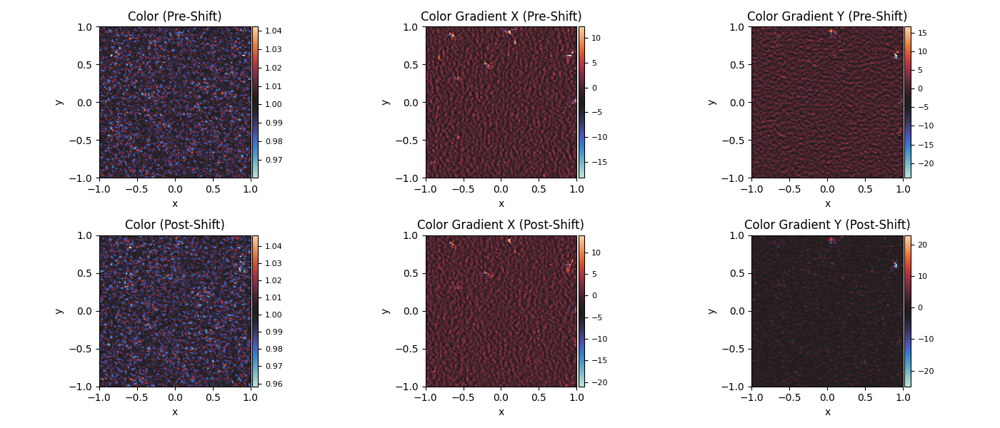

In [52]:
shiftState = copy.deepcopy(solverState)
fig, axis = plt.subplots(2, 3, figsize=(14, 6), squeeze=False)

shiftState['fluid']['positions'] += torch.randn_like(shiftState['fluid']['positions']) * 0.001

visualizationState = prepVisualizationState(shiftState, config)

searchNeighbors(shiftState, config)
ones = torch.ones_like(shiftState['fluid']['densities'])
shiftState['fluid']['densities'] = sphOperationStates(shiftState['fluid'], shiftState['fluid'], quantities=(ones, ones), operation='density', neighborhood=shiftState['fluid']['neighborhood'])
color = sphOperationStates(shiftState['fluid'], shiftState['fluid'], quantities=(ones, ones), operation='interpolate', neighborhood=shiftState['fluid']['neighborhood'])

cGrad = sphOperationStates(shiftState['fluid'], shiftState['fluid'], quantities=(color,color), operation='gradient', gradientMode='symmetric', neighborhood=shiftState['fluid']['neighborhood'])

s = 2
colorPlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity = color,
                                      mapping = 'L2', s = s, scaling = 'lin', gridVisualization=False, cmap = 'icefire', title = 'Color (Pre-Shift)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
colorGradXPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = cGrad,
                                      mapping = '.x', s = s, scaling = 'lin', gridVisualization=False, cmap = 'icefire', title = 'Color Gradient X (Pre-Shift)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
colorGradYPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = cGrad,
                                        mapping = '.y', s = s, scaling = 'lin', gridVisualization=False, cmap = 'icefire', title = 'Color Gradient Y (Pre-Shift)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)


config['shifting']['maxIterations'] = 1
# for i in range(128):
dx, state = solveShifting(shiftState, config)
shiftState['fluid']['positions'] += 1.0 * dx

searchNeighbors(shiftState, config)
ones = torch.ones_like(shiftState['fluid']['densities'])
shiftState['fluid']['densities'] = sphOperationStates(shiftState['fluid'], shiftState['fluid'], quantities=(ones, ones), operation='density', neighborhood=shiftState['fluid']['neighborhood'])
color = sphOperationStates(shiftState['fluid'], shiftState['fluid'], quantities=(ones, ones), operation='interpolate', neighborhood=shiftState['fluid']['neighborhood'])

cGrad = sphOperationStates(shiftState['fluid'], shiftState['fluid'], quantities=(color,color), operation='gradient', gradientMode='symmetric', neighborhood=shiftState['fluid']['neighborhood'])

s = 4
colorPlot = visualizeParticleQuantity(fig, axis[1,0], config, visualizationState, quantity = color,
                                      mapping = 'L2', s = s, scaling = 'lin', gridVisualization=False, cmap = 'icefire', title = 'Color (Post-Shift)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
colorGradXPlot = visualizeParticleQuantity(fig, axis[1,1], config, visualizationState, quantity = cGrad,
                                      mapping = '.x', s = s, scaling = 'lin', gridVisualization=False, cmap = 'icefire', title = 'Color Gradient X (Post-Shift)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
colorGradYPlot = visualizeParticleQuantity(fig, axis[1,2], config, visualizationState, quantity = cGrad,
                                        mapping = '.y', s = s, scaling = 'lin', gridVisualization=False, cmap = 'icefire', title = 'Color Gradient Y (Post-Shift)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)

fig.tight_layout()

{'scheme': 'IPS',
 'threshold': 0.1,
 'maxIterations': 128,
 'freeSurface': False,
 'R': 0.25,
 'n': 4,
 'CFL': 1.5,
 'computeMach': True,
 'solver': 'BiCGStab_wJacobi',
 'normalScheme': 'lambda',
 'projectionScheme': 'mat',
 'surfaceScaling': 0.1,
 'summationDensity': True,
 'useExtendedMask': False,
 'initialization': 'zero',
 'maxSolveIter': 256,
 'surfaceDetection': 'Barcasco',
 'active': True}

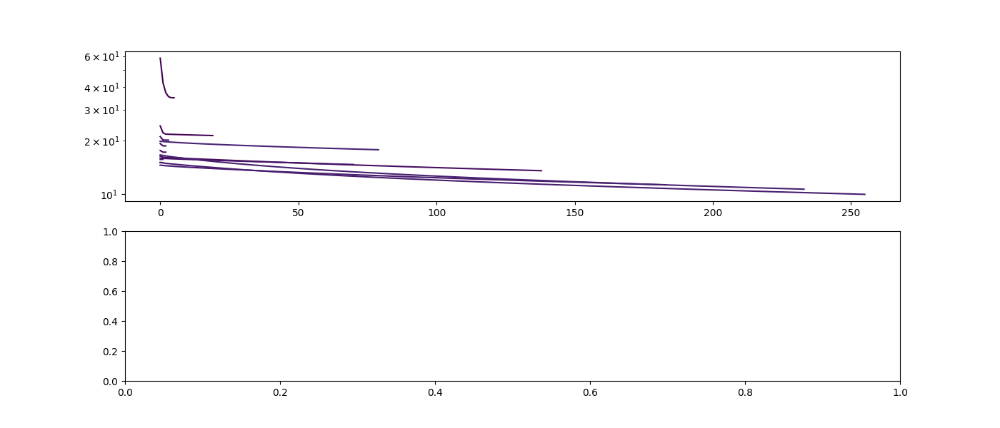

In [59]:
norm = plt.Normalize(0, len(state))
cmap = plt.get_cmap('viridis')

fig, axis = plt.subplots(2, 1, figsize=(14, 6), squeeze=False)

for i in range(len(state)):
    axis[0,0].plot([c.cpu().numpy().item() for c in state[i][0]], label = f'{i}', c = cmap(norm(i)))

axis[0,0].set_yscale('log')

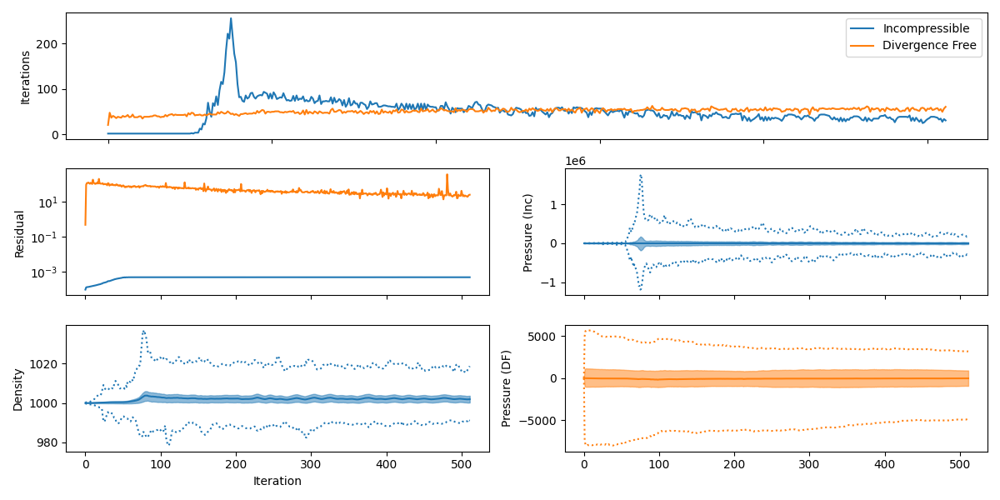

In [136]:
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

fig, axis = plt.subplot_mosaic('''AA
                               BC
                               DE''', figsize=(12, 6), sharex=True)

axis['A'].plot([s['incompressibleIters'] for s in stats], label='Incompressible')
axis['A'].plot([s['divergenceFreeIters'] for s in stats], label='Divergence Free')

axis['B'].plot([s['incompressibleConvergence'][-1] for s in stats], label='Incompressible Convergence')
axis['B'].plot([s['divergenceFreeConvergence'][-1].cpu() for s in stats], label='DF Convergence')
axis['B'].set_yscale('log')

# axis['C'].plot([s.cpu().abs().mean() for s in shiftAmount], label='Shift Amount')

axis['A'].legend()

# axis[0,0].set_title('Iterations')
# axis[1,0].set_title('Convergence')
# axis[2,0].set_title('Shift Amount')

axis['A'].set_ylabel('Iterations')
axis['B'].set_ylabel('Residual')
# axis['C'].set_ylabel('Shift Amount')
# axis[2,0].set_xlabel('Iteration')

axis['D'].plot([s['meanDensity'].cpu().item() for s in stats], label='Mean Density', color=colors[0])
axis['D'].fill_between(range(len(stats)), [s['q25Density'].cpu().item() for s in stats], [s['q75Density'].cpu().item() for s in stats], alpha=0.5, color=colors[0])
axis['D'].plot([s['maxDensity'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['D'].plot([s['minDensity'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['D'].set_ylabel('Density')
axis['D'].set_xlabel('Iteration')

axis['C'].plot([s['meanPressureIncompressible'].cpu().item() for s in stats], label='Incompressible Pressure', color=colors[0])
axis['C'].fill_between(range(len(stats)), [s['q25PressureIncompressible'].cpu().item() for s in stats], [s['q75PressureIncompressible'].cpu().item() for s in stats], alpha=0.5, color=colors[0])
axis['C'].plot([s['maxPressureIncompressible'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['C'].plot([s['minPressureIncompressible'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['C'].set_ylabel('Pressure (Inc)')

axis['E'].plot([s['meanPressure'].cpu().item() for s in stats], label='Pressure', color=colors[1])
axis['E'].fill_between(range(len(stats)), [s['q25Pressure'].cpu().item() for s in stats], [s['q75Pressure'].cpu().item() for s in stats], alpha=0.5, color=colors[1])
axis['E'].plot([s['maxPressure'].cpu().item() for s in stats], color=colors[1], ls = ':')
axis['E'].plot([s['minPressure'].cpu().item() for s in stats], color=colors[1], ls = ':')
axis['E'].set_ylabel('Pressure (DF)')

fig.tight_layout()

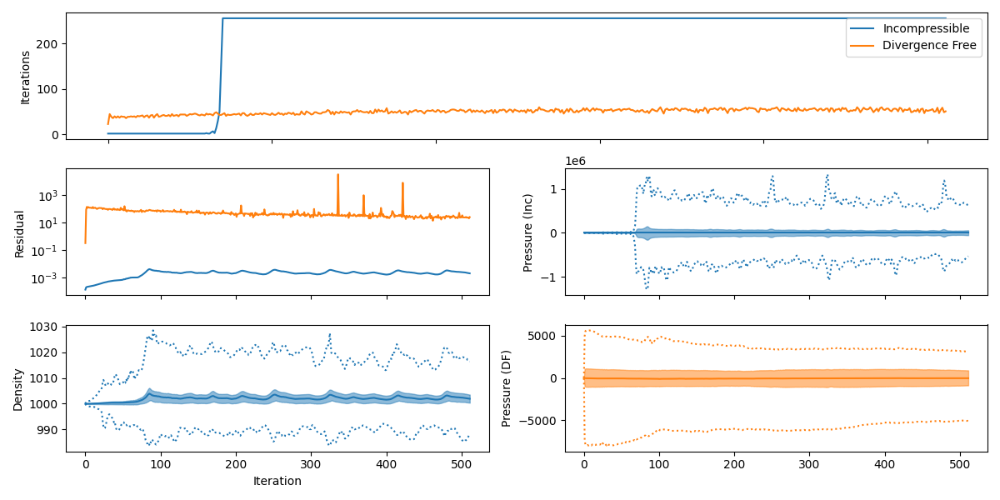

In [120]:
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

fig, axis = plt.subplot_mosaic('''AA
                               BC
                               DE''', figsize=(12, 6), sharex=True)

axis['A'].plot([s['incompressibleIters'] for s in stats], label='Incompressible')
axis['A'].plot([s['divergenceFreeIters'] for s in stats], label='Divergence Free')

axis['B'].plot([s['incompressibleConvergence'][-1] for s in stats], label='Incompressible Convergence')
axis['B'].plot([s['divergenceFreeConvergence'][-1].cpu() for s in stats], label='DF Convergence')
axis['B'].set_yscale('log')

# axis['C'].plot([s.cpu().abs().mean() for s in shiftAmount], label='Shift Amount')

axis['A'].legend()

# axis[0,0].set_title('Iterations')
# axis[1,0].set_title('Convergence')
# axis[2,0].set_title('Shift Amount')

axis['A'].set_ylabel('Iterations')
axis['B'].set_ylabel('Residual')
# axis['C'].set_ylabel('Shift Amount')
# axis[2,0].set_xlabel('Iteration')

axis['D'].plot([s['meanDensity'].cpu().item() for s in stats], label='Mean Density', color=colors[0])
axis['D'].fill_between(range(len(stats)), [s['q25Density'].cpu().item() for s in stats], [s['q75Density'].cpu().item() for s in stats], alpha=0.5, color=colors[0])
axis['D'].plot([s['maxDensity'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['D'].plot([s['minDensity'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['D'].set_ylabel('Density')
axis['D'].set_xlabel('Iteration')

axis['C'].plot([s['meanPressureIncompressible'].cpu().item() for s in stats], label='Incompressible Pressure', color=colors[0])
axis['C'].fill_between(range(len(stats)), [s['q25PressureIncompressible'].cpu().item() for s in stats], [s['q75PressureIncompressible'].cpu().item() for s in stats], alpha=0.5, color=colors[0])
axis['C'].plot([s['maxPressureIncompressible'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['C'].plot([s['minPressureIncompressible'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['C'].set_ylabel('Pressure (Inc)')

axis['E'].plot([s['meanPressure'].cpu().item() for s in stats], label='Pressure', color=colors[1])
axis['E'].fill_between(range(len(stats)), [s['q25Pressure'].cpu().item() for s in stats], [s['q75Pressure'].cpu().item() for s in stats], alpha=0.5, color=colors[1])
axis['E'].plot([s['maxPressure'].cpu().item() for s in stats], color=colors[1], ls = ':')
axis['E'].plot([s['minPressure'].cpu().item() for s in stats], color=colors[1], ls = ':')
axis['E'].set_ylabel('Pressure (DF)')

fig.tight_layout()

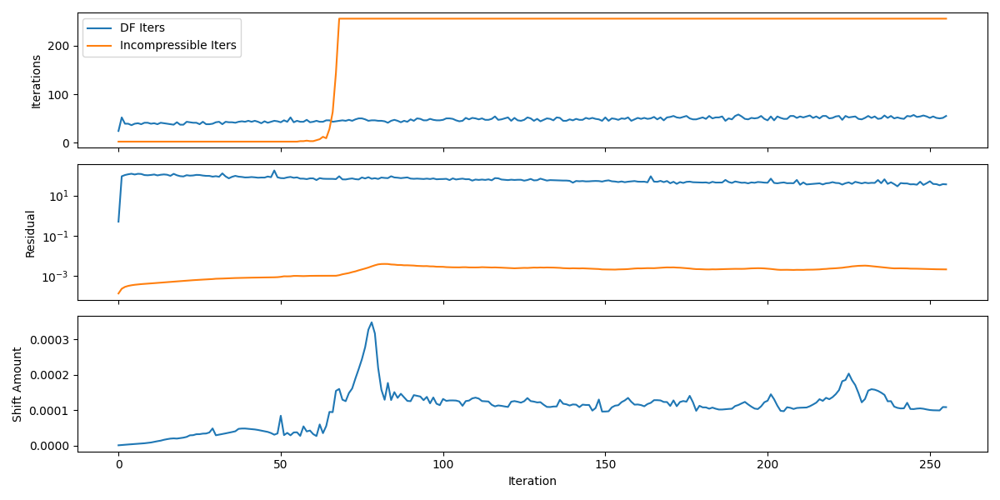

In [44]:
fig, axis = plt.subplots(3, 1, figsize=(12, 6), squeeze=False, sharex=True)

axis[0,0].plot([s['divergenceFreeIters'] for s in stats], label='DF Iters')
axis[0,0].plot([s['incompressibleIters'] for s in stats], label='Incompressible Iters')

axis[1,0].plot([s['divergenceFreeConvergence'][-1].cpu() for s in stats], label='DF Convergence')
axis[1,0].plot([s['incompressibleConvergence'][-1] for s in stats], label='Incompressible Convergence')
axis[1,0].set_yscale('log')

axis[2,0].plot([s.cpu().abs().mean() for s in shiftAmount], label='Shift Amount')

axis[0,0].legend()

# axis[0,0].set_title('Iterations')
# axis[1,0].set_title('Convergence')
# axis[2,0].set_title('Shift Amount')

axis[0,0].set_ylabel('Iterations')
axis[1,0].set_ylabel('Residual')
axis[2,0].set_ylabel('Shift Amount')
axis[2,0].set_xlabel('Iteration')

fig.tight_layout()

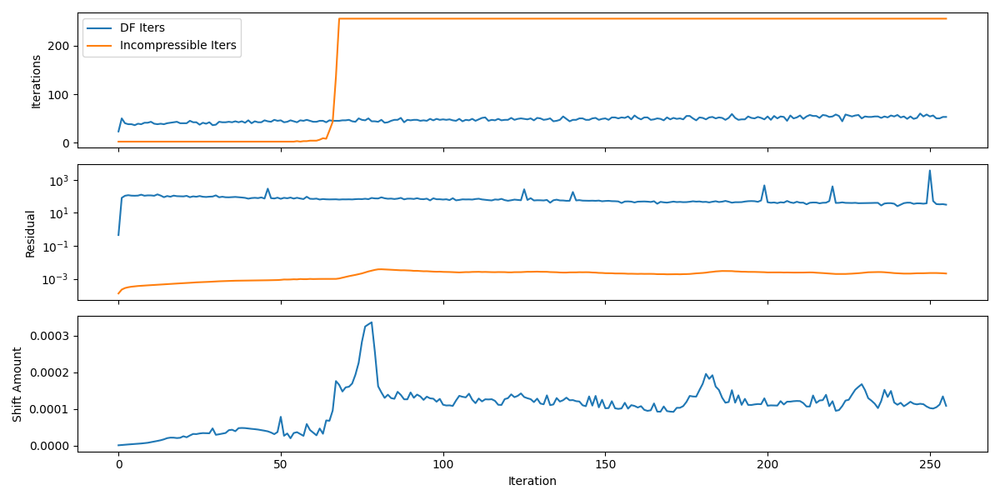

In [21]:
fig, axis = plt.subplots(3, 1, figsize=(12, 6), squeeze=False, sharex=True)

axis[0,0].plot([s['divergenceFreeIters'] for s in stats], label='DF Iters')
axis[0,0].plot([s['incompressibleIters'] for s in stats], label='Incompressible Iters')

axis[1,0].plot([s['divergenceFreeConvergence'][-1].cpu() for s in stats], label='DF Convergence')
axis[1,0].plot([s['incompressibleConvergence'][-1] for s in stats], label='Incompressible Convergence')
axis[1,0].set_yscale('log')

axis[2,0].plot([s.cpu().abs().mean() for s in shiftAmount], label='Shift Amount')

axis[0,0].legend()

# axis[0,0].set_title('Iterations')
# axis[1,0].set_title('Convergence')
# axis[2,0].set_title('Shift Amount')

axis[0,0].set_ylabel('Iterations')
axis[1,0].set_ylabel('Residual')
axis[2,0].set_ylabel('Shift Amount')
axis[2,0].set_xlabel('Iteration')

fig.tight_layout()

In [20]:
frameStats['divergenceFreeConvergence']

[[tensor([ 235.3210,  355.4466,  602.2260,  ...,  139.5992, -173.5840,
          -261.7203], device='cuda:0'),
  tensor(55988.7773, device='cuda:0')],
 [tensor([ 172.2051,  480.8789,  765.7527,  ...,  110.7976, -173.0825,
          -269.9815], device='cuda:0'),
  tensor(36177.4961, device='cuda:0')],
 [tensor([ 279.9891,  607.4714,  938.3116,  ...,  178.7201, -145.1418,
          -259.6274], device='cuda:0'),
  tensor(30636.4414, device='cuda:0')],
 [tensor([ 342.7804,  614.0280,  939.3553,  ...,  183.8299, -158.0054,
          -233.6120], device='cuda:0'),
  tensor(24206.1367, device='cuda:0')],
 [tensor([ 296.3205,  592.4900,  880.7759,  ...,  231.6914, -139.5986,
          -238.4921], device='cuda:0'),
  tensor(19627.7148, device='cuda:0')],
 [tensor([ 285.7123,  539.7936,  825.8971,  ...,  248.5189, -116.3833,
          -218.9813], device='cuda:0'),
  tensor(16110.5166, device='cuda:0')],
 [tensor([ 260.2298,  508.0094,  797.1257,  ...,  300.9676,  -40.9751,
          -192.7732], d

In [21]:
solverState['dt']

0.001

In [22]:
searchNeighbors(solverState, config)

# Advection Step
solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

# Divergence-Free Solver Preparation
solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
# Could also use actual density here
rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

# Solve Divergence-Free PPE
pressure_star, iters, residuals, convergence, B, accel_p_star, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])


DF:  0 -> 0.6965193152427673, pressure mean: +3.9062e-03, pressure accel mean: +0.0000e+00 pressure: -9535220.0 12687185.0
DF:  1 -> 0.660237193107605, pressure mean: -1.7578e-02, pressure accel mean: +4.0296e+04 pressure: -8747501.0 13219954.0
DF:  2 -> 0.8072827458381653, pressure mean: +2.9297e-03, pressure accel mean: +2.5904e+04 pressure: -13044974.0 19487046.0
DF:  3 -> 1.0893232822418213, pressure mean: +1.1719e-02, pressure accel mean: +5.2291e+04 pressure: -13380077.0 18064660.0
DF:  4 -> 1.5255898237228394, pressure mean: -3.1250e-02, pressure accel mean: +4.3919e+04 pressure: -17407966.0 25502080.0
DF:  5 -> 2.169219493865967, pressure mean: -1.9531e-02, pressure accel mean: +8.0274e+04 pressure: -20484870.0 20523858.0
DF:  6 -> 3.122069835662842, pressure mean: -2.5391e-02, pressure accel mean: +8.6257e+04 pressure: -25397548.0 33229808.0
DF:  7 -> 4.522059440612793, pressure mean: +5.8594e-03, pressure accel mean: +1.4504e+05 pressure: -31277960.0 34053272.0
DF:  8 -> 6.58

In [23]:
solverState['fluid']['advectionDivergence'].max()

tensor(5.6445, device='cuda:0')

In [24]:
solverState['dt'] = 0.001
searchNeighbors(solverState, config)
solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

# Divergence-Free Solver Preparation
solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
# Could also use actual density here
rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

# Solve Divergence-Free PPE

pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
iters = len(convergence)
print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation='gradient', gradientMode='summation', neighborhood=solverState['fluid']['neighborhood'])
accel_p_star = -gradp_star / rho.view(-1, 1)
print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')

Divergence-free convergence after 68 iterations: 128.22552490234375
Pressure Stats: 6298.13330078125 | -11604.1240234375 | -1.52587890625e-05
Pressure Acceleration: 102.91073608398438 | -117.56504821777344 | 0.00019657611846923828


In [25]:
B

tensor([-157.6619, -155.6322, -794.4385,  ...,  268.4931, 1114.0935,
        1263.3298], device='cuda:0')

In [26]:
config['shifting']['scheme'] = 'IPS'
config['shifting']['maxIterations'] = 1
config['shifting']['summationDensity'] = True
config['shifting']['threshold'] = 0.1

In [27]:
# newState = copy.deepcopy(solverState)
# newState['fluid']['areas'] *= config['particle']['dx']
# newState['fluid']['masses'] *= config['particle']['dx']


p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])

DF:  0 -> 0.6965193152427673, pressure mean: +3.9062e-03, pressure accel mean: +0.0000e+00 pressure: -9535218.0 12687185.0
DF:  1 -> 0.660237193107605, pressure mean: -1.7578e-02, pressure accel mean: +4.0296e+04 pressure: -8747497.0 13219958.0
DF:  2 -> 0.8072828054428101, pressure mean: -7.8125e-03, pressure accel mean: +2.5904e+04 pressure: -13044983.0 19487046.0
DF:  3 -> 1.0893231630325317, pressure mean: +7.8125e-03, pressure accel mean: +5.2291e+04 pressure: -13380076.0 18064670.0
DF:  4 -> 1.5255898237228394, pressure mean: -4.6875e-02, pressure accel mean: +4.3919e+04 pressure: -17407944.0 25502072.0
DF:  5 -> 2.1692192554473877, pressure mean: -1.5625e-02, pressure accel mean: +8.0274e+04 pressure: -20484872.0 20523872.0
DF:  6 -> 3.122070074081421, pressure mean: -1.5625e-02, pressure accel mean: +8.6257e+04 pressure: -25397554.0 33229780.0
DF:  7 -> 4.522059917449951, pressure mean: -1.3672e-02, pressure accel mean: +1.4504e+05 pressure: -31277962.0 34053292.0
DF:  8 -> 6.5

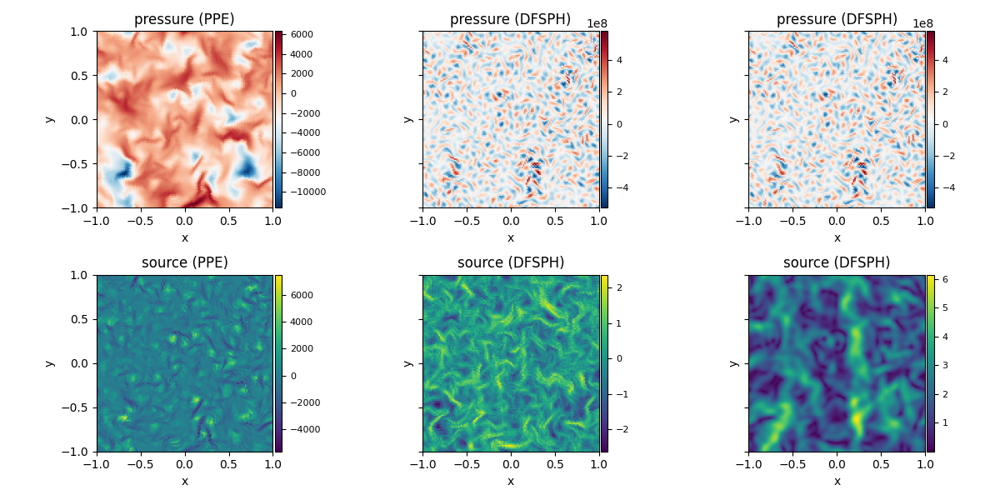

In [28]:


fig, axis = plt.subplots(2,3, figsize = (12,6), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(newState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
# div = computeDivergence(incompressibleState['fluid'], incompressibleState['fluid'], incompressibleState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      pressure_star - pressure_star.mean(),
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', title = 'pressure (PPE)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      p_starstar - p_starstar.mean(),
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)
rhoPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      (p_starstar - p_starstar.mean()) - (pressure_star - pressure_star.mean()),
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)


velPlot = visualizeParticleQuantity(fig, axis[1,0], config, visualizationState, quantity = 
                                      # (initialDensity - config['fluid']['rho0']) / config['fluid']['rho0'],
                                    #   (incompressibleState['fluid']['densities'] - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                    B,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = 'source (PPE)', plotBoth = False, which = 'fluid', midPoint = 0)


velPlot = visualizeParticleQuantity(fig, axis[1,1], config, visualizationState, quantity = 
                                      (solverState['fluid']['densities'] - config['fluid']['rho0']),#.abs() / config['fluid']['rho0'],
                                      # sourceTerm * config['fluid']['rho0'],
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = 'source (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)

velPlot = visualizeParticleQuantity(fig, axis[1,2], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = 'source (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)
                                    


fig.tight_layout()

In [153]:
config['particle']['dx'] * 2

tensor(0.0312, device='cuda:0')

In [154]:
solverState['fluid']['supports'] / config['kernel']['kernelScale']

tensor([0.0312, 0.0312, 0.0312,  ..., 0.0312, 0.0312, 0.0312], device='cuda:0')

In [155]:
p_starstar / pressure_star

tensor([ -577221.8750, -2584675.7500,   912893.8125,  ...,
          225278.2812,   191363.0469,   125807.1406], device='cuda:0')

In [156]:
alpha# * solverState['dt'] * config['fluid']['rho0']**4

tensor([-2.9644e-07, -2.9680e-07, -2.9407e-07,  ..., -2.9550e-07,
        -2.9533e-07, -2.9650e-07], device='cuda:0')

In [157]:
A[0][A[1][0] == A[1][1]]

tensor([-6.6002, -6.5987, -6.6069,  ..., -6.6030, -6.6035, -6.5990],
       device='cuda:0')

In [158]:
alpha / A[0][A[1][0] == A[1][1]]

tensor([4.4915e-08, 4.4979e-08, 4.4509e-08,  ..., 4.4753e-08, 4.4722e-08,
        4.4930e-08], device='cuda:0')

In [159]:
print(A[1][0], A[1][1], A[0][A[1][0] == 0])

tensor([    0,     0,     0,  ..., 16383, 16383, 16383], device='cuda:0') tensor([  252,   381, 16381,  ..., 16131, 16258, 16259], device='cuda:0') tensor([ 1.4777e-06,  7.7471e-05,  1.0366e-04,  5.1015e-08,  1.8289e-05,
         4.0469e-03,  1.0107e-02,  1.8424e-02,  4.1817e-04, -6.6002e+00,
         7.2445e-01,  5.4518e-03,  1.5180e-01,  7.1770e-01,  6.7272e-01,
         2.6053e-01,  1.4812e-02,  2.0615e-01,  5.6335e-01,  2.9446e-02,
         1.2229e-01,  1.1284e-01,  1.8413e-01,  1.3830e-03,  3.4607e-02,
         6.1950e-01,  6.6072e-01,  3.2523e-02,  2.6137e-01,  1.5603e-01,
         3.8926e-02,  1.8650e-04,  1.0018e-02,  1.9595e-03,  1.8287e-04,
         5.3528e-03,  1.4378e-06,  1.0955e-11,  4.5026e-05,  9.6921e-06,
         8.1931e-03,  2.3451e-01,  1.0554e-01,  1.3713e-02,  4.0360e-05,
         3.2379e-02,  5.3327e-04,  1.5613e-01,  3.5089e-02,  6.9432e-04,
         6.2876e-11,  3.1813e-01,  4.0505e-02,  4.7010e-03,  6.6853e-07,
         2.7562e-02,  3.7493e-04,  3.1725e-04,  9

In [160]:
config['fluid']['rho0'] * solverState['dt']

1.0

In [161]:
config['shifting']

{'scheme': 'IPS',
 'threshold': 0.1,
 'maxIterations': 1,
 'freeSurface': False,
 'R': 0.25,
 'n': 4,
 'CFL': 1.5,
 'computeMach': True,
 'solver': 'BiCGStab_wJacobi',
 'normalScheme': 'lambda',
 'projectionScheme': 'mat',
 'surfaceScaling': 0.1,
 'summationDensity': True,
 'useExtendedMask': False,
 'initialization': 'zero',
 'maxSolveIter': 64,
 'surfaceDetection': 'Barcasco',
 'active': True}

In [162]:
config['shifting']['summationDensity'] = False
config['shifting']['threshold'] = 1

In [163]:
incompressibleState = copy.deepcopy(initialState)
incompressibleState['dt'] = 0.001
incompressibleState['fluid']['positions'] += 0.01 * torch.randn_like(incompressibleState['fluid']['positions'])

searchNeighbors(incompressibleState, config)
incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
initialDensity = incompressibleState['fluid']['densities'].clone()
incompressibleState['fluid']['advection'] = torch.zeros_like(incompressibleState['fluid']['velocities'])
incompressibleState['fluid']['velocities'] = torch.zeros_like(incompressibleState['fluid']['velocities'])

for i in tqdm(range(16)):
    searchNeighbors(incompressibleState, config)
    # incompressibleState['fluid']['densities'] = config['fluid']['rho0'] * torch.ones_like(incompressibleState['fluid']['densities'])
    incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
    dx, _ = solveShifting(incompressibleState, config)

    incompressibleState['fluid']['positions'] += dx * 0.5
    searchNeighbors(incompressibleState, config)

    incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
    rho = incompressibleState['fluid']['densities']

    p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel = solveIncompressible_relaxedJacobi(incompressibleState['fluid'], incompressibleState['fluid'], config, incompressibleState['dt'], neighborhood=incompressibleState['fluid']['neighborhood'])

    # gradp_starstar = sphOperationStates(incompressibleState['fluid'], incompressibleState['fluid'], (p_starstar, p_starstar), operation='gradient', gradientMode='symmetric', neighborhood= incompressibleState['fluid']['neighborhood']) 
    # particleShift = -incompressibleState['dt'] ** 2  * gradp_starstar / config['fluid']['rho0'] # rho.view(-1, 1)
    # particleShift = -incompressibleState['dt'] ** 2  * gradp_starstar / rho.view(-1, 1)
    particleShift = incompressibleState['dt'] **2 * pressureAccel

    incompressibleState['fluid']['pressureIncompressible'] = p_starstar #* 0.
    incompressibleState['fluid']['positions'] += particleShift
    # dx, states = solveShifting(incompressibleState, config)
    # incompressibleState['fluid']['positions'] += dx
    incompressibleState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * incompressibleState['fluid']['positions'][:,0]) * torch.sin(k * incompressibleState['fluid']['positions'][:,1])
    incompressibleState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * incompressibleState['fluid']['positions'][:,0]) * torch.cos(k * incompressibleState['fluid']['positions'][:,1])
    incompressibleState['fluid']['velocities'] = torch.zeros_like(incompressibleState['fluid']['velocities'])

    print(f'Error: {errors[0]} -> {errors[-1]}' , f'Pressure: {pressures[-1]}', f'Iterations: {iters_inc}, Density {(rho - config["fluid"]["rho0"]).abs().mean() / config["fluid"]["rho0"]}')




searchNeighbors(incompressibleState, config)
incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')

print(pressures)


  0%|          | 0/16 [00:00<?, ?it/s]

Initial Density: 377.089599609375 | -280.4896240234375 | 71.53137969970703
Predicted Density: 377.089599609375 | -280.4896240234375 | 71.53137969970703
Source Term: 0.2804896831512451 | -0.37708961963653564 | 0.07153137028217316
Advection Divergence: 0.0 | 0.0 | 0.0
	PS:  0 -> +7.1531e-02, pressure mean: +1.8881e+04, pressure accel mean: +0.0000e+00, pressure min: -123031.3828125 max: 341383.0
	PS:  1 -> +3.1256e-02, pressure mean: +2.6089e+04, pressure accel mean: +1.5759e+03, pressure min: -197153.796875 max: 419845.71875
	PS:  2 -> +2.2373e-02, pressure mean: +3.0068e+04, pressure accel mean: +1.9576e+03, pressure min: -258639.796875 max: 478049.59375
	PS:  3 -> +1.8428e-02, pressure mean: +3.2487e+04, pressure accel mean: +2.1409e+03, pressure min: -303236.3125 max: 524307.5625
	PS:  4 -> +1.6180e-02, pressure mean: +3.3987e+04, pressure accel mean: +2.2519e+03, pressure min: -335349.59375 max: 564856.4375
	PS:  5 -> +1.4700e-02, pressure mean: +3.4882e+04, pressure accel mean: +2.

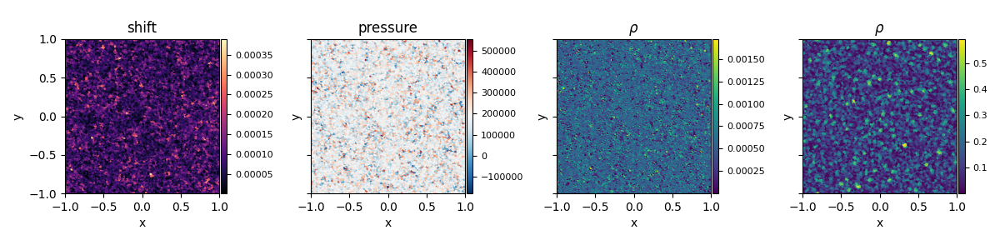

In [164]:
fig, axis = plt.subplots(1,4, figsize = (12,3), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(incompressibleState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(incompressibleState['fluid'], incompressibleState['fluid'], incompressibleState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      dx,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'magma', title = 'shift', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      p_starstar,
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      # (initialDensity - config['fluid']['rho0']) / config['fluid']['rho0'],
                                      (incompressibleState['fluid']['densities'] - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      (initialDensity - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      # sourceTerm,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)



fig.tight_layout()

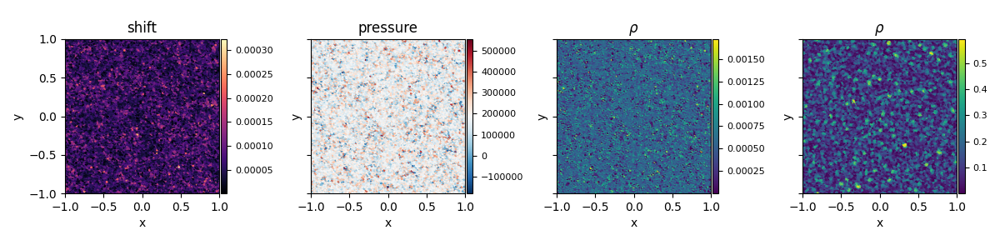

In [165]:
fig, axis = plt.subplots(1,4, figsize = (12,3), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(incompressibleState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(incompressibleState['fluid'], incompressibleState['fluid'], incompressibleState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      particleShift,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'magma', title = 'shift', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      p_starstar,
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      # (initialDensity - config['fluid']['rho0']) / config['fluid']['rho0'],
                                      (incompressibleState['fluid']['densities'] - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      (initialDensity - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      # sourceTerm,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)



fig.tight_layout()

In [167]:

# def simulationStep(solverState, config):
#     searchNeighbors(solverState, config)

#     print(f'Start of simulation step')

#     # Advection Step
#     solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
#     solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
#     solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

#     # Divergence-Free Solver Preparation
#     solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
#     # solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
#     # solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
#     # solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
#     # solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

#     print(f'Density: {solverState["fluid"]["densities"].max()} | {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].mean()}')
#     print(f'Gravity: {solverState["fluid"]["gravityAccel"].max()} | {solverState["fluid"]["gravityAccel"].min()} | {solverState["fluid"]["gravityAccel"].mean()}')
#     print(f'Viscosity: {solverState["fluid"]["velocityDiffusion"].max()} | {solverState["fluid"]["velocityDiffusion"].min()} | {solverState["fluid"]["velocityDiffusion"].mean()}')
#     print(f'Advection: {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).max()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).min()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).mean()}')
    
#     v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
#     # Could also use actual density here
#     # rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

#     # Solve Divergence-Free PPE
#     pressure_star, iters, residuals, convergence, B, accel_p_star, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])



#     # pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
#     # iters = len(convergence)
#     # print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
#     # print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

#     # gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation='gradient', gradientMode='summation', neighborhood=solverState['fluid']['neighborhood'])
#     # accel_p_star = -gradp_star / rho.view(-1, 1)
#     # print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')
#     solverState['fluid']['pressure'] = pressure_star
#     solverState['fluid']['pressureAcceleration'] = -accel_p_star

#     print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')
#     print(f'Pressure Acceleration {torch.linalg.norm(accel_p_star, dim = -1).max()} | {torch.linalg.norm(accel_p_star, dim = -1).min()} | {torch.linalg.norm(accel_p_star, dim = -1).mean()}')
          
#     ## Check for proper convergence behavior
#     # initialDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['velocities'], solverState['fluid']['velocities']), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'], gradientMode='difference')
#     # advectionDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_star, v_star), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

#     # print(f'Initial Divergence : {initialDivergence.min()} | {initialDivergence.max()} | {initialDivergence.mean()}')
#     # print(f'Divergence after DF: {advectionDivergence.min()} | {advectionDivergence.max()} | {advectionDivergence.mean()}')
#     v_prime = v_star + accel_p_star * solverState['dt']  # / 10**3 

#     # finalVelocities = v_prime
#     # finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt']

#     # solverState['fluid']['divergenceFreeVelocities'] = v_prime
#     # accel_p_star = accel_p_star * 0

#     ## Prepare incompressible PPE
#     # v_prime = v_star + accel_p_star * solverState['dt']  # / 10**3 
#     # solvedDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

#     solverState['fluid']['advection'] += accel_p_star# * solverState['dt']

#     ## Solve Incompressible PPE
#     # for i in range(1):
#         # searchNeighbors(solverState, config)
#         # solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
#         # if i > 0:
#         #     solverState['fluid']['advection'][:,0] = 0
#         #     solverState['fluid']['advection'][:,1] = 0
#         #     v_prime = finalVelocities

#     # solverState['fluid']['positions'] = solverState['fluid']['positions'] + solverState['dt'] * v_prime
#     # solverState['fluid']['velocities'] = v_prime
#     # solverState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])
#     # searchNeighbors(solverState, config)

#     p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel = solveIncompressible_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])
#     # print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
#     solverState['fluid']['pressureIncompressible'] = p_starstar
    
#     print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
#     print(f'Pressure Acceleration {torch.linalg.norm(pressureAccel, dim = -1).max()} | {torch.linalg.norm(pressureAccel, dim = -1).min()} | {torch.linalg.norm(pressureAccel, dim = -1).mean()}')

#     # gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation='gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 
#     # particleShift = -solverState['dt'] ** 2  * gradp_starstar / rho.view(-1, 1)
#     particleShift = solverState['dt'] **2 * pressureAccel
#     gradV = -sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation='gradient', gradientMode='difference', neighborhood=solverState['fluid']['neighborhood'])
#     # print(f'particleShift: {particleShift.max()} | {particleShift.min()} | {particleShift.mean()}')

#     # Project velocities
#     projectedVelocity = v_prime - torch.bmm(gradV.mT, particleShift.unsqueeze(-1)).squeeze(-1)
#     finalVelocities = projectedVelocity

#     print(f'Projected Velocity: {projectedVelocity.max()} | {projectedVelocity.min()} | {projectedVelocity.mean()}')
#     # finalVelocities = v_prime
#     # if i == 0:
    
#     finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt'] + particleShift
#     # finalPositions = solverState['fluid']['positions'] + particleShift
#     # else:
#         # finalPositions += particleShift
#     # solverState['fluid']['particleShift'] = particleShift
#     # solverState['fluid']['projectedVelocities'] = projectedVelocity
#     # print(solverState['dt'])
#     solverState['fluid']['velocities'] = finalVelocities
#     # solverState['fluid']['positions'] += finalVelocities * solverState['dt']#+ a_pi* solverState['dt']**2
#     solverState['fluid']['positions'] = finalPositions

#     finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

#     frameStats = {
#         # 'initialDivergence': initialDivergence,
#         # 'advectionDivergence': advectionDivergence,
#         # 'solvedDivergence': solvedDivergence,
#         'finalDivergence': finalDivergence,

#         'divergenceFreeIters': iters,
#         'divergenceFreeConvgerence': residuals,
#         'divergenceFreeResiduals': residuals,
#         'divergenceFreePressure': pressure_star,
#         'divergenceFreeSourceTerm': B,
        
#         'incompressibleIters': iters_inc,
#         'incompressibleConvergence': errors,
#         'incompressiblePressures': pressures,
#         'incompressibleSourceTerm': sourceTerm
#     }

#     return solverState, frameStats

In [193]:
initialState['dt']

tensor(0.0005, device='cuda:0')

In [137]:
solverState = copy.deepcopy(initialState)
solverState['dt'] = 0.001
for i in range(16):
    solverState, frameStats = simulationStep(solverState, config)
    dx, _ = solveShifting(solverState, config)
    solverState['fluid']['positions'] += 0.5 *  dx
# solverState, frameStats = simulationStep(solverState, config)
# solverState, frameStats = simulationStep(solverState, config)

  0	Div:  22 |    0.5, PS:   2 | 9.8845e-05, rho: -0.3602 | 0.0009766 | 0.3832
  0	Div:  47 |   75.4, PS:   2 | 1.3294e-04, rho: -0.5361 | 0.003723 | 0.4921
  0	Div:  41 |  105.7, PS:   2 | 1.3772e-04, rho: -0.5939 | 0.007935 | 0.4741
  0	Div:  41 |  116.8, PS:   2 | 1.3850e-04, rho: -0.6118 | 0.01343 | 0.4504
  0	Div:  39 |  117.6, PS:   2 | 1.4020e-04, rho: -0.6199 | 0.0199 | 0.4406
  0	Div:  39 |  117.9, PS:   2 | 1.4278e-04, rho: -0.619 | 0.0271 | 0.4415
  0	Div:  38 |  124.5, PS:   2 | 1.4563e-04, rho: -0.6181 | 0.0351 | 0.455
  0	Div:  39 |  116.0, PS:   2 | 1.4833e-04, rho: -0.624 | 0.0437 | 0.4753
  0	Div:  38 |  120.2, PS:   2 | 1.5079e-04, rho: -0.6299 | 0.05298 | 0.505
  0	Div:  38 |  116.3, PS:   2 | 1.5305e-04, rho: -0.6345 | 0.06323 | 0.5414
  0	Div:  37 |  114.0, PS:   2 | 1.5524e-04, rho: -0.6387 | 0.07434 | 0.5789
  0	Div:  37 |  102.4, PS:   2 | 1.5743e-04, rho: -0.6423 | 0.08649 | 0.6153
  0	Div:  41 |  108.5, PS:   2 | 1.5960e-04, rho: -0.6435 | 0.09979 | 0.6484
  0

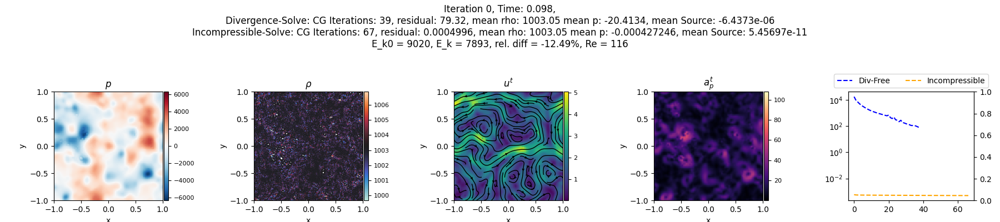

In [172]:
fig, axis = plt.subplots(1,5, figsize = (18,4), squeeze = False)

if 'pressure' not in solverState['fluid']:
    solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])
if 'pressureIncompressible' not in solverState['fluid']:
    solverState['fluid']['pressureIncompressible'] = torch.zeros_like(solverState['fluid']['densities'])

visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'densities',
                                      mapping = '.x', s = s, 
                          scaling = 'RdBu', gridVisualization=False, cmap = 'icefire', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 1000)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'velocities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'viridis', streamLines = True, operation = None, title = '$u^t$', plotBoth = False, which = 'fluid', midPoint = 0)

accelPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                     'advection' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'magma', streamLines = False, operation = None, title = '$a_p^t$', plotBoth = False, which = 'fluid', midPoint = 0)


# pressure, iters, convergence, residuals, A, B, M_coo = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
# inc_pressure, iters_inc, convergence_inc, residuals_inc, A_inc, B_inc, M_coo_inc = solveIncompressible(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
# iters_inc = len(convergence_inc)
# iters = len(convergence)

pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'pressure',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu_r', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)

# print(f'Convergence: {convergence} ')
convergence = frameStats['divergenceFreeConvergence']
errors = frameStats['incompressibleConvergence']
pressures = frameStats['incompressiblePressures']


# axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
# axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence_inc_torch], label = 'Incompressible', ls = '--', color = 'orange')
axis[0,4].semilogy([c.detach().cpu().item() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
axis[0,4].legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), ncol = 2)


axResidual = axis[0,4].twinx()
# axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
# axResidual.semilogy([c for c in pressures], label = 'Div-Free', color = 'blue')
# axResidual.semilogy([c for c in pressures], label = 'Pressure Incompressible', color = 'orange')
# axResidual.semilogy(pressures[-1], label = 'Pressure Incompressible', color = 'orange')

initialVelocities = initialState['fluid']['velocities'].clone()
currentVelocities = solverState['fluid']['velocities'].clone()

time = solverState['time']

areas = solverState['fluid']['areas']
densities = solverState['fluid']['densities']
rho0 = config['fluid']['rho0']

E_k0 =  (0.5 * areas * rho0 * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()

E_k = (0.5 * torch.sum(areas * densities * torch.linalg.norm(currentVelocities, dim = 1)**2)).sum().detach().cpu().numpy()

nu_total = np.log(E_k / E_k0) / (-4 *  time * k**2 )
Re = u_mag * 2 / nu_total


# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {iters}, residual: {convergence_torch[-1][-1]if len(convergence_torch) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {B.mean():.6g}
# Incompressible-Solve: CG Iterations: {iters_inc}, residual: {convergence_inc_torch[-1][-1] if len(convergence_inc_torch) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {B_inc.mean():.6g}''')
# print(convergence)

# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
# Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
# E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')
fig.tight_layout()

In [174]:
solverState = copy.deepcopy(initialState)
solverState['fluid']['positions'] += torch.normal(0, 0.001, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)
config["simulation"]["timestamp"] = datetime.datetime.now().strftime("%Y_%m_%d-%H_%M_%S")

# solverState['fluid']['velocities'][:,0] = torch.sin(2 * np.pi * solverState['fluid']['positions'][:,0])
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['velocities'][:,0] = 0
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['positions'] += torch.normal(0, 0.0005, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)


solverState['dt'] = 0.001
config['timestep']['dt'] = solverState['dt']

# searchNeighbors(solverState, config)
convergence = []

# def callback(x):
    # convergence.append(torch.linalg.norm(matvec_sparse_coo(A_sp, x) - rhs))

solverState = copy.deepcopy(initialState)
solverState['dt'] = 0.001
for i in (t:= tqdm(range(4096))):
    solverState, frameStats = simulationStep(solverState, config)
    dx, _ = solveShifting(solverState, config)
    solverState['fluid']['positions'] += 1.0 *  dx
# solverState, frameStats = simulationStep(solverState, config)
# solverState, frameStats = simulationStep(solverState, config)

# solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])
# for i in (t := tqdm(range(1024))):
    # solverState, frameStats = simulationStep(solverState, config)

    # searchNeighbors(solverState, config)
    # config['shifting']['summationDensity'] = False
    # config['shifting']['threshold'] = 1
    # incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
    # dx, _ = solveShifting(incompressibleState, config)

    # incompressibleState['fluid']['positions'] += dx * 0.5

    convergence = frameStats['divergenceFreeConvergence']
    errors = frameStats['incompressibleConvergence']
    pressures = frameStats['incompressiblePressures']
    pressuresdf = frameStats['divergenceFreePressure']

    if i%16 == 0:
        visualizationState = prepVisualizationState(solverState, config, grid = True)
    # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(pressurePlot, visualizationState, 'pressure')
        updatePlot(rhoPlot, visualizationState, 'densities')
        updatePlot(velPlot, visualizationState, 'velocities')
        updatePlot(accelPlot, visualizationState, 'pressureAcceleration')
        if len(convergence) > 0:
            # fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            # Divergence-Solve: CG Iterations: {iters}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {pressure_star.mean():.6g}, mean Source: {B.mean():.6g}
            # Incompressible-Solve: CG Iterations: {iters_inc}, residual: {convergence_inc[-1][-1] if len(convergence_inc) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {p_starstar.mean():.6g}, mean Source: {B_inc.mean():.6g}''')
            currentVelocities = solverState['fluid']['velocities'].clone()
            time = solverState['time']
            E_k = (0.5 * torch.sum(areas * densities * torch.linalg.norm(currentVelocities, dim = 1)**2)).sum().detach().cpu().numpy()
            nu_total = np.log(E_k / E_k0) / (-4 *  time * k**2 )
            Re = u_mag * 2 / nu_total

                        
            # fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            # Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
            # Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
            # E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

            fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
            Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
            E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

            axis[0,4].cla()
                        
            axis[0,4].semilogy([c.detach().cpu().item() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
            axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
            # axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
            # axis[0,4].semilogy([c.detach().cpu().numpy().mean() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')

            # axis[0,4].semilogy(convergence, label = 'Div-Free', ls = '--', color = 'blue')
            # axis[0,4].semilogy([c for c in errors], label = 'Incompressible', ls = '--', color = 'orange')
            # axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
            
            axis[0,4].legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), ncol = 2)

            # axResidual = axis[0,4].twinx()
            # axResidual.cla()
            # axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
            # axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
            # axResidual.semilogy([c.cpu() for c in pressuresdf], label = 'Pressure DF', color = 'blue')
            # axResidual.semilogy([c for c in pressures], label = 'Pressure Incompressible', color = 'orange')
            # axResidual.semilogy([np.abs(c[0]).max() for c in convergence_inc], label = 'Pressure Incompressible', color = 'orange')


        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(solverState, config, fig)

    # solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
    # solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])
    solverState['time'] += solverState['dt']
    solverState['timestep'] += 1
    t.set_description(f'Iteration: {i}, Divergence: {convergence[-1] if len(convergence) > 0 else 0.0:.4g} [{len(convergence)}], Incompressible: {errors[-1] if len(errors) > 0 else 0.0:.4g} [{len(errors)}]')
    # t.set_description(f'Iteration: {i}, Divergence: {convergence[-1][-1] if len(convergence) > 0 else 0.0:.4g} [{len(convergence)}], Incompressible: {errors[-1] if len(errors) > 0 else 0.0:.4g} [{len(errors)}]')




    # print(f'Iteration: {i}, Divergence: {div.min()} | {div.max()}, Pressure: {solverState["fluid"]["pressure"].min()} | {solverState["fluid"]["pressure"].max()}, densities: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()}')


  0%|          | 0/4096 [00:00<?, ?it/s]

  0	Div:  21 |    0.5, PS:   2 | 9.8845e-05, rho: -0.3602 | 0.0009766 | 0.3834
  1	Div:  49 |   53.7, PS:   2 | 1.3260e-04, rho: -0.5378 | 0.003723 | 0.493
  2	Div:  40 |  107.9, PS:   2 | 1.3735e-04, rho: -0.5966 | 0.007935 | 0.4774
  3	Div:  39 |  117.4, PS:   2 | 1.3839e-04, rho: -0.6126 | 0.01337 | 0.4576
  4	Div:  38 |  111.7, PS:   2 | 1.4049e-04, rho: -0.6199 | 0.01984 | 0.449
  5	Div:  39 |  117.8, PS:   2 | 1.4342e-04, rho: -0.6219 | 0.02704 | 0.4529
  6	Div:  39 |   98.3, PS:   2 | 1.4660e-04, rho: -0.6223 | 0.03491 | 0.4632
  7	Div:  37 |  131.4, PS:   2 | 1.4966e-04, rho: -0.6252 | 0.04346 | 0.4896
  8	Div:  35 |  111.9, PS:   2 | 1.5261e-04, rho: -0.6315 | 0.05273 | 0.524
  9	Div:  39 |  113.8, PS:   2 | 1.5540e-04, rho: -0.6399 | 0.06274 | 0.5659
 10	Div:  39 |  103.6, PS:   2 | 1.5841e-04, rho: -0.6483 | 0.07367 | 0.6127
 11	Div:  38 |  187.3, PS:   2 | 1.6180e-04, rho: -0.647 | 0.08551 | 0.6547
 12	Div:  40 |   98.9, PS:   2 | 1.6566e-04, rho: -0.6566 | 0.09845 | 0.6924

KeyboardInterrupt: 

In [377]:
u_mag**2 * solverState['dt'] / solverState['fluid']['supports'].max()

tensor(0.0590, device='cuda:0')

In [376]:
u_mag

2

In [44]:
solverState = copy.deepcopy(initialState)
solverState['fluid']['positions'] += torch.normal(0, 0.0001, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)
config["simulation"]["timestamp"] = datetime.datetime.now().strftime("%Y_%m_%d-%H_%M_%S")

# solverState['fluid']['velocities'][:,0] = torch.sin(2 * np.pi * solverState['fluid']['positions'][:,0])
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['velocities'][:,0] = 0
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['positions'] += torch.normal(0, 0.0005, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)


solverState['dt'] = 1e-3
config['timestep']['dt'] = solverState['dt']

searchNeighbors(solverState, config)
convergence = []

# def callback(x):
    # convergence.append(torch.linalg.norm(matvec_sparse_coo(A_sp, x) - rhs))


solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])
for i in tqdm(range(1024)):
    print('#########################################################################')
    searchNeighbors(solverState, config)

    ## Advection Step
    solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

    ## Divergence-Free Solver Preparation
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key = 'advectionVelocities')


    v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    # Could also use actual density here
    rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)


    ## Solve Divergence-Free PPE
    pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
    iters = len(convergence)
    print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
    print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

    gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation = 'gradient', gradientMode='summation', neighborhood= solverState['fluid']['neighborhood'])
    accel_p_star = -gradp_star / rho.view(-1,1)
    print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')
    solverState['fluid']['pressure'] = pressure_star
          
    ## Check for proper convergence behavior
    initialDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['velocities'], solverState['fluid']['velocities']), operation = 'divergenceConsistent', neighborhood= solverState['fluid']['neighborhood'], gradientMode = 'difference')
    advectionDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_star, v_star), operation = 'divergenceConsistent', neighborhood= solverState['fluid']['neighborhood'])

    print(f'Initial Divergence : {initialDivergence.min()} | {initialDivergence.max()} | {initialDivergence.mean()}')
    print(f'Divergence after DF: {advectionDivergence.min()} | {advectionDivergence.max()} | {advectionDivergence.mean()}')
    v_prime = v_star + accel_p_star * solverState['dt'] #/ 10**3 
    finalVelocities = v_prime
    finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt']

    ## Prepare incompressible PPE
    v_prime = v_star + accel_p_star * solverState['dt'] #/ 10**3 
    solvedDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation = 'divergenceConsistent', neighborhood= solverState['fluid']['neighborhood'])

    ## Solve Incompressible PPE
    
    p_starstar, iters_inc, errors, pressures, sourceTerm = solveIncompressible_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])

# a_p = computePressureAcceleration(stateA, stateB, config, neighborhood, (pressureB, pressureB))
# shift = solverState['dt']**2 * a_p


    # p_starstar, iters_inc, convergence_inc, residuals_inc, A_inc, B_inc, (A_sp_inc, M_coo_inc, rhs_inc) = solveIncompressible(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'])
    # # iters_inc = len(convergence_inc)
    # print(f'Incompressible convergence after {iters_inc} iterations: {convergence_inc[-1][1] if len(convergence) > 0 else 0}')
    print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
    solverState['fluid']['pressureIncompressible'] = p_starstar

    gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 
    particleShift =  -solverState['dt'] **2  * gradp_starstar/ rho.view(-1,1)
    gradV = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation = 'gradient', gradientMode='difference', neighborhood=solverState['fluid']['neighborhood'])
    print(f'particleShift: {particleShift.max()} | {particleShift.min()} | {particleShift.mean()}')

    ## Project velocities
    projectedVelocity = v_prime + torch.bmm(gradV, particleShift.unsqueeze(-1)).squeeze(-1)
    finalVelocities = projectedVelocity
    # finalVelocities = v_prime
    finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt'] + particleShift

    # print(solverState['dt'])
    solverState['fluid']['velocities'] = finalVelocities
    # solverState['fluid']['positions'] += finalVelocities * solverState['dt']#+ a_pi* solverState['dt']**2
    solverState['fluid']['positions'] = finalPositions

    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

    # visualizationState = prepVisualizationState(perennialState, config)
    # div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
    if i%8 == 0:
        visualizationState = prepVisualizationState(solverState, config, grid = True)
    # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(pressurePlot, visualizationState, pressure_star)
        updatePlot(rhoPlot, visualizationState, 'densities')
        updatePlot(velPlot, visualizationState, finalVelocities)
        updatePlot(accelPlot, visualizationState, accel_p_star)
        if len(convergence) > 0:
            # fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            # Divergence-Solve: CG Iterations: {iters}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {pressure_star.mean():.6g}, mean Source: {B.mean():.6g}
            # Incompressible-Solve: CG Iterations: {iters_inc}, residual: {convergence_inc[-1][-1] if len(convergence_inc) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {p_starstar.mean():.6g}, mean Source: {B_inc.mean():.6g}''')


            fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            Divergence-Solve: CG Iterations: {iters}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {pressure_star.mean():.6g}, mean Source: {B.mean():.6g}
            Incompressible-Solve: CG Iterations: {iters_inc}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {p_starstar.mean():.6g}, mean Source: {sourceTerm.mean():.6g}''')
            axis[0,4].cla()
            
            axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
            # axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence_inc], label = 'Incompressible', ls = '--', color = 'orange')

            axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
            
            axis[0,4].legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), ncol = 2)

            # axResidual = axis[0,4].twinx()
            axResidual.cla()
            axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
            axResidual.semilogy([c for c in pressures], label = 'Pressure Incompressible', color = 'orange')
            # axResidual.semilogy([np.abs(c[0]).max() for c in convergence_inc], label = 'Pressure Incompressible', color = 'orange')


        fig.canvas.draw()
        fig.canvas.flush_events()
        # exportPlot(solverState, config, fig)
    solverState['time'] += perennialState['dt']
    solverState['timestep'] += 1

    # print(iters)
    # print(f'Density Error: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()} | {solverState["fluid"]["densities"].mean()} -> {rho.min()} | {rho.max()} | {rho.mean()}')
    # print(f'Initial Error: {initDiv.min()} | {initDiv.max()} | {initDiv.mean()}')
    # print(f'Approximation error: {approx.min()} | {approx.max()} | {approx.mean()}')
    # print(f'Solution Error: {finalDiv.min()} | {finalDiv.max()} | {finalDiv.mean()}')
    # print(f'Relative Error: {rel.min()} | {rel.max()} | {rel.mean()}')


    print(f'Iteration: {i}, Divergence: {div.min()} | {div.max()}, Pressure: {solverState["fluid"]["pressure"].min()} | {solverState["fluid"]["pressure"].max()}, densities: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()}')

# print(f'Initial Divergence:   {initDiv.min()} | {initDiv.max()} | {initDiv.mean()} | {initDiv}')
# print(f'Advection Divergence: {advDiv.min()} | {advDiv.max()} | {advDiv.mean()} | {advDiv}')
# print(f'Accel Divergence:     {accDiv.min()} | {accDiv.max()} | {accDiv.mean()} | {accDiv}')
# print(f'Final Divergence:     {finalDiv.min()} | {finalDiv.max()} | {finalDiv.mean()} | {finalDiv}')
# print(f'Residual:             {(advDiv - accDiv).min()} | {(advDiv - accDiv).max()} | {(advDiv - accDiv).mean()} | {(advDiv - accDiv)}')

# ratio = initDiv / accDiv
# print(f'Ratio: {ratio.min()} | {ratio.max()} | {ratio.mean()} | {ratio}')

  0%|          | 0/1024 [00:00<?, ?it/s]

#########################################################################
Torch CG: 22 iterations, 11.331835746765137 residual, 15.149503707885742 | -16.93453598022461 | 1.4901161193847656e-08
Divergence-free convergence after 22 iterations: 11.331835746765137
Pressure Stats: 15.149503707885742 | -16.93453598022461 | 1.4901161193847656e-08
Pressure Acceleration: 0.2714937925338745 | -0.3451387584209442 | -1.560896635055542e-06
Initial Divergence : -0.045871324837207794 | 0.05018971860408783 | -7.497865226469003e-07
Divergence after DF: -1.1754146814346313 | 0.9200035333633423 | -1.9323488231748343e-07
Initial Density: 1006.9418334960938 | 993.0205688476562 | 1000.01171875
Predicted Density: 1007.02392578125 | 993.1683349609375 | 1000.01171875
Source Term: 0.0070233154110610485 | 1.5564728528261185e-07 | -1.170137147710193e-05
 0 -> +1.3600e-03, pressure mean: +1.5325e+01, pressure accel mean: +0.0000e+00
 1 -> +6.2070e-04, pressure mean: +1.5697e+01, pressure accel mean: +5.0518e+01
 2

KeyboardInterrupt: 

In [62]:
config['fluid']['rho0']

1000

In [70]:
solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']

rho = torch.ones_like(solverState['fluid']['densities'] * config['fluid']['rho0'])  # solverState['fluid']['densities'].view(-1,1)

pressure_star, iters, convergence, residuals, A, B, M = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood'])
accel_p_star = -gradp_star / rho.view(-1,1)

solverState['fluid']['advection'] += accel_p_star
v_prime = v_star + accel_p_star * solverState['dt']

p_starstar, iters_inc, convergence_inc, residuals_inc, A_inc, B_inc, M_inc = solveIncompressible(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 

particleShift = - solverState['dt'] **2  * gradp_starstar/ rho.view(-1,1)

gradV = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation = 'gradient', gradientMode='difference', neighborhood=solverState['fluid']['neighborhood'])
projectedVelocity = v_prime + torch.bmm(gradV, particleShift.unsqueeze(-1)).squeeze(-1)



Divergence-Free Source Term: 54.504417419433594 | 2.0954545107088052e-05 | -0.03573934733867645
Torch CG: 51 iterations, 0.050101802312275255 residual, 70864.296875 | -75598.90625 | -0.025390625
Incompressible Source Term: 0.00244140625 | 0.0 | -0.0006156787276268005
tensor(-0.0006, device='cuda:0')
Torch CG: 121 iterations, 7.311267388709395e-06 residual, 72.48799896240234 | -93.19862365722656 | -0.02961444854736328


In [69]:
print(gradV.shape)
print(particleShift.shape)

projectedVelocities = 
print(projectedVelocities.shape)

torch.Size([16384, 2, 2])
torch.Size([16384, 2])
torch.Size([16384, 2])


In [ ]:
gra

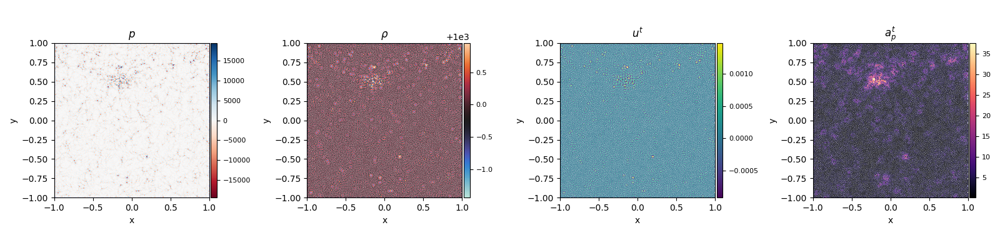

In [252]:
fig, axis = plt.subplots(1,4, figsize = (16,4), squeeze = False)


visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'pressure',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'densities',
                                      mapping = '.x', s = s, 
                          scaling = 'RdBu', gridVisualization=False, cmap = 'icefire', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 1000)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      B ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$u^t$', plotBoth = False, which = 'fluid', midPoint = 0)

accelPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      a_p ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'magma', streamLines = True, operation = None, title = '$a_p^t$', plotBoth = False, which = 'fluid', midPoint = 0)


fig.tight_layout()

In [181]:

residuals = []
A_sp = sp.coo_matrix((A[0].cpu().detach().to(torch.float64).numpy(), (A[1][0].cpu().detach().numpy(), A[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
M_sp = sp.coo_matrix((M[0].cpu().detach().to(torch.float64).numpy(), (M[1][0].cpu().detach().numpy(), M[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
rhs = B.cpu().detach().to(torch.float64).numpy()


# M = scipy.sparse.linalg.spilu(A_sp, drop_tol=1e-3)
# lo = scipy.sparse.linalg.LinearOperator(A_sp.shape, lambda x: M.solve(x))

# print(B.is_contiguous())
# print(A[0].is_contiguous())

p, iters, convergence_torch  = cg_sparse(A, B.cpu().to(torch.float64), torch.zeros_like(B.cpu()).to(torch.float64), rtol = 1e-4, maxiter = 512)
p = (p - p.mean()).to(torch.float32).to(solverState['fluid']['positions'].device)
print(f'Torch CG: {iters} iterations, {convergence_torch[-1][1]} residual, {p.max()} | {p.min()} | {p.mean()}')



# convergence = []
# xs = []
convergence = []
# p = scipy.sparse.linalg.bicgstab(A_sp, rhs, callback=lambda x: convergence.append([x.copy(), np.linalg.norm(A_sp.dot(x) - rhs)]), maxiter = 512, rtol = 1e-8, M = lo)
# p = scipy.sparse.linalg.cg(A_sp, rhs, callback=lambda x: convergence.append([x.copy(), np.linalg.norm(A_sp.dot(x) - rhs)]), maxiter = 512, rtol = 1e-4, M = lo)
p = scipy.sparse.linalg.cg(A_sp, rhs, callback=lambda x: convergence.append([x.copy(), np.linalg.norm(A_sp.dot(x) - rhs)]), maxiter = 512, rtol = 1e-4)
# display(A_sp)
# display(rhs)
# p = scipy.sparse.linalg.cg(A_sp, rhs)

# print(p)
p = torch.tensor(p[0] - p[0].mean(), device = solverState['fluid']['positions'].device, dtype = torch.float32)
print(f'SciPy CG: {iters} iterations, {convergence[-1][1]} residual, {p.max()} | {p.min()} | {p.mean()}')



Torch CG: 512 iterations, 0.1411032225269263 residual, 227125.328125 | -126272.171875 | -1.9073486328125e-06
SciPy CG: 512 iterations, 6.66297509960865e-06 residual, 906790.875 | -5014947.5 | -0.00048828125


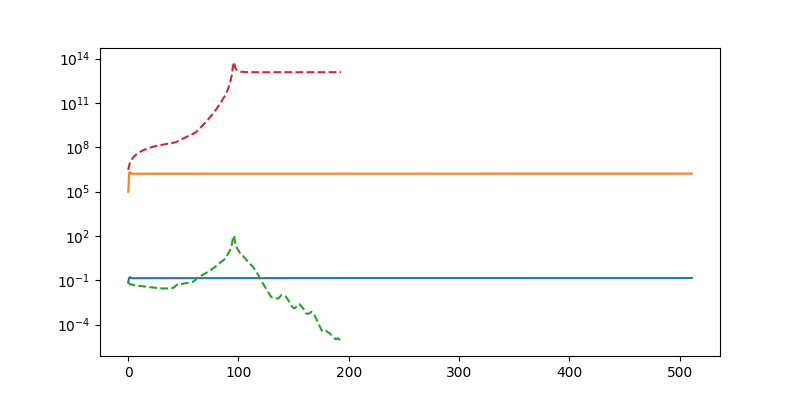

In [182]:

fig, axis = plt.subplots(1,1, figsize = (8,4), squeeze = False)

axis[0,0].semilogy([c[1].detach().cpu().numpy() for c in convergence_torch])
axis[0,0].semilogy([np.linalg.norm(c[0].detach().cpu().numpy()) for c in convergence_torch])

axis[0,0].semilogy([c[1] for c in convergence], ls = '--')
axis[0,0].semilogy([np.linalg.norm(c[0]) for c in convergence], ls = '--')


In [939]:
A_sp = sp.coo_matrix((A[0].cpu().detach().numpy(), (A[1][0].cpu().detach().numpy(), A[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
M_sp = sp.coo_matrix((M[0].cpu().detach().numpy(), (M[1][0].cpu().detach().numpy(), M[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
rhs = B.cpu().detach().numpy()


display(A_sp)
display(M_sp)

<16384x16384 sparse matrix of type '<class 'numpy.float32'>'
	with 973230 stored elements in COOrdinate format>

<16384x16384 sparse matrix of type '<class 'numpy.float32'>'
	with 16384 stored elements in COOrdinate format>

In [940]:
B.shape

torch.Size([16384])

In [941]:
bicg = []
bicgstab = []

def callback(x):
    bicg.append(np.linalg.norm(A_sp.dot(x) - rhs))

sol2_nostab = scipy.sparse.linalg.bicg(A_sp, rhs, callback=callback, maxiter = 512)

def callback(x):
    bicgstab.append(np.linalg.norm(A_sp.dot(x) - rhs))
sol2_nostab = scipy.sparse.linalg.bicgstab(A_sp, rhs, callback=callback, maxiter = 512)

# bicg_stab_no_prec = []
# bicg_stab_prec = []

# def callback(x):
#     bicg_stab_prec.append(np.linalg.norm(lp2.dot(x) - rhs))

# sol2_nostab = scipy.sparse.linalg.bicgstab(lp2, rhs, callback=callback, M=D)
# def callback(x):
#     bicg_stab_no_prec.append(np.linalg.norm(lp2.dot(x) - rhs))

# sol2_nostab = scipy.sparse.linalg.bicgstab(lp2, rhs, callback=callback)

# gmres = []
# # gmres_no_prec = []

# def callback(r):
#     gmres_prec.append(r)
# sol = scipy.sparse.linalg.gmres(A_sp, rhs, callback=callback, restart=50)

# def callback(r):
#     gmres_no_prec.append(r)
# sol = scipy.sparse.linalg.gmres(lp2, rhs, callback=callback, restart=50)

In [942]:
    residuals = []
    A_sp = sp.coo_matrix((A[0].cpu().detach().numpy(), (A[1][0].cpu().detach().numpy(), A[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
    # M_sp = sp.coo_matrix((M[0].cpu().detach().numpy(), (M[1][0].cpu().detach().numpy(), M[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
    rhs = B.cpu().detach().numpy()
    # p, iters, convergence1  = cg_sparse(A, B, torch.zeros_like(B), rtol = 1e-10, tol = 1e-8, maxiter = 256)

    convergence = []

    p = scipy.sparse.linalg.cg(A_sp, rhs, callback=lambda x: convergence.append(np.linalg.norm(A_sp.dot(x) - rhs)), maxiter = 512)
    # display(A_sp)
    # display(rhs)
    # p = scipy.sparse.linalg.cg(A_sp, rhs)

In [943]:

cg = []
def callback(x):
    cg.append(np.linalg.norm(A_sp.dot(x) - rhs))

sol2_nostab = scipy.sparse.linalg.cg(A_sp, rhs, callback=callback, maxiter = 512)

print(cg)

[34909.62, 33194.56, 65365.58, 101414.49, 80791.91, 45341.93, 29941.41, 26942.174, 31566.531, 39042.094, 38029.457, 29946.732, 24476.578, 23727.705, 25930.828, 27905.846, 27211.03, 25492.96, 25484.771, 26933.68, 27776.383, 27116.115, 26455.98, 27420.998, 29942.896, 31209.984, 29541.143, 26992.408, 26986.04, 30910.42, 37737.523, 44322.133, 47968.31, 50254.48, 54323.473, 61575.766, 71090.87, 82417.28, 96593.56, 116761.266, 138612.36, 153412.92, 164039.8, 166094.06, 151421.73, 154897.34, 167988.58, 179009.75, 188956.66, 193460.39, 199211.08, 196474.78, 184406.12, 175155.83, 174642.4, 196178.77, 227056.78, 252020.27, 259672.94, 250306.45, 255234.83, 286663.97, 309867.4, 315318.56, 349139.0, 394931.0, 458703.97, 542669.6, 610197.8, 696165.0, 772006.9, 880260.25, 1005510.2, 1163535.0, 1325164.9, 1523643.9, 1794962.1, 2116209.5, 2545276.2, 3068091.8, 3726899.0, 4614673.0, 5855398.0, 7723204.5, 10539275.0, 14949967.0, 22191272.0, 39589664.0, 123353880.0, 92614370.0, 363995800.0, 112619450.0, 1

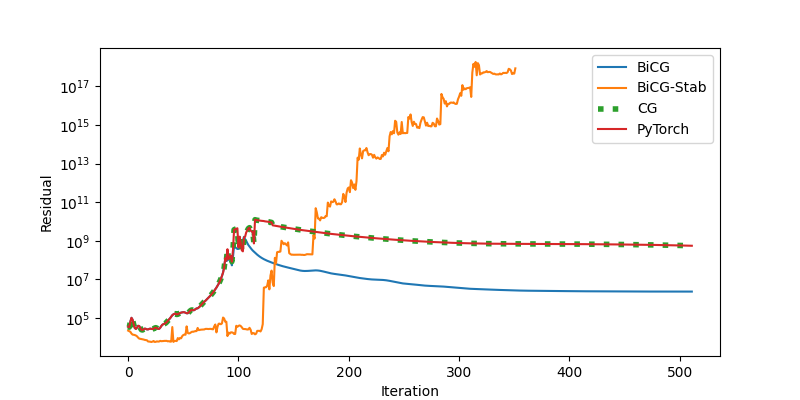

In [944]:
fig, axis = plt.subplots(1,1, figsize = (8,4), squeeze = False)

# axis[0,0].semilogy([c.detach().cpu().numpy() for c in convergence])
axis[0,0].semilogy(bicg, label = 'BiCG')
axis[0,0].semilogy(bicgstab, label = 'BiCG-Stab')
# axis[0,0].semilogy(gmres, label = 'GMRES')
axis[0,0].semilogy(cg, label = 'CG', ls = ':', lw = 4)

# axis[0,0].semilogy([c.detach().cpu().numpy() for c in convergence], label = 'PyTorch')
axis[0,0].semilogy([c for c in convergence], label = 'PyTorch')


axis[0,0].set_xlabel('Iteration')
axis[0,0].set_ylabel('Residual')

axis[0,0].legend()



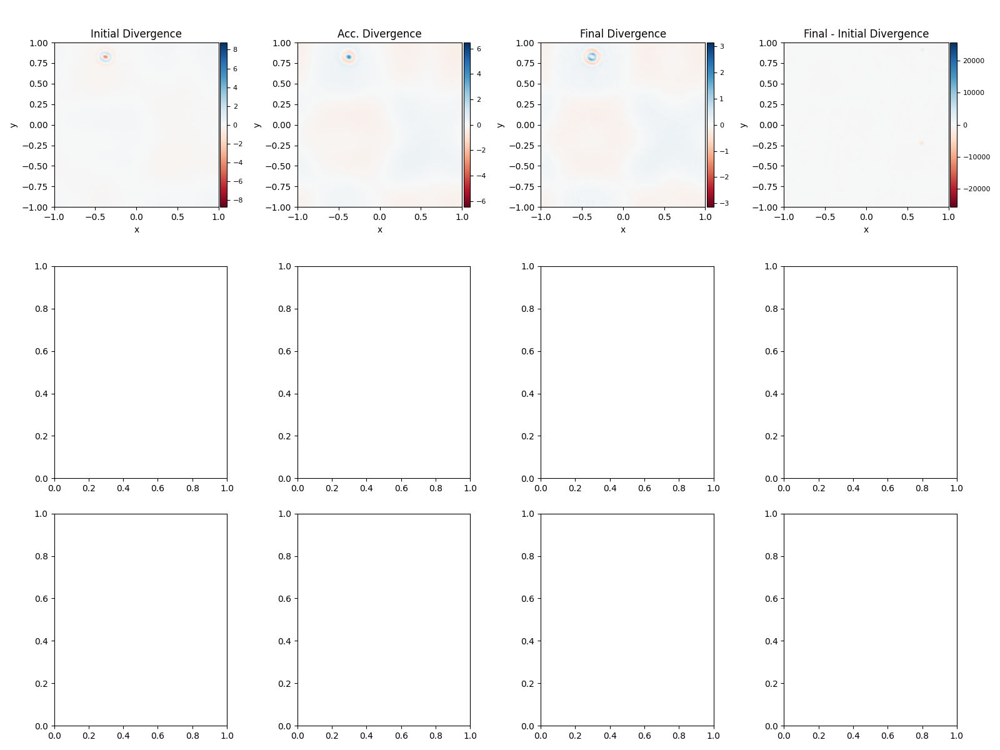

In [945]:
fig, axis = plt.subplots(3,4, figsize = (16,12), squeeze = False)
visualizationState = prepVisualizationState(solverState, config, grid = True)
b = solverState['fluid']['advectionDivergence'] / solverState['dt']
# residualPlot_00 = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
#                                     b, mapping = '.x', s = s, 
#                         scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Iteration {i}', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
# print(f'Iteration {i} mean residual: {residuals[i].mean()}, min: {residuals[i].min()}, max: {residuals[i].max()}')


for i, (ax, r) in enumerate(zip(axis.flatten()[4:], residuals if len(residuals) < 8 else residuals[-8:])):
    residualPlot_00 = visualizeParticleQuantity(fig, ax, config, visualizationState, quantity =
                                      r - b, mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu', title = f'Iteration {i}', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
    print(f'Iteration {i} mean residual: {(r-b).mean()}, min: {(r - b).min()}, max: {(r - b ).max()}')

residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[0], config, visualizationState, quantity =
                                    initDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Initial Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[1], config, visualizationState, quantity =
                                    accDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Acc. Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[2], config, visualizationState, quantity =
                                    finalDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Final Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[3], config, visualizationState, quantity =
                                    finalDiv/initDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Final - Initial Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)


fig.tight_layout()

In [946]:
finalDiv/accDiv

tensor([ 2.6700, -1.3211,  1.8736,  ...,  2.4875,  0.6518, -1.0003],
       device='cuda:0')

In [947]:
solverState = copy.deepcopy(initialState)

# solverState['fluid']['velocities'][:,0] = torch.sin(solverState['fluid']['positions'][:,1] * 2 * np.pi)
# solverState['fluid']['velocities'][:,1] = 0
solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])


In [273]:
solverState['fluid'].keys()

dict_keys(['positions', 'areas', 'densities', 'numParticles', 'velocities', 'masses', 'supports', 'datastructure', 'neighborhood', 'numNeighbors', 'velocityDiffusion', 'gravityAccel', 'advection', 'predictedAcceleration', 'predictedVelocities', 'actualArea', 'sourceTerm', 'pressureB', 'pressureA', 'alpha', 'pressureAccel', 'residual', 'convergence_density', 'accelerations', 'advectionVelocities', 'velocityDivergence', 'advectionDivergence', 'pressure'])

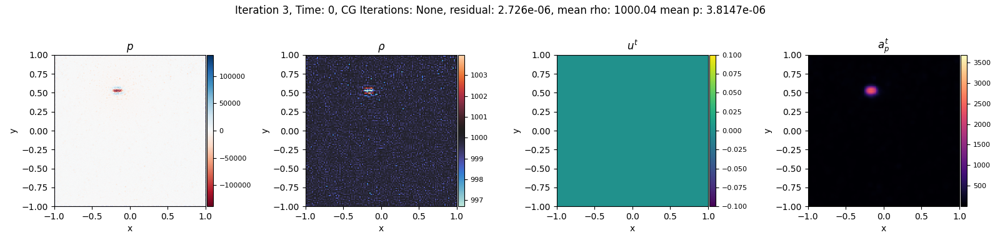

In [296]:
fig, axis = plt.subplots(1,4, figsize = (16,4), squeeze = False)


visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'pressure',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'densities',
                                      mapping = '.x', s = s, 
                          scaling = 'RdBu', gridVisualization=True, cmap = 'icefire', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 1000)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'velocities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'viridis', streamLines = False, operation = None, title = '$u^t$', plotBoth = False, which = 'fluid', midPoint = 0)

accelPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      a_p,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'magma', streamLines = False, operation = None, title = '$a_p^t$', plotBoth = False, which = 'fluid', midPoint = 0)

fig.suptitle(f'Iteration {i}, Time: {solverState["time"]:.4g}, CG Iterations: {iters}, residual: {convergence[-1][-1]:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}')
        

fig.tight_layout()

In [297]:
solverState = copy.deepcopy(initialState)
# solverState['fluid']['velocities'][:,0] = 0
# solverState['fluid']['velocities'][:,0] = torch.sin(solverState['fluid']['positions'][:,1] * 2 * np.pi)
# solverState['fluid']['velocities'][:,1] = 0
# solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])


solverState['dt'] = 1e-4
config['timestep']['dt'] = solverState['dt']

for i in tqdm(range(4096)):
    solverState['time'] += perennialState['dt']
    solverState['timestep'] += 1

    searchNeighbors(solverState, config)

    solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    # solverState['fluid']['advection'][:,0] += torch.sin(2 * np.pi * solverState['fluid']['positions'][:,1]) * solverState['dt']

    
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    solverState['fluid']['advectionDivergence'] = computeAdvectionDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


    solverState['fluid']['pressure'], iters, convergence, residuals, A, B, M = solveISPH(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])

    # solverState['fluid']['pressure'] = - solverState['fluid']['pressure']

    a_p = -sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['pressure'], solverState['fluid']['pressure']), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) / solverState['fluid']['densities'].view(-1,1)

    finalVelocities = solverState['fluid']['advectionVelocities']  + a_p* solverState['dt']
    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')


    stateA = solverState['fluid']
    stateB = solverState['fluid']
    neighborhood = stateA['neighborhood']

    initDiv = sphOperationStates(stateA, stateB, (stateA['velocities'], stateB['velocities']), neighborhood=neighborhood, operation='divergence')
    advDiv = sphOperationStates(stateA, stateB, (stateA['advectionVelocities'], stateB['advectionVelocities']), neighborhood=neighborhood, operation='divergence')
    accDiv = sphOperationStates(stateA, stateB, (solverState['dt'] * a_p, solverState['dt'] * a_p), neighborhood=neighborhood, operation='divergence')
    finalDiv = sphOperationStates(stateA, stateB, (finalVelocities, finalVelocities), neighborhood=neighborhood, operation='divergence')


    solverState['fluid']['velocities'] = finalVelocities
    solverState['fluid']['positions'] += finalVelocities * solverState['dt']# + a_p* solverState['dt'] * solverState['dt']
    div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)



    print(f'Iteration: {i}, Divergence: {div.min()} | {div.max()}, Pressure: {solverState["fluid"]["pressure"].min()} | {solverState["fluid"]["pressure"].max()}, densities: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()}')

    # print(f'Initial Divergence:   {initDiv.min()} | {initDiv.max()} | {initDiv.mean()} | {initDiv}')
    print(f'Advection Divergence: {advDiv.min()} | {advDiv.max()} | {advDiv.mean()} | {advDiv}')
    print(f'Accel Divergence:     {accDiv.min()} | {accDiv.max()} | {accDiv.mean()} | {accDiv}')
    # print(f'Final Divergence:     {finalDiv.min()} | {finalDiv.max()} | {finalDiv.mean()} | {finalDiv}')
    # print(f'Residual:             {(advDiv - accDiv).min()} | {(advDiv - accDiv).max()} | {(advDiv - accDiv).mean()} | {(advDiv - accDiv)}')

    if i % 16 == 0:
        searchNeighbors(solverState, config)
        visualizationState = prepVisualizationState(solverState, config, grid = True)
        # visualizationState = prepVisualizationState(perennialState, config)
        # div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
        
        # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(pressurePlot, visualizationState, 'pressure')
        updatePlot(rhoPlot, visualizationState, 'densities')
        updatePlot(velPlot, visualizationState, 'velocities')
        updatePlot(accelPlot, visualizationState, a_p)
        
        fig.suptitle(f'Iteration {i}, Time: {solverState["time"]:.4g}, CG Iterations: {iters}, residual: {convergence[-1][-1]:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}')
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        # exportPlot(solverState, config, fig)

  0%|          | 0/4096 [00:00<?, ?it/s]

Divergence-Free Source Term: 7883.484375 | 0.006217761896550655 | 0.00041985511779785156
Incompressible Source Term: 0.01810492016375065 | 6.103515914901436e-08 | -3.786825982388109e-05
tensor(-3.7868e-05, device='cuda:0')
Current Density: 1000.4196166992188 | 981.8994140625 | 1000.037841796875
Advection Density: 1000.4247436523438 | 981.8950805664062 | 1000.037841796875
Torch CG: 92 iterations, 6.3501223726538356e-06 residual, 912569.6875 | -5008933.5 | -0.000732421875
Iteration: 0, Divergence: -107.2194595336914 | 1.1421856880187988, Pressure: -5008933.5 | 912569.6875, densities: 981.8994140625 | 1000.4196166992188
Advection Divergence: -0.7883484363555908 | 0.7264362573623657 | 5.702895577996969e-08 | tensor([ 0.0445,  0.2149, -0.1799,  ..., -0.1206, -0.1014, -0.0416],
       device='cuda:0')
Accel Divergence:     -107.26360321044922 | 0.8967551589012146 | 0.0017438586801290512 | tensor([ 0.5545, -0.3630,  0.4943,  ...,  0.7691, -0.4655,  0.5970],
       device='cuda:0')
Divergence-

RuntimeError: shape mismatch: value tensor of shape [16384] cannot be broadcast to indexing result of shape [0]

  0%|          | 0/256 [00:00<?, ?it/s]

[0.1583489626646042, 0.07733796536922455, 0.052843622863292694, 0.04024842008948326, 0.03235901892185211, 0.026884004473686218, 0.02276621013879776, 0.01958506740629673, 0.017193052917718887, 0.01533567439764738, 0.013764981180429459, 0.012241830118000507, 0.010959604755043983, 0.009750910103321075, 0.008801978081464767, 0.008092448115348816, 0.007503774017095566, 0.00699051795527339, 0.006362928077578545, 0.005470598116517067, 0.005397814325988293, 0.004585231188684702, 0.004335539415478706, 0.003939945250749588, 0.026406535878777504, 0.003462046617642045, 0.003168828086927533, 0.003111028578132391, 0.0030905224848538637, 0.002684845821931958, 0.0024267639964818954, 0.0025631713215261698, 0.0024949756916612387, 0.0018495729891583323, 0.0017644591862335801, 0.0011260759783908725, 0.0014113852521404624, 0.0013523445231840014, 0.0010464346269145608, 0.001120393630117178, 0.0010509752901270986, 0.0009478653664700687, 0.0008552554063498974, 0.0008296513697132468, 0.0007834323332644999, 0.0

RuntimeError: shape mismatch: value tensor of shape [16384] cannot be broadcast to indexing result of shape [3903]

In [ ]:
priorState = None
for i in tqdm(range(4096)):
    if 'shiftAmount' in perennialState['fluid']:
        del perennialState['fluid']['shiftAmount']
    perennialState, priorState, *updates = integrate(simulationStep, perennialState, config, previousStep= priorState)
    # dx, _ = solveShifting(perennialState, config)
    # numNeighbors = perennialState['fluid']['neighborhood']['numNeighbors']
    # perennialState['fluid']['shiftAmount'] = dx
    # perennialState['fluid']['positions'][numNeighbors > 5] += dx[numNeighbors > 5]
    # if config['compute']['checkNaN']:
    #     checkNaN(perennialState['fluid']['positions'], 'positions')
    #     checkNaN(perennialState['fluid']['shiftAmount'], 'shiftAmount')
    perennialState['time'] += perennialState['dt']
    perennialState['timestep'] += 1
    # print(f'Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}')

    if i % 128 == 0:
        searchNeighbors(perennialState, config)
        visualizationState = prepVisualizationState(perennialState, config)
        div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
        
        # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(indexPlot, visualizationState, 'velocities')
        updatePlot(quantPlot, visualizationState, 'pressureIncompressible')
        updatePlot(l2Plot, visualizationState, div)
        
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(perennialState, config, fig)


        
        E_k0 =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()
        E_k = (0.5 * torch.sum(perennialState['fluid']['areas'] * perennialState['fluid']['densities'] * torch.linalg.norm(perennialState['fluid']['velocities'], dim = 1)**2)).sum().detach().cpu().numpy()
        nu_total = np.log(E_k / E_k0) / (-4 *  perennialState['time'] * k**2 )
        Re = u_mag * 2 / nu_total


        fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.4g}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]:.2e}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum():.2f}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$, Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}\n E_k0: {E_k0:.2f}, E_k: {E_k:.2f}, $\\nu = {nu_total:.2e}$, $Re = {Re:.4g}$')
        # fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.2f}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum()}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$')

        
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(perennialState, config, fig)



In [ ]:
def computeFinalDivergence(stateA, stateB, neighborhood, simConfig):
    with record_function("[SPH] - Fluid Divergence ($nabla cdot \\bar{v}$)"):
        divergence = sphOperationStates(stateA, stateB, (stateA['finalVelocities'], stateB['finalVelocities']), neighborhood=neighborhood, operation='divergence')
        return divergence
    


print(f'Initial Divergence: {solverState["fluid"]["velocityDivergence"].abs().max()}, mean: {solverState["fluid"]["velocityDivergence"].abs().mean()}')
# div = computeFinalDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)

Initial Divergence: 1.1614457368850708, mean: 0.46628260612487793


In [ ]:
from diffSPH.v2.simulationSchemes.dfsph import callModule, computeDensity, computeGravity, computeViscosity, sphOperationStates, scatter_sum
solverState = copy.deepcopy(initialState)

# solverState['fluid']['velocities'][:,0] =  -torch.clamp(1 - (solverState['fluid']['positions'][:,0]**2 + solverState['fluid']['positions'][:,1]**2), min = 0) * 10
# solverState['fluid']['velocities'][:,1] =  -torch.clamp(1 - (solverState['fluid']['positions'][:,0]**2 + solverState['fluid']['positions'][:,1]**2), min = 0) * 10
searchNeighbors(solverState, config)
solverState['dt'] = 0.01
config['timestep']['dt'] = 0.01

for i in range(32):
    
    solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    solverState['fluid']['advectionDivergence'] = computeAdvectionDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


    p, iters, convergence = solveISPH(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])

    a_p = -sphOperationStates(solverState['fluid'], solverState['fluid'], (p, p), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) / solverState['fluid']['densities'].view(-1,1)
    finalVelocities = solverState['fluid']['advectionVelocities'] + a_p * solverState['dt']
    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

    solverState['fluid']['velocities'] = finalVelocities


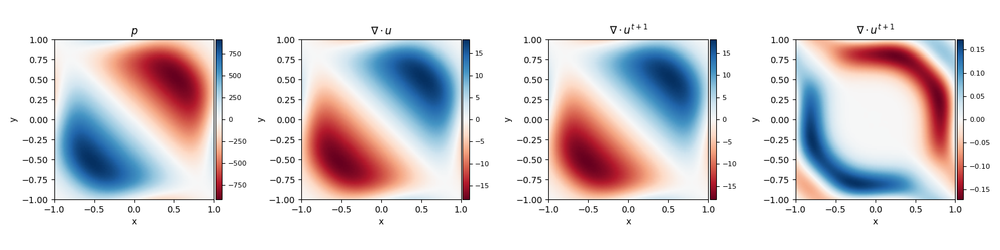

In [ ]:
solverState['pressures'] = torch.zeros_like(solverState['fluid']['densities'])

In [ ]:
stateA = solverState['fluid']
stateB = solverState['fluid']
neighborhood = stateA['neighborhood']

i,j = neighborhood['indices']
rij = neighborhood['distances']
hij = neighborhood['supports']
xij = neighborhood['vectors']
gradKernels = neighborhood['gradients']
pA = stateA['pressures']
pB = stateB['pressures']

quotient = (rij * hij + 1e-7 * hij)
kernelApproximation = torch.linalg.norm(gradKernels, dim = -1) /  quotient
kernelApproximation = torch.einsum('nd, nd -> n', gradKernels, -xij)/  quotient# * rij * hij

In [ ]:
Aij = pA[i] - pB[j]
massTerm = stateA['masses'][j] / (stateA['densities'][i] + stateB['densities'][j])
dimTerm = config['domain']['dim'] * 2 + 2

laplacianTerm = dimTerm * massTerm * kernelApproximation

aii = scatter_sum(laplacianTerm, i, dim = 0, dim_size = stateA['positions'].shape[0])

mask = i == j

A = laplacianTerm
A[mask] = aii

B = solverState['fluid']['advectionDivergence'] / solverState['dt']**3

A = (laplacianTerm, (i,j), stateA['numParticles'])

In [ ]:
p, iters, convergence = bicg(A, -B, torch.zeros_like(B), rtol = 1e-10, tol = 1e-8, maxiter = 512)

print(iters, convergence)

p, iters, convergence = bicg(A, -B, p, rtol = 1e-10, tol = 1e-8, maxiter = 512)

Iter 0, Residual: 1567563648.0
Iter 1, Residual: 32864440.0
Iter 2, Residual: 5100007.5
Iter 3, Residual: 977547.5625
Iter 4, Residual: 199048.65625
Iter 5, Residual: 41491.64453125
Iter 6, Residual: 8738.3974609375
Iter 7, Residual: 1852.215576171875
Iter 8, Residual: 394.5318298339844
Iter 9, Residual: 84.29361724853516
Iter 10, Residual: 18.063350677490234
Iter 11, Residual: 3.887315511703491
Iter 12, Residual: 0.8368783593177795
Iter 13, Residual: 0.18033309280872345
14 [tensor(32864442., device='cuda:0'), tensor(5100006., device='cuda:0'), tensor(977554.1875, device='cuda:0'), tensor(199046.0469, device='cuda:0'), tensor(41495.4102, device='cuda:0'), tensor(8747.5312, device='cuda:0'), tensor(1882.0022, device='cuda:0'), tensor(541.1484, device='cuda:0'), tensor(366.3199, device='cuda:0'), tensor(358.9917, device='cuda:0'), tensor(358.6536, device='cuda:0'), tensor(359.9285, device='cuda:0'), tensor(361.6763, device='cuda:0'), tensor(361.5761, device='cuda:0')]
Iter 0, Residual: 3

In [ ]:

# p, convergence, iters, residual = BiCGStab_wJacobi(A, B, torch.zeros_like(B), i, j)

# print(f'Iterations: {iters}, Residual: {residual}, {convergence}')
# print(f'p: {p}, min: {p.min()}, max: {p.max()}, mean: {p.mean()}')

In [ ]:
a_p = -sphOperationStates(stateA, stateB, (p, p), operation = 'gradient', gradientMode='symmetric', neighborhood= neighborhood) / stateA['densities'].view(-1,1)
finalVelocities = stateA['advectionVelocities'] + a_p * solverState['dt']
finalDivergence = sphOperationStates(stateA, stateB, (finalVelocities, finalVelocities), neighborhood=neighborhood, operation='divergence')



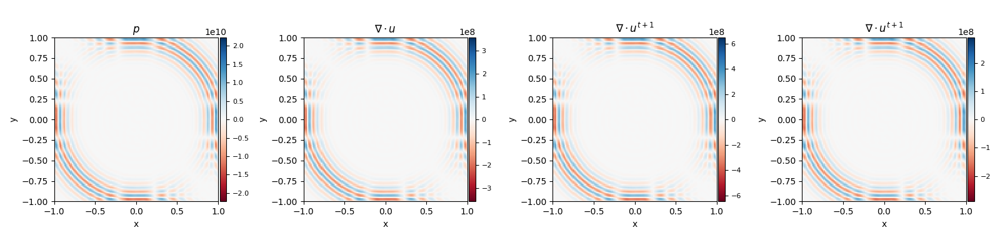

In [ ]:
from diffSPH.v2.plotting import prepVisualizationState, visualizeParticleQuantity
from diffSPH.v2.plotting import exportPlot, postProcessPlot
fig, axis = plt.subplots(1,4, figsize = (16,4), squeeze = False)

visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25

xVelPlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      p,
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
yVelPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'velocityDivergence',
                                      mapping = '.y', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = '$\\nabla \\cdot u$', plotBoth = False, which = 'fluid', midPoint = 0)

velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      finalDivergence,
                                      mapping = 'L2', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = '$\\nabla \\cdot u^{t+1}$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      finalDivergence - solverState['fluid']['velocityDivergence'],
                                      mapping = 'L2', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = '$\\nabla \\cdot u^{t+1}$', plotBoth = False, which = 'fluid', midPoint = 0)



fig.tight_layout()

# simulationState['fluid']['actualArea'] = simulationState['fluid']['masses'] / simulationState['fluid']['densities']
# 



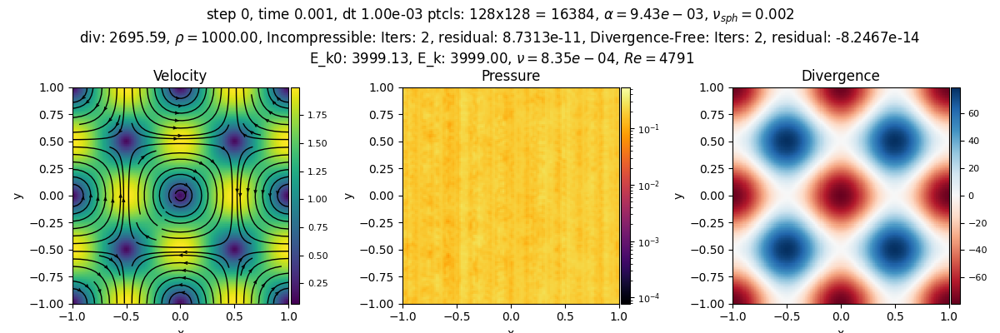

In [ ]:
from diffSPH.v2.plotting import prepVisualizationState, visualizeParticleQuantity
from diffSPH.v2.plotting import exportPlot, postProcessPlot
fig, axis = plt.subplots(1,3, figsize = (12,4), squeeze = False)

visualizationState = prepVisualizationState(perennialState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25

indexPlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'viridis', title = 'Velocity', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = True)
quantPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'pressureIncompressible',
                                      mapping = '.y', s = s, 
                          scaling = 'log', gridVisualization=True, cmap = 'inferno', streamLines = False, operation = None, title = 'Pressure', plotBoth = False, which = 'fluid', midPoint = 1000)

l2Plot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      div,
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = 'Divergence', plotBoth = False, which = 'fluid', midPoint = 0)

E_k0 =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()
E_k = (0.5 * torch.sum(perennialState['fluid']['areas'] * perennialState['fluid']['densities'] * torch.linalg.norm(perennialState['fluid']['velocities'], dim = 1)**2)).sum().detach().cpu().numpy()
nu_total = np.log(E_k / E_k0) / (-4 *  perennialState['time'] * k**2 )
Re = u_mag * 2 / nu_total

fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.4g}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]:.2e}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum():.2f}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$, Incompressible: Iters: {len(priorState["fluid"]["convergence_density"])}, residual: {priorState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(priorState["fluid"]["convergence_divergence"])}, residual: {priorState["fluid"]["convergence_divergence"][-1]:.4e}\n E_k0: {E_k0:.2f}, E_k: {E_k:.2f}, $\\nu = {nu_total:.2e}$, $Re = {Re:.4g}$')

fig.tight_layout()

# simulationState['fluid']['actualArea'] = simulationState['fluid']['masses'] / simulationState['fluid']['densities']
# 



In [ ]:
priorState = None
for i in tqdm(range(4096)):
    if 'shiftAmount' in perennialState['fluid']:
        del perennialState['fluid']['shiftAmount']
    perennialState, priorState, *updates = integrate(simulationStep, perennialState, config, previousStep= priorState)
    # dx, _ = solveShifting(perennialState, config)
    # numNeighbors = perennialState['fluid']['neighborhood']['numNeighbors']
    # perennialState['fluid']['shiftAmount'] = dx
    # perennialState['fluid']['positions'][numNeighbors > 5] += dx[numNeighbors > 5]
    # if config['compute']['checkNaN']:
    #     checkNaN(perennialState['fluid']['positions'], 'positions')
    #     checkNaN(perennialState['fluid']['shiftAmount'], 'shiftAmount')
    perennialState['time'] += perennialState['dt']
    perennialState['timestep'] += 1
    # print(f'Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}')

    if i % 128 == 0:
        searchNeighbors(perennialState, config)
        visualizationState = prepVisualizationState(perennialState, config)
        div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
        
        # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(indexPlot, visualizationState, 'velocities')
        updatePlot(quantPlot, visualizationState, 'pressureIncompressible')
        updatePlot(l2Plot, visualizationState, div)
        
        
        E_k0 =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()
        E_k = (0.5 * torch.sum(perennialState['fluid']['areas'] * perennialState['fluid']['densities'] * torch.linalg.norm(perennialState['fluid']['velocities'], dim = 1)**2)).sum().detach().cpu().numpy()
        nu_total = np.log(E_k / E_k0) / (-4 *  perennialState['time'] * k**2 )
        Re = u_mag * 2 / nu_total


        fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.4g}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]:.2e}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum():.2f}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$, Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}\n E_k0: {E_k0:.2f}, E_k: {E_k:.2f}, $\\nu = {nu_total:.2e}$, $Re = {Re:.4g}$')
        # fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.2f}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum()}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$')

        
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(perennialState, config, fig)



  0%|          | 0/4096 [00:00<?, ?it/s]

In [383]:

import subprocess
import shlex

outFile = config['plot']['namingScheme'] if config['plot']['namingScheme'] != 'timestep' else config["simulation"]["timestamp"]
if config['plot']['namingScheme'] == 'timestep':
    outFolder = f'{config["plot"]["exportPath"]}/{config["simulation"]["timestamp"]}/'
else:
    outFolder = f'{config["plot"]["exportPath"]}/{config["plot"]["namingScheme"]}/'

os.makedirs(outFolder, exist_ok = True)
# print('Creating video from  frames (frame count: {})'.format(len(os.listdir(outFolder))))
command = '/usr/bin/ffmpeg -loglevel warning -y -framerate 30 -f image2 -pattern_type glob -i '+ outFolder + '*.png -c:v libx264 -b:v 20M -r ' + str(config['plot']['exportFPS']) + ' ' + outFolder + 'output.mp4'
commandB = f'ffmpeg -loglevel warning -hide_banner -y -i {outFolder}output.mp4 -vf "fps={config["plot"]["exportFPS"]},scale={config["plot"]["gifScale"]}:-1:flags=lanczos,palettegen" output/palette.png'
commandC = f'ffmpeg -loglevel warning -hide_banner -y -i {outFolder}output.mp4 -i output/palette.png -filter_complex "fps={config["plot"]["exportFPS"]},scale={config["plot"]["gifScale"]}:-1:flags=lanczos[x];[x][1:v]paletteuse" {outFile}.gif'

subprocess.run(shlex.split(command))
subprocess.run(shlex.split(commandB))
subprocess.run(shlex.split(commandC))

CompletedProcess(args=['ffmpeg', '-loglevel', 'warning', '-hide_banner', '-y', '-i', 'output/2024_07_12-11_16_40/output.mp4', '-i', 'output/palette.png', '-filter_complex', 'fps=30,scale=640:-1:flags=lanczos[x];[x][1:v]paletteuse', '2024_07_12-11_16_40.gif'], returncode=0)